## getting ready

In [77]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
from datetime import datetime
import statistics 
import math
import folium
from geopy.geocoders import ArcGIS
from st_dbscan import ST_DBSCAN
import geopy.distance
import statsmodels.api as sm
import seaborn as sns

# import model and matrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, RepeatedStratifiedKFold, StratifiedKFold
from sklearn.metrics import accuracy_score, confusion_matrix,roc_curve, roc_auc_score, precision_score, recall_score, precision_recall_curve
from sklearn.metrics import f1_score

# packages utiles
from sklearn import svm
import sklearn.metrics
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score


In [2]:
df_fix = pd.read_csv("C:/Users/t480/Desktop/University courses/ENSAE 2A/GROUPE STATAPP/Statapp-Hail-storm/bdd.csv")
df_fix_maxhail = pd.read_csv("C:/Users/t480/Desktop/University courses/ENSAE 2A/GROUPE STATAPP/Statapp-Hail-storm/bdd_maxhaildiameter.csv")

In [3]:
def convert_time_to_timestamps(df):
    df['TIME_EVENT'] = pd.to_datetime(df['TIME_EVENT'],format = '%Y-%m-%d %H:%M:%S')
    df['TIME_EVENT'] = df.TIME_EVENT.values.astype(np.float64) # in nanoseconds
    df.TIME_EVENT = df.TIME_EVENT / (10 ** 9) # in seconds 
    df.TIME_EVENT = df.TIME_EVENT / 3600 # in hours
    return df

In [4]:
def convert_timestamps_to_date(df):
    new_df = df
    new_df.TIME_EVENT = new_df.TIME_EVENT * (10 ** 9)  
    new_df.TIME_EVENT = new_df.TIME_EVENT * 3600
    new_df.TIME_EVENT = pd.to_datetime(new_df.TIME_EVENT, format='%Y-%m-%d %H:%M:%S')#.dt.time
    return new_df

In [5]:
def getting_ready(df, country, year_since):
    df = convert_time_to_timestamps(df)
    df = df[df['COUNTRY'] == country]
    df = df[df['YEAR'] >= year_since]
    df = df[['TIME_EVENT', 'LATITUDE', 'LONGITUDE']]
    df = df.reset_index(drop=True)
    return df 

In [6]:
def run_dbscan_retrieve_classes(df, spatial_th, time_th, min_sample):
    model = ST_DBSCAN(eps1=spatial_th, eps2=time_th, min_samples=min_sample)
    fit = model.fit(df) 
    labels = pd.DataFrame(model.labels)
    df['LABELS'] = labels
    return df

Visualising the timing of reports with an intensity map 

In [7]:
def visualise_biggest(df, n_biggest):

    nb_reports = pd.DataFrame(df['LABELS'].value_counts()).reset_index()
    nb_reports = nb_reports[nb_reports['index'] != -1].sort_values('LABELS', ascending=False).reset_index()
    labels_biggest_storms = list(nb_reports.iloc[0:n_biggest,1])
    df_biggest = df.loc[df.LABELS.isin(labels_biggest_storms)]

    # plots the n_biggest storms 
    plt.figure(figsize=(10,6))
    for i in range(n_biggest):
        a = df_biggest.LONGITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        b = df_biggest.LATITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        lab = df_biggest.loc[df_biggest.LABELS == labels_biggest_storms[i]]
        plt.scatter(a, b, c='C{}'.format(i), label='{} most reported storm'.format(i+1))
    plt.ylabel('latitude')
    plt.xlabel('longitude')
    plt.legend()
    plt.title("The {} biggest storms in terms of report counts".format(len(labels_biggest_storms)))
    plt.show()

    # plot timing of storms in latlon
    for i in range(n_biggest):
        x = df_biggest.LONGITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        y = df_biggest.LATITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        z = df_biggest.TIME_EVENT[df_biggest.LABELS == labels_biggest_storms[i]]
        z = z - z.iloc[-1]
        x = x.array
        y = y.array
        z = z.array
        axis = plt.subplot(111, title="Storm with {} reports".format(len(x)))
        sc = axis.scatter(x, y, c=z, marker=".")
        plt.colorbar(sc, label="duration of the storm (in hours)")
        plt.show()

        # distance between first and last reports
        df_distance = df_biggest[df_biggest.LABELS==labels_biggest_storms[i]].sort_values('TIME_EVENT')
        df_distance = df_distance.reset_index(drop=True)
        latbegin = df_distance.LATITUDE[0]
        latend = df_distance.LATITUDE[len(df_distance.LATITUDE)-1]
        lonbegin = df_distance.LONGITUDE[0]
        lonend = df_distance.LONGITUDE[len(df_distance.LONGITUDE)-1]
        coords_1 = (latbegin, lonbegin)
        coords_2 = (latend, lonend)
        dist = geopy.distance.geodesic(coords_1, coords_2).km
        print("The storm has length",dist,"km between first report and last report")
        
        # date of first report of storms
        df_date = convert_timestamps_to_date(df_distance)
        date = df_distance.TIME_EVENT[0]
        print("The storm took place on",date)


    return df#, df_biggest 

PREP DEMOG DATA

In [8]:
communes_latlon = pd.read_csv("C:/Users/t480/statappradar/communes-departement-region latlon.csv")
communes_densite = pd.read_excel("C:/Users/t480/statappradar/densite communes.xlsx")
communes_latlon
communes_latlon = communes_latlon[['code_commune_INSEE','nom_commune_complet','latitude','longitude']]
communes_latlon = communes_latlon.dropna()
communes_latlon = communes_latlon[~communes_latlon.code_commune_INSEE.str.startswith('97')]
communes_latlon = communes_latlon[~communes_latlon.code_commune_INSEE.str.startswith('2A')]
communes_latlon = communes_latlon[~communes_latlon.code_commune_INSEE.str.startswith('2B')]
communes_latlon['code_commune_INSEE'] = pd.to_numeric(communes_latlon['code_commune_INSEE'])
#communes_latlon['code_commune_INSEE'] = communes_latlon['code_commune_INSEE'].astype(int)
communes_latlon = communes_latlon.rename(columns = {'nom_commune_complet':'Libellé'})
communes_latlon
type(communes_latlon.iloc[0,0])
communes_densite
communes_densite = communes_densite[~communes_densite.Code.str.startswith('97')]
communes_densite = communes_densite[~communes_densite.Code.str.startswith('2A')]
communes_densite = communes_densite[~communes_densite.Code.str.startswith('2B')]
communes_densite['Code'] = pd.to_numeric(communes_densite['Code'])
communes_densite = communes_densite.rename(columns = {'Code':'code_commune_INSEE'})
communes_densite

dense = pd.read_excel("C:/Users/t480/statappradar/INSEE densite communes float.xlsx")
dense
dense = dense[['codgeo','libgeo','dens_pop']]
dense = dense[~dense.codgeo.str.startswith('97')]
dense = dense[~dense.codgeo.str.startswith('2A')]
dense = dense[~dense.codgeo.str.startswith('2B')]
dense['codgeo'] = pd.to_numeric(dense['codgeo'])
dense = dense.rename(columns = {'codgeo':'code_commune_INSEE'})
dense

communes = pd.merge(communes_latlon, dense,how='inner', on='code_commune_INSEE')
communes = communes.drop(columns=['libgeo'])
communes = communes.rename(columns = {'Libellé':'PLACE'})
communes = communes.drop_duplicates()
#communes['PLACE'].value_counts().head(15)
#communes.loc[communes['PLACE'] == "Livarot-Pays-d'Auge", :]
communes

communes.to_csv("C:/Users/t480/statappradar/communes.csv")
#Preparing data for the logistic regression
data = pd.read_csv("C:/Users/t480/statappradar/eswd_reports_europe_1970_2022.csv")
df=data.drop(['CONTACT','EMAIL', 'ORGANISATION', 'ORGANISATION_ID','CREATOR_ID','REVISOR_ID','PERSON_REVISION','PLACE_LOCAL_LANGUAGE','OROGRAPHY','SURFACE_INITIAL_LOCATION','SURFACE_CROSSED','NO_OBJECTS','EXT_URL','LINK_ORG','LINK_ID','DELETED','F_SCALE','T_SCALE','RATING_BASIS','WIND_SPEED','TEN_MIN_WIND_SPEED','FUNNEL_SIGHTED'  ,'SUCTION_VORTICES' ,'PRECIPITATION_AMOUNT','SNOW_FALL_AMOUNT','PEAK_PRECIP_AMOUNT','PEAK_SNOW_FALL_AMOUNT','PEAK_PRECIP_PERIOD','MAX_6_HOUR_PRECIP','MAX_6_HOUR_SNOW_FALL','MAX_12_HOUR_PRECIP','MAX_12_HOUR_SNOW_FALL','MAX_24_HOUR_PRECIP' ,'MAX_24_HOUR_SNOW_FALL','TYPE_PRECIP','SIZE_ACCOMPANYING_HAIL','POSSIBILITIES','PATH_LENGTH','MEAN_PATH_WIDTH','MAX_PATH_WIDTH','MAX_VERTICAL_DEVELOP','DIRECTION_MOVEMENT','SNOW_HAZARDS','MEAN_HEIGHT_SNOW_CORNICES','MAX_HEIGHT_SNOW_CORNICES','ICE_HAZARDS','THICKNESS_ICE_COVER','THICKNESS_RIME_COVER','AVALANCHE_TYPE','AVALANCHE_FLOW_TYPE','SNOW_MASS_TYPE','AVALANCHE_SIZE','AVALANCHE_TRIGGER','ELEVATION_START','ELEVATION_DIFFERENCE','LIGHTNING_DAMAGE_TO','PEAK_CURRENT','POLARITY','TIME_CREATION','TIME_LAST_REVISION','DETAILED_LOCATION','MAX_HAILSTONE_WEIGHT','CONVECTIVE','PATH_START_LATITUDE','PATH_START_LONGITUDE','PATH_START_DATETIME','PATH_END_LATITUDE','PATH_END_LONGITUDE','PATH_END_DATETIME'],axis=1)

# function allowing us to extract the year from the date of the event
def get_year(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.year
    return dt

# creation of a column containing the year of the event
df['YEAR']=df.apply(lambda donnee: get_year(donnee), axis=1)

# deleting data prior to 2007 
df.drop(df[df.YEAR < 2007].index, inplace=True)

# function allowing us to extract the month from the date of the event
def get_month(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.month
    return dt

# creation of a column containing the month of the event
df['MONTH']=df.apply(lambda donnee: get_month(donnee), axis=1)

# function allowing us to extract the day from the date of the event
def get_day(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.day
    return dt

# creation of a column containing the month of the event
df['DAY']=df.apply(lambda donnee: get_day(donnee), axis=1)

# function allowing us to extract the hour from the date of the event
def get_hour(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.hour
    return dt

# creation of a column containing the month of the event
df['HOUR']=df.apply(lambda donnee: get_hour(donnee), axis=1)

#maintaining only the columns needed for our model
df=df.loc[:,['LATITUDE','LONGITUDE','TIME_EVENT','COUNTRY','PLACE', 'YEAR', 'MAX_HAIL_DIAMETER']]
#df=df.loc[:,['LATITUDE','LONGITUDE','TIME_EVENT','COUNTRY','YEAR', 'MONTH', 'HOUR','PLACE', 'MAX_HAIL_DIAMETER']]

# delete data prior to 2013 
#(radar data provided to us only start from 2013, we wont be able to confront data prior to that year)
df.drop(df[df.YEAR < 2013].index, inplace=True)
df=df.loc[:,['LATITUDE','LONGITUDE','TIME_EVENT','COUNTRY','PLACE', 'MAX_HAIL_DIAMETER']]

# selecting France and converting to timestamps
df = convert_time_to_timestamps(df)
df = df.reset_index(drop=True)
country = 'FR'
df = df[df['COUNTRY'] == country]

# filtering on mainland France
#print(df_mainland_fr.LATITUDE.max(), df_mainland_fr.LATITUDE.min(), df_mainland_fr.LONGITUDE.max(), df_mainland_fr.LONGITUDE.min(),
# communes.latitude.max(), communes.latitude.min(), communes.longitude.max(), communes.longitude.min())
df.drop(df[df.LATITUDE > communes.latitude.max()].index, inplace=True)
df.drop(df[df.LATITUDE < communes.latitude.min()].index, inplace=True)
df.drop(df[df.LONGITUDE > communes.longitude.max()].index, inplace=True)
df.drop(df[df.LONGITUDE < communes.longitude.min()].index, inplace=True)

nom=ArcGIS()
nom.geocode("Monaco") 
#43.73170451200008, 7.424355000000048
df = df.drop(df[(df.LATITUDE < 43.73170451200008) & (df.LONGITUDE > 7.424355000000048)].index)

df_mainland_fr = df 
df_mainland_fr

df_density = communes.loc[:,['dens_pop','PLACE']]
df_mainland_fr = pd.merge(df_mainland_fr, df_density,how='inner', on='PLACE')
print(df_mainland_fr.LATITUDE.max(), df_mainland_fr.LATITUDE.min(), df_mainland_fr.LONGITUDE.max(), df_mainland_fr.LONGITUDE.min(),
 communes.latitude.max(), communes.latitude.min(), communes.longitude.max(), communes.longitude.min())

df_dbscan = df_mainland_fr[['TIME_EVENT', 'LATITUDE', 'LONGITUDE']]
df_dbscan = df_dbscan.reset_index(drop=True)
df_dbscan = run_dbscan_retrieve_classes(df_dbscan, 0.16, 1, 2)
df_mainland_fr['LABEL'] = df_dbscan.loc[:,'LABELS']

dfreg = df_mainland_fr[df_mainland_fr.LABEL > -1]
dfreg = dfreg.drop(columns=['COUNTRY','PLACE'])

dummies = pd.get_dummies(dfreg['LABEL'])
dummies
dfreg = dfreg.join(dummies)

dfreg

C:\Users\t480\AppData\Local\Temp\ipykernel_20060\2626580170.py:42: DtypeWarning: Columns (18,22,23,24,50,51,77,78,79,85,88) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("C:/Users/t480/statappradar/eswd_reports_europe_1970_2022.csv")


51.05 42.433 8.133 -3.95 51.0730436867 42.3559782284 8.18637725776 -5.08534533544


,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,0,1,2,3,...,411,412,413,414,415,416,417,418,419,420
0,45.567,5.933,462946.250000,2.0,2802.91,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,45.567,5.933,452126.750000,2.0,2802.91,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,45.596,5.875,462945.866667,2.0,399.73,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,49.583,1.358,462928.500000,4.5,27.09,2,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,49.583,1.358,462928.500000,4.5,107.41,2,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3230,47.284,2.954,380728.000000,NaN,79.93,419,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3232,47.317,2.967,380728.000000,NaN,27.03,419,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3234,47.983,6.750,379861.250000,2.0,63.15,420,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3235,47.933,6.667,379861.083333,4.0,77.45,420,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


CLUSTERING

In [9]:
df = df_fix.copy()
country = 'FR'
year_since = 2022
df = getting_ready(df, country, year_since)
df

,TIME_EVENT,LATITUDE,LONGITUDE
0,462946.250000,45.567,5.933
1,462945.866667,45.596,5.875
2,462928.500000,49.583,1.358
3,462928.416667,49.533,1.267
4,462928.383333,49.521,1.251
...,...,...,...
1975,458531.666667,43.279,2.460
1976,458514.500000,44.600,-0.933
1977,458174.283333,48.669,5.114
1978,458174.166667,48.636,4.952


In [10]:
#df2 = run_dbscan_retrieve_classes(df, 0.2, 3, 2)
#visualise_biggest(df2,3)

In [11]:
df1 = run_dbscan_retrieve_classes(df, 0.16, 1, 2)
#visualise_biggest(df1,3) 

In [12]:
df_date = convert_timestamps_to_date(df1)
df_date

,TIME_EVENT,LATITUDE,LONGITUDE,LABELS
0,2022-10-24 10:15:00.000000000,45.567,5.933,0
1,2022-10-24 09:51:59.999999744,45.596,5.875,0
2,2022-10-23 16:30:00.000000000,49.583,1.358,1
3,2022-10-23 16:25:00.000000000,49.533,1.267,1
4,2022-10-23 16:23:00.000000256,49.521,1.251,1
...,...,...,...,...
1975,2022-04-23 11:40:00.000000000,43.279,2.460,181
1976,2022-04-22 18:30:00.000000000,44.600,-0.933,-1
1977,2022-04-08 14:17:00.000000000,48.669,5.114,-1
1978,2022-04-08 14:10:00.000000000,48.636,4.952,-1


## tries

In [11]:
df_date

,TIME_EVENT,LATITUDE,LONGITUDE,LABELS
0,2022-10-24 10:15:00.000000000,45.567,5.933,0
1,2022-10-24 09:51:59.999999744,45.596,5.875,0
2,2022-10-23 16:30:00.000000000,49.583,1.358,1
3,2022-10-23 16:25:00.000000000,49.533,1.267,1
4,2022-10-23 16:23:00.000000256,49.521,1.251,1
...,...,...,...,...
1975,2022-04-23 11:40:00.000000000,43.279,2.460,158
1976,2022-04-22 18:30:00.000000000,44.600,-0.933,-1
1977,2022-04-08 14:17:00.000000000,48.669,5.114,159
1978,2022-04-08 14:10:00.000000000,48.636,4.952,159


In [12]:
#varying spatial threshold
#for i in np.arange(0.01,0.3,0.03):
#    visualise_biggest(run_dbscan_retrieve_classes(df, i, 2, 2),3)
#    print("Spatial threshold is",i)



donnees demog

In [13]:
database = pd.read_csv("C:/Users/t480/Desktop/University courses/ENSAE 2A/STATAPP/Statapp-Hail-storm/bdd.csv")

In [14]:
database

,Unnamed: 0,LATITUDE,LONGITUDE,TIME_EVENT,COUNTRY,YEAR
0,0,45.567,5.933,2022-10-24 10:15:00,FR,2022
1,1,45.596,5.875,2022-10-24 09:52:00,FR,2022
2,2,50.967,2.667,2022-10-23 17:00:00,BE,2022
3,3,51.000,2.700,2022-10-23 17:00:00,BE,2022
4,4,49.583,1.358,2022-10-23 16:30:00,FR,2022
...,...,...,...,...,...,...
33633,33633,36.938,14.410,2013-01-15 06:30:00,IT,2013
33634,33634,36.948,14.435,2013-01-15 06:30:00,IT,2013
33635,33635,36.918,14.415,2013-01-15 06:30:00,IT,2013
33636,33636,36.954,14.533,2013-01-15 06:15:00,IT,2013


In [15]:
data_demog = pd.read_excel("C:/Users/t480/Desktop/University courses/ENSAE 2A/STATAPP/Statapp-Hail-storm/data demog.xlsx")

In [16]:
data_demog

,Insee - Statistiques locales,Unnamed: 1,Unnamed: 2
0,Référentiel géographique : France par commune,NaN,NaN
1,NaN,NaN,Indic1
2,Code,Libellé,Population municipale 2020
3,01001,L'Abergement-Clémenciat,806
4,01002,L'Abergement-de-Varey,262
...,...,...,...
34953,97613,M'Tsangamouji,N/A - résultat non disponible
34954,97614,Ouangani,N/A - résultat non disponible
34955,97615,Pamandzi,N/A - résultat non disponible
34956,97616,Sada,N/A - résultat non disponible


In [17]:
database.columns


Index(['Unnamed: 0', 'LATITUDE', 'LONGITUDE', 'TIME_EVENT', 'COUNTRY', 'YEAR'], dtype='object')

In [18]:
data_demog = data_demog.rename(columns = {'Insee - Statistiques locales':'POSTCODE', 'Unnamed: 1':'PLACE', 'Unnamed: 2':'POPULATION'})
data_demog = data_demog.iloc[3:-1]

In [19]:
data_demog

,POSTCODE,PLACE,POPULATION
3,01001,L'Abergement-Clémenciat,806
4,01002,L'Abergement-de-Varey,262
5,01004,Ambérieu-en-Bugey,14288
6,01005,Ambérieux-en-Dombes,1782
7,01006,Ambléon,113
...,...,...,...
34952,97612,Mtsamboro,N/A - résultat non disponible
34953,97613,M'Tsangamouji,N/A - résultat non disponible
34954,97614,Ouangani,N/A - résultat non disponible
34955,97615,Pamandzi,N/A - résultat non disponible


In [20]:
# cannot merge our data with data from insee since there is a lot of cities that will not have a track.
# we need the latitude and longitude of each cities in the insee data
# need to study the shape of storms, if it is a rectangle, that is rather straight, 
# with some depending thickness, then we can start to infer movements
# say we have two clusters and they are in a rectangle, but in the middle there is no track
# then it may be the same storm. 
# we can compute an average reporting rate, then multiply with the population in the cities where no tracks appear
# if this expected number of reports is lower than a threshold, it may be the two clusters 
# represent only one storm
# we also need to inspect a few KM ahead and after the cluster, whether or not another cluster may be related 
# this is to observe formation and death of each storm, that may be less intense zones but still 
# important to study : time to reach peak activity for example

We want to investigate whether we miss-detect the area of the storm because some regions are not populated 

compute rate of report 

In [21]:
# idea of algorithm 
# we run dbscan with restrictive parameters,
# then for each cluster, we take the cities in the rectangle and we compute their expected nb of reports 
# if the figure is above the threshold we keep it as is
# but if it is below, we run dbscan with less restrictive parameters on a subset of obs
# in particular we delete all observations not in the trajectory 
# (the rectangle, with an arbitrarily big length and width) and that are not timely coherent 


DEMOG

In [22]:
dfgeo = pd.read_csv("C:/Users/t480/statappradar/events+demog_france.csv")

In [23]:
dfgeo 

,Unnamed: 0,LATITUDE,LONGITUDE,TIME_EVENT,COUNTRY,YEAR,NEAREST_CITY,Population municipale 2020
0,0,45.567,5.933,2022-10-24 10:15:00,FR,2022,Barberaz,5167
1,1,45.596,5.875,2022-10-24 09:52:00,FR,2022,La Motte-Servolex,12377
2,2,49.583,1.358,2022-10-23 16:30:00,FR,2022,Buchy,2820
3,3,49.533,1.267,2022-10-23 16:25:00,FR,2022,Buchy,2820
4,4,49.521,1.251,2022-10-23 16:23:00,FR,2022,Isneauville,3601
...,...,...,...,...,...,...,...,...
3235,3235,47.150,6.350,2013-05-01 12:15:00,FR,2013,Valdahon,5734
3236,3236,44.850,0.483,2013-05-01 03:30:00,FR,2013,Bergerac,26360
3237,3237,44.868,0.522,2013-05-01 03:30:00,FR,2013,Creysse,1751
3238,3238,44.883,0.533,2013-05-01 03:30:00,FR,2013,Creysse,1751


In [24]:
database = pd.read_csv("C:/Users/t480/statappradar/database.csv")

In [25]:
database_fr = database[database['COUNTRY']=='FR']
database_fr = database_fr[database_fr['YEAR']== 2022] 

In [26]:
database_fr

,Unnamed: 0,LATITUDE,LONGITUDE,TIME_EVENT,COUNTRY,YEAR,PLACE
0,0,45.567,5.933,2022-10-24 10:15:00,FR,2022,Chambéry
1,1,45.596,5.875,2022-10-24 09:52:00,FR,2022,La Motte-Servolex
4,4,49.583,1.358,2022-10-23 16:30:00,FR,2022,Buchy
5,5,49.533,1.267,2022-10-23 16:25:00,FR,2022,Bierville
6,6,49.521,1.251,2022-10-23 16:23:00,FR,2022,Morgny-la-Pommeraye
...,...,...,...,...,...,...,...
7274,7274,43.279,2.460,2022-04-23 11:40:00,FR,2022,Villarzel-Cabardès
7275,7275,44.600,-0.933,2022-04-22 18:30:00,FR,2022,Mios
7308,7308,48.669,5.114,2022-04-08 14:17:00,FR,2022,Rupt-aux-Nonains
7309,7309,48.636,4.952,2022-04-08 14:10:00,FR,2022,Saint-Dizier


In [27]:
import folium
from geopy.geocoders import ArcGIS

In [28]:
nom=ArcGIS()
nom.geocode("France")
map=folium.Map(location=[46.55941704400004, 2.5505399530000545])
#map

In [29]:
map_new=folium.Map()
list_coor=dfgeo[['NEAREST_CITY','LATITUDE','LONGITUDE']].values.tolist()
for i in list_coor:
    map_new.add_child(folium.Marker(location=[i[1],i[2]],
                                popup=i[0],icon=folium.Icon(color='green')))
#map_new#.save('tiger_reserve_new.html')

In [30]:
map_new=folium.Map()
list_coor=database_fr[['PLACE','LATITUDE','LONGITUDE']].values.tolist()
for i in list_coor:
    map_new.add_child(folium.Marker(location=[i[1],i[2]],
                                popup=i[0],icon=folium.Icon(color='green')))
#map_new#.save('tiger_reserve_new.html')

FUNCTION TO IDENTIFY CLOSE CLUSTERS

In [31]:
# # all storms are well-behaved
df2 = run_dbscan_retrieve_classes(df, 0.1, 1, 2)
visualise_biggest(df2,6) 

TypeError: The DType <class 'numpy.dtype[datetime64]'> could not be promoted by <class 'numpy.dtype[float64]'>. This means that no common DType exists for the given inputs. For example they cannot be stored in a single array unless the dtype is `object`. The full list of DTypes is: (<class 'numpy.dtype[datetime64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[int64]'>)

In [34]:
# all storms are well-behaved temporally but some storms may be merged
df3 = run_dbscan_retrieve_classes(df, 0.1, 1, 2)
visualise_biggest(df3,10) 

TypeError: The DType <class 'numpy.dtype[datetime64]'> could not be promoted by <class 'numpy.dtype[float64]'>. This means that no common DType exists for the given inputs. For example they cannot be stored in a single array unless the dtype is `object`. The full list of DTypes is: (<class 'numpy.dtype[datetime64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[int64]'>)

In [ ]:
df3

,TIME_EVENT,LATITUDE,LONGITUDE,LABELS
0,462946.250000,45.567,5.933,0
1,462945.866667,45.596,5.875,0
2,462928.500000,49.583,1.358,-1
3,462928.416667,49.533,1.267,1
4,462928.383333,49.521,1.251,1
...,...,...,...,...
1975,458531.666667,43.279,2.460,234
1976,458514.500000,44.600,-0.933,-1
1977,458174.283333,48.669,5.114,235
1978,458174.166667,48.636,4.952,235


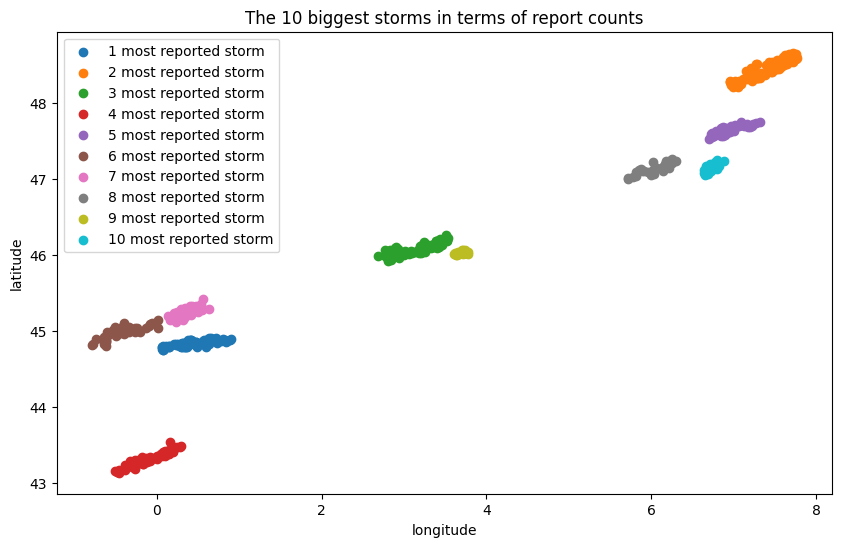

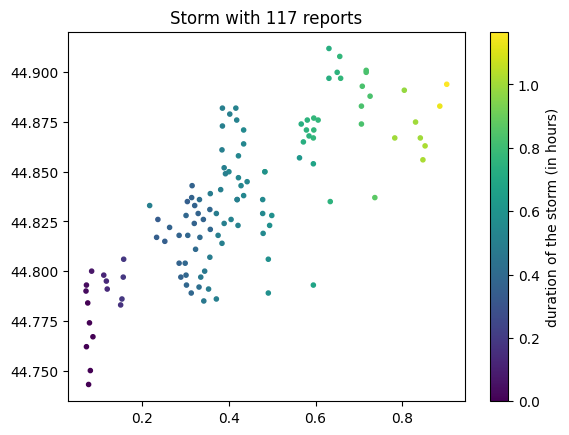

The storm has length 67.52959590342743 km between first report and last report
The storm took place on 2022-06-02 04:00:00


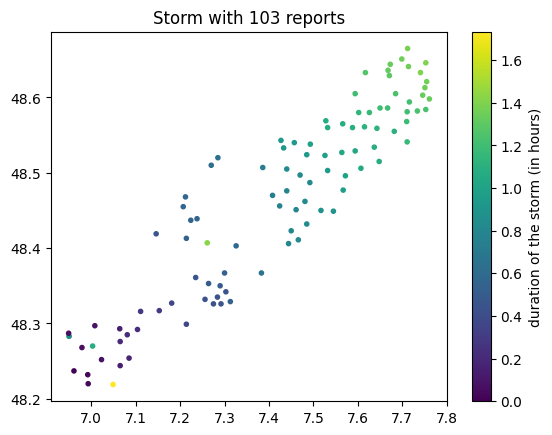

The storm has length 6.8375452025767975 km between first report and last report
The storm took place on 2022-06-26 18:58:00


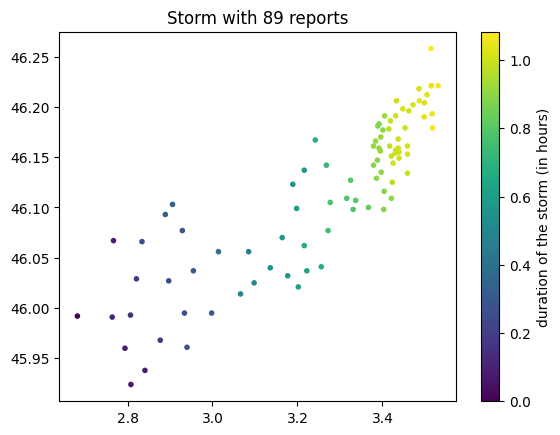

The storm has length 70.77541793306861 km between first report and last report
The storm took place on 2022-06-04 19:30:00


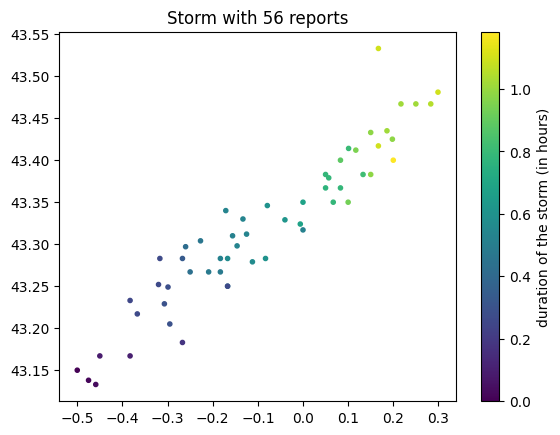

The storm has length 63.24786707277645 km between first report and last report
The storm took place on 2022-06-20 18:44:00


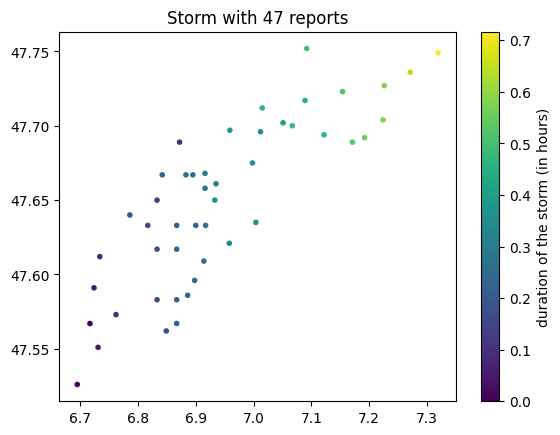

The storm has length 53.04266115230942 km between first report and last report
The storm took place on 2022-06-26 20:21:59.999999744


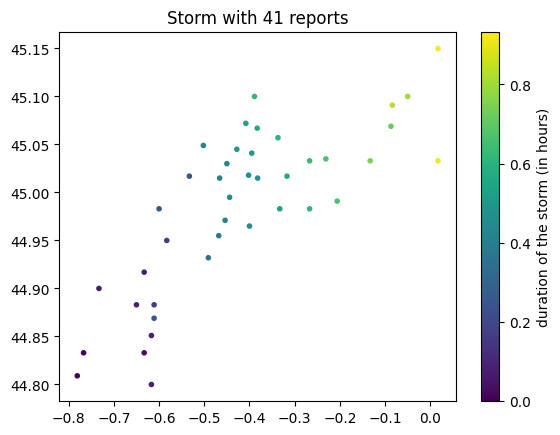

The storm has length 73.46927409221279 km between first report and last report
The storm took place on 2022-06-20 19:05:00


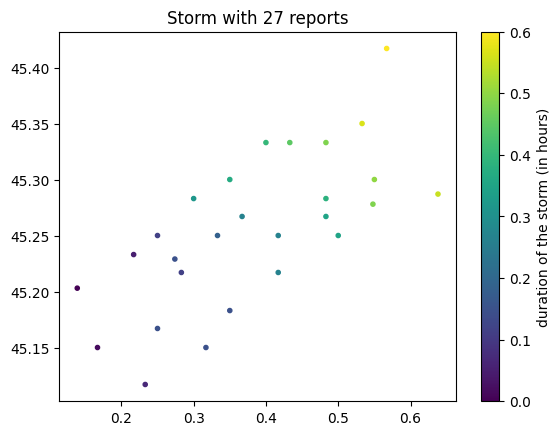

The storm has length 41.136203675462355 km between first report and last report
The storm took place on 2022-06-20 20:09:00


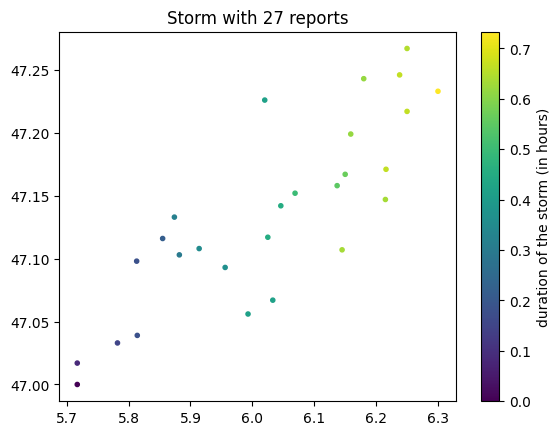

The storm has length 51.26898233914196 km between first report and last report
The storm took place on 2022-06-26 20:25:00


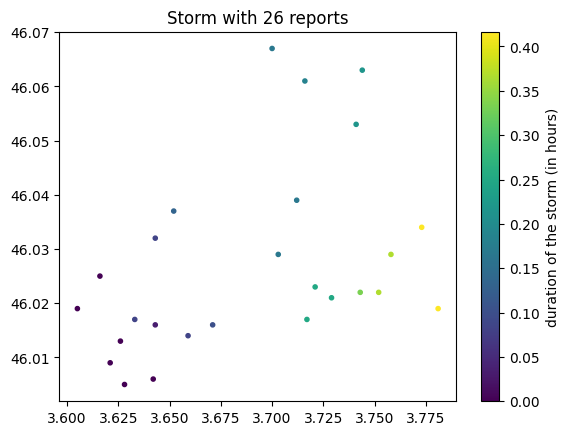

The storm has length 11.619154894308494 km between first report and last report
The storm took place on 2022-06-04 16:20:00


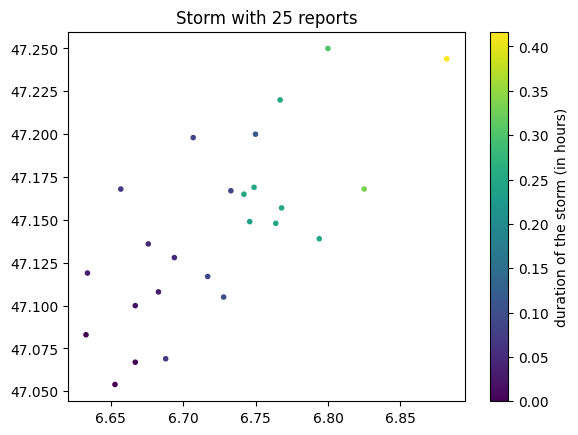

The storm has length 27.346655930039102 km between first report and last report
The storm took place on 2022-07-20 14:30:00


,TIME_EVENT,LATITUDE,LONGITUDE,LABELS
0,462946.250000,45.567,5.933,0
1,462945.866667,45.596,5.875,0
2,462928.500000,49.583,1.358,-1
3,462928.416667,49.533,1.267,1
4,462928.383333,49.521,1.251,1
...,...,...,...,...
1975,458531.666667,43.279,2.460,223
1976,458514.500000,44.600,-0.933,-1
1977,458174.283333,48.669,5.114,-1
1978,458174.166667,48.636,4.952,-1


In [ ]:
# all storms are well-behaved, not bad as merges storms
df7 = run_dbscan_retrieve_classes(df, 0.15, 1, 2)
visualise_biggest(df7,10) 

In [ ]:
df_facts = df7[df7.LABELS > -1]

In [ ]:
labels = df_facts['LABELS'].value_counts()
labels

161    117
60     106
127     98
98      73
99      57
      ... 
126      2
36       2
122      2
119      2
0        2
Name: LABELS, Length: 191, dtype: int64

(array([157.,  21.,   6.,   2.,   1.,   0.,   1.,   0.,   1.,   2.]),
 array([  2. ,  13.5,  25. ,  36.5,  48. ,  59.5,  71. ,  82.5,  94. ,
        105.5, 117. ]),
 <BarContainer object of 10 artists>)

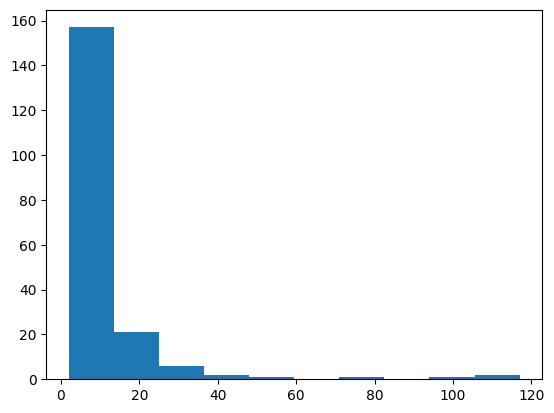

In [ ]:
plt.hist(labels)

STATISTICS ON STORMS

In [ ]:
def visualise_biggest(df, n_biggest):

    nb_reports = pd.DataFrame(df['LABELS'].value_counts()).reset_index()
    nb_reports = nb_reports[nb_reports['index'] != -1].sort_values('LABELS', ascending=False).reset_index()
    labels_biggest_storms = list(nb_reports.iloc[0:3,1])
    df_biggest = df.loc[df.LABELS.isin(labels_biggest_storms)]

    # plots the n_biggest storms 
    plt.figure(figsize=(10,6))
    for i in range(n_biggest):
        a = df_biggest.LONGITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        b = df_biggest.LATITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        lab = df_biggest.loc[df_biggest.LABELS == labels_biggest_storms[i]]
        plt.scatter(a, b, c='C{}'.format(i), label='{} most reported storm'.format(i+1))
    plt.ylabel('latitude')
    plt.xlabel('longitude')
    plt.legend()
    plt.title("The {} biggest storms in terms of report counts".format(len(labels_biggest_storms)))
    plt.show()

    # plot timing of storms in latlon
    for i in range(n_biggest):
        x = df_biggest.LONGITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        y = df_biggest.LATITUDE[df_biggest.LABELS == labels_biggest_storms[i]]
        z = df_biggest.TIME_EVENT[df_biggest.LABELS == labels_biggest_storms[i]]
        z = z - z.iloc[-1]
        x = x.array
        y = y.array
        z = z.array
        axis = plt.subplot(111, title="Storm with {} reports".format(len(x)))
        sc = axis.scatter(x, y, c=z, marker=".")
        plt.colorbar(sc, label="duration of the storm (in hours)")
        plt.show()
        # distance between first and last reports
        df_distance = df_biggest[df_biggest.LABELS==labels_biggest_storms[i]].sort_values('TIME_EVENT')
        df_distance = df_distance.reset_index(drop=True)
        latbegin = df_distance.LATITUDE[0]
        latend = df_distance.LATITUDE[len(df_distance.LATITUDE)-1]
        lonbegin = df_distance.LONGITUDE[0]
        lonend = df_distance.LONGITUDE[len(df_distance.LONGITUDE)-1]
        coords_1 = (latbegin, lonbegin)
        coords_2 = (latend, lonend)
        dist = geopy.distance.geodesic(coords_1, coords_2).km
        print("The storm has length",dist,"km between first report and last report")


    return df

- find density of population in by calculating distance between center of city and report

- actually find density by looking for forests, lakes, green areas.
https://www.observatoire-des-territoires.gouv.fr/outils/cartographie-interactive/#bbox=-784563,6413889,2061226,1124816&c=indicator&i=grid.gridens&view=map36 
https://www.data.gouv.fr/fr/datasets/communes-de-france-base-des-codes-postaux/#resources 

https://www.observatoire-des-territoires.gouv.fr/densite-de-population

- regression : prob reported given density
- find coeff : if density is x then prob of report is y
- create sub groups and reg for each subgroup: departements touche 1 fois, departements touche 2-3 fois, departements touche plus de 3 fois dans l'annee
- recuperer les coefficients du logit
- pour chaque orage, pour des bornes spatio temp, 

- reg prob affected = lat lon time
- prob of affected for each commune

In [35]:
communes_latlon = pd.read_csv("C:/Users/t480/statappradar/communes-departement-region latlon.csv")

In [36]:
communes_densite = pd.read_excel("C:/Users/t480/statappradar/densite communes.xlsx")

In [ ]:
communes_latlon

,code_commune_INSEE,nom_commune_postal,code_postal,libelle_acheminement,ligne_5,latitude,longitude,code_commune,article,nom_commune,nom_commune_complet,code_departement,nom_departement,code_region,nom_region
0,1001,L ABERGEMENT CLEMENCIAT,1400,L ABERGEMENT CLEMENCIAT,NaN,46.153426,4.926114,1.0,L',Abergement-Clémenciat,L'Abergement-Clémenciat,1,Ain,84.0,Auvergne-Rhône-Alpes
1,1002,L ABERGEMENT DE VAREY,1640,L ABERGEMENT DE VAREY,NaN,46.009188,5.428017,2.0,L',Abergement-de-Varey,L'Abergement-de-Varey,1,Ain,84.0,Auvergne-Rhône-Alpes
2,1004,AMBERIEU EN BUGEY,1500,AMBERIEU EN BUGEY,NaN,45.960848,5.372926,4.0,NaN,Ambérieu-en-Bugey,Ambérieu-en-Bugey,1,Ain,84.0,Auvergne-Rhône-Alpes
3,1005,AMBERIEUX EN DOMBES,1330,AMBERIEUX EN DOMBES,NaN,45.996180,4.912273,5.0,NaN,Ambérieux-en-Dombes,Ambérieux-en-Dombes,1,Ain,84.0,Auvergne-Rhône-Alpes
4,1006,AMBLEON,1300,AMBLEON,NaN,45.749499,5.594320,6.0,NaN,Ambléon,Ambléon,1,Ain,84.0,Auvergne-Rhône-Alpes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39196,98831,VOH,98883,OUACO,VOH,NaN,NaN,831.0,NaN,Voh,Voh,98,NaN,NaN,NaN
39197,98832,YATE,98834,YATE,NaN,NaN,NaN,832.0,NaN,Yate,Yate,98,NaN,NaN,NaN
39198,98833,KOUAOUA,98818,KOUAOUA,NaN,NaN,NaN,833.0,NaN,Kouaoua,Kouaoua,98,NaN,NaN,NaN
39199,98901,ILE DE CLIPPERTON,98799,ILE DE CLIPPERTON,NaN,NaN,NaN,901.0,NaN,Ile de clipperton,Ile de clipperton,98,NaN,NaN,NaN


In [37]:
communes_latlon = communes_latlon[['code_commune_INSEE','nom_commune_complet','latitude','longitude']]
communes_latlon = communes_latlon.dropna()
communes_latlon = communes_latlon[~communes_latlon.code_commune_INSEE.str.startswith('97')]
communes_latlon = communes_latlon[~communes_latlon.code_commune_INSEE.str.startswith('2A')]
communes_latlon = communes_latlon[~communes_latlon.code_commune_INSEE.str.startswith('2B')]
communes_latlon['code_commune_INSEE'] = pd.to_numeric(communes_latlon['code_commune_INSEE'])
#communes_latlon['code_commune_INSEE'] = communes_latlon['code_commune_INSEE'].astype(int)
communes_latlon = communes_latlon.rename(columns = {'nom_commune_complet':'Libellé'})
communes_latlon

,code_commune_INSEE,Libellé,latitude,longitude
0,1001,L'Abergement-Clémenciat,46.153426,4.926114
1,1002,L'Abergement-de-Varey,46.009188,5.428017
2,1004,Ambérieu-en-Bugey,45.960848,5.372926
3,1005,Ambérieux-en-Dombes,45.996180,4.912273
4,1006,Ambléon,45.749499,5.594320
...,...,...,...,...
38720,95676,Villers-en-Arthies,49.085900,1.730396
38721,95678,Villiers-Adam,49.070289,2.239509
38722,95680,Villiers-le-Bel,49.008449,2.403856
38723,95682,Villiers-le-Sec,49.074309,2.386890


In [ ]:
type(communes_latlon.iloc[0,0])

numpy.int64

In [ ]:
communes_densite

,Code,Libellé,Grille communale de densité
0,01001,L'Abergement-Clémenciat,3 - Espaces peu denses
1,01002,L'Abergement-de-Varey,4 - Espaces très peu denses
2,01004,Ambérieu-en-Bugey,2 - Espaces de densité intermédiaire
3,01005,Ambérieux-en-Dombes,3 - Espaces peu denses
4,01006,Ambléon,4 - Espaces très peu denses
...,...,...,...
34960,97613,M'Tsangamouji,2 - Espaces de densité intermédiaire
34961,97614,Ouangani,2 - Espaces de densité intermédiaire
34962,97615,Pamandzi,2 - Espaces de densité intermédiaire
34963,97616,Sada,2 - Espaces de densité intermédiaire


In [38]:
communes_densite = communes_densite[~communes_densite.Code.str.startswith('97')]
communes_densite = communes_densite[~communes_densite.Code.str.startswith('2A')]
communes_densite = communes_densite[~communes_densite.Code.str.startswith('2B')]
communes_densite['Code'] = pd.to_numeric(communes_densite['Code'])
communes_densite = communes_densite.rename(columns = {'Code':'code_commune_INSEE'})
communes_densite


,code_commune_INSEE,Libellé,Grille communale de densité
0,1001,L'Abergement-Clémenciat,3 - Espaces peu denses
1,1002,L'Abergement-de-Varey,4 - Espaces très peu denses
2,1004,Ambérieu-en-Bugey,2 - Espaces de densité intermédiaire
3,1005,Ambérieux-en-Dombes,3 - Espaces peu denses
4,1006,Ambléon,4 - Espaces très peu denses
...,...,...,...
34831,95676,Villers-en-Arthies,3 - Espaces peu denses
34832,95678,Villiers-Adam,2 - Espaces de densité intermédiaire
34833,95680,Villiers-le-Bel,1 - Espaces densément peuplés
34834,95682,Villiers-le-Sec,4 - Espaces très peu denses


In [39]:
dense = pd.read_excel("C:/Users/t480/statappradar/INSEE densite communes float.xlsx")

In [ ]:
dense

,codgeo,libgeo,an,dens_pop
0,01001,L'Abergement-Clémenciat,2018,48.34
1,01002,L'Abergement-de-Varey,2018,27.65
2,01004,Ambérieu-en-Bugey,2018,577.40
3,01005,Ambérieux-en-Dombes,2018,108.04
4,01006,Ambléon,2018,19.05
...,...,...,...,...
34960,97613,M'Tsangamouji,2018,NaN
34961,97614,Ouangani,2018,NaN
34962,97615,Pamandzi,2018,NaN
34963,97616,Sada,2018,NaN


In [40]:
dense = dense[['codgeo','libgeo','dens_pop']]
dense = dense[~dense.codgeo.str.startswith('97')]
dense = dense[~dense.codgeo.str.startswith('2A')]
dense = dense[~dense.codgeo.str.startswith('2B')]
dense['codgeo'] = pd.to_numeric(dense['codgeo'])
dense = dense.rename(columns = {'codgeo':'code_commune_INSEE'})
dense


,code_commune_INSEE,libgeo,dens_pop
0,1001,L'Abergement-Clémenciat,48.34
1,1002,L'Abergement-de-Varey,27.65
2,1004,Ambérieu-en-Bugey,577.40
3,1005,Ambérieux-en-Dombes,108.04
4,1006,Ambléon,19.05
...,...,...,...
34831,95676,Villers-en-Arthies,60.24
34832,95678,Villiers-Adam,87.68
34833,95680,Villiers-le-Bel,3841.23
34834,95682,Villiers-le-Sec,57.36


In [41]:
communes = pd.merge(communes_latlon, dense,how='inner', on='code_commune_INSEE')
communes = communes.drop(columns=['libgeo'])
communes = communes.rename(columns = {'Libellé':'PLACE'})
communes = communes.drop_duplicates()
#communes['PLACE'].value_counts().head(15)
#communes.loc[communes['PLACE'] == "Livarot-Pays-d'Auge", :]
communes


,code_commune_INSEE,PLACE,latitude,longitude,dens_pop
0,1001,L'Abergement-Clémenciat,46.153426,4.926114,48.34
1,1002,L'Abergement-de-Varey,46.009188,5.428017,27.65
2,1004,Ambérieu-en-Bugey,45.960848,5.372926,577.40
3,1005,Ambérieux-en-Dombes,45.996180,4.912273,108.04
4,1006,Ambléon,45.749499,5.594320,19.05
...,...,...,...,...,...
37266,95676,Villers-en-Arthies,49.085900,1.730396,60.24
37267,95678,Villiers-Adam,49.070289,2.239509,87.68
37268,95680,Villiers-le-Bel,49.008449,2.403856,3841.23
37269,95682,Villiers-le-Sec,49.074309,2.386890,57.36


In [ ]:
communes.to_csv("C:/Users/t480/statappradar/communes.csv")

Preparing data for the logistic regression

In [42]:
data = pd.read_csv("C:/Users/t480/statappradar/eswd_reports_europe_1970_2022.csv")

C:\Users\t480\AppData\Local\Temp\ipykernel_20336\721562798.py:1: DtypeWarning: Columns (18,22,23,24,50,51,77,78,79,85,88) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("C:/Users/t480/statappradar/eswd_reports_europe_1970_2022.csv")


In [43]:
df=data.drop(['CONTACT','EMAIL', 'ORGANISATION', 'ORGANISATION_ID','CREATOR_ID','REVISOR_ID','PERSON_REVISION','PLACE_LOCAL_LANGUAGE','OROGRAPHY','SURFACE_INITIAL_LOCATION','SURFACE_CROSSED','NO_OBJECTS','EXT_URL','LINK_ORG','LINK_ID','DELETED','F_SCALE','T_SCALE','RATING_BASIS','WIND_SPEED','TEN_MIN_WIND_SPEED','FUNNEL_SIGHTED'  ,'SUCTION_VORTICES' ,'PRECIPITATION_AMOUNT','SNOW_FALL_AMOUNT','PEAK_PRECIP_AMOUNT','PEAK_SNOW_FALL_AMOUNT','PEAK_PRECIP_PERIOD','MAX_6_HOUR_PRECIP','MAX_6_HOUR_SNOW_FALL','MAX_12_HOUR_PRECIP','MAX_12_HOUR_SNOW_FALL','MAX_24_HOUR_PRECIP' ,'MAX_24_HOUR_SNOW_FALL','TYPE_PRECIP','SIZE_ACCOMPANYING_HAIL','POSSIBILITIES','PATH_LENGTH','MEAN_PATH_WIDTH','MAX_PATH_WIDTH','MAX_VERTICAL_DEVELOP','DIRECTION_MOVEMENT','SNOW_HAZARDS','MEAN_HEIGHT_SNOW_CORNICES','MAX_HEIGHT_SNOW_CORNICES','ICE_HAZARDS','THICKNESS_ICE_COVER','THICKNESS_RIME_COVER','AVALANCHE_TYPE','AVALANCHE_FLOW_TYPE','SNOW_MASS_TYPE','AVALANCHE_SIZE','AVALANCHE_TRIGGER','ELEVATION_START','ELEVATION_DIFFERENCE','LIGHTNING_DAMAGE_TO','PEAK_CURRENT','POLARITY','TIME_CREATION','TIME_LAST_REVISION','DETAILED_LOCATION','MAX_HAILSTONE_WEIGHT','CONVECTIVE','PATH_START_LATITUDE','PATH_START_LONGITUDE','PATH_START_DATETIME','PATH_END_LATITUDE','PATH_END_LONGITUDE','PATH_END_DATETIME'],axis=1)

# function allowing us to extract the year from the date of the event
def get_year(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.year
    return dt

# creation of a column containing the year of the event
df['YEAR']=df.apply(lambda donnee: get_year(donnee), axis=1)

# deleting data prior to 2007 
df.drop(df[df.YEAR < 2007].index, inplace=True)

# function allowing us to extract the month from the date of the event
def get_month(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.month
    return dt

# creation of a column containing the month of the event
df['MONTH']=df.apply(lambda donnee: get_month(donnee), axis=1)

# function allowing us to extract the day from the date of the event
def get_day(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.day
    return dt

# creation of a column containing the month of the event
df['DAY']=df.apply(lambda donnee: get_day(donnee), axis=1)

# function allowing us to extract the hour from the date of the event
def get_hour(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.hour
    return dt

# creation of a column containing the month of the event
df['HOUR']=df.apply(lambda donnee: get_hour(donnee), axis=1)

#maintaining only the columns needed for our model
df=df.loc[:,['LATITUDE','LONGITUDE','TIME_EVENT','COUNTRY','PLACE', 'YEAR', 'MAX_HAIL_DIAMETER']]
#df=df.loc[:,['LATITUDE','LONGITUDE','TIME_EVENT','COUNTRY','YEAR', 'MONTH', 'HOUR','PLACE', 'MAX_HAIL_DIAMETER']]

# delete data prior to 2013 
#(radar data provided to us only start from 2013, we wont be able to confront data prior to that year)
df.drop(df[df.YEAR < 2013].index, inplace=True)
df=df.loc[:,['LATITUDE','LONGITUDE','TIME_EVENT','COUNTRY','PLACE', 'MAX_HAIL_DIAMETER']]

# selecting France and converting to timestamps
df = convert_time_to_timestamps(df)
df = df.reset_index(drop=True)
country = 'FR'
df = df[df['COUNTRY'] == country]

# filtering on mainland France
#print(df_mainland_fr.LATITUDE.max(), df_mainland_fr.LATITUDE.min(), df_mainland_fr.LONGITUDE.max(), df_mainland_fr.LONGITUDE.min(),
# communes.latitude.max(), communes.latitude.min(), communes.longitude.max(), communes.longitude.min())
df.drop(df[df.LATITUDE > communes.latitude.max()].index, inplace=True)
df.drop(df[df.LATITUDE < communes.latitude.min()].index, inplace=True)
df.drop(df[df.LONGITUDE > communes.longitude.max()].index, inplace=True)
df.drop(df[df.LONGITUDE < communes.longitude.min()].index, inplace=True)

nom=ArcGIS()
nom.geocode("Monaco") 
#43.73170451200008, 7.424355000000048
df = df.drop(df[(df.LATITUDE < 43.73170451200008) & (df.LONGITUDE > 7.424355000000048)].index)

df_mainland_fr = df 
df_mainland_fr

df_density = communes.loc[:,['dens_pop','PLACE']]
df_mainland_fr = pd.merge(df_mainland_fr, df_density,how='inner', on='PLACE')
print(df_mainland_fr.LATITUDE.max(), df_mainland_fr.LATITUDE.min(), df_mainland_fr.LONGITUDE.max(), df_mainland_fr.LONGITUDE.min(),
 communes.latitude.max(), communes.latitude.min(), communes.longitude.max(), communes.longitude.min())

df_dbscan = df_mainland_fr[['TIME_EVENT', 'LATITUDE', 'LONGITUDE']]
df_dbscan = df_dbscan.reset_index(drop=True)
df_dbscan = run_dbscan_retrieve_classes(df_dbscan, 0.16, 1, 2)
df_mainland_fr['LABEL'] = df_dbscan.loc[:,'LABELS']

dfreg = df_mainland_fr[df_mainland_fr.LABEL > -1]
dfreg = dfreg.drop(columns=['COUNTRY','PLACE'])

dummies = pd.get_dummies(dfreg['LABEL'])
dummies
dfreg = dfreg.join(dummies)

dfreg

51.05 42.433 8.133 -3.95 51.0730436867 42.3559782284 8.18637725776 -5.08534533544


,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,0,1,2,3,...,411,412,413,414,415,416,417,418,419,420
0,45.567,5.933,462946.250000,2.0,2802.91,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,45.567,5.933,452126.750000,2.0,2802.91,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,45.596,5.875,462945.866667,2.0,399.73,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,49.583,1.358,462928.500000,4.5,27.09,2,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,49.583,1.358,462928.500000,4.5,107.41,2,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3230,47.284,2.954,380728.000000,NaN,79.93,419,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3232,47.317,2.967,380728.000000,NaN,27.03,419,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3234,47.983,6.750,379861.250000,2.0,63.15,420,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3235,47.933,6.667,379861.083333,4.0,77.45,420,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
dfreg.LABEL.value_counts()

68     100
141     85
11      75
90      70
144     56
      ... 
247      2
248      2
252      2
255      2
420      2
Name: LABEL, Length: 421, dtype: int64

In [ ]:
dfreg.MAX_HAIL_DIAMETER.count()/dfreg.shape[0]

0.7933358292774242

LOGISTIC REGRESSION

In [ ]:
# first regression with Max hail diameter but removing NAN

df_max_hail = dfreg.dropna()

y = df_max_hail.loc[:,68]
x = df_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop","MAX_HAIL_DIAMETER"]]
x

# on ajoute une colonne pour la constante
x_stat = sm.add_constant(x)
# on ajuste le modèle
model = sm.Logit(y, x_stat)
result = model.fit()

result.summary()

Optimization terminated successfully.
         Current function value: inf
         Iterations 14


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\discrete\discrete_model.py:1819: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\discrete\discrete_model.py:1872: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                     68   No. Observations:                 2119
Model:                          Logit   Df Residuals:                     2113
Method:                           MLE   Df Model:                            5
Date:                Mon, 30 Jan 2023   Pseudo R-squ.:                     inf
Time:                        17:21:20   Log-Likelihood:                   -inf
converged:                       True   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
=====================================================================================
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const              -335.9302     47.843     -7.022      0.000    -429.700    -242.160
LATITUDE              4.6783      0.550      8.505      0.000       3.600       5.756
LONGITUDE             3.6913      0.495      7.454      0.000       2.721       4.662
TIME_EVENT            0.0002   7.68e-05      2.301      0.021    2.62e-05       0.000
dens_pop             -0.0005      0.000     -1.266      0.206      -0.001       0.000
MAX_HAIL_DIAMETER     0.6968      0.188      3.710      0.000       0.329       1.065
=====================================================================================

Possibly complete quasi-separation: A fraction 0.80 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [ ]:
# first regression without Max hail diameter so more obs

df_no_max_hail = dfreg.copy()

y = df_no_max_hail.loc[:,68]
x = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]
x

# on ajoute une colonne pour la constante
x_stat = sm.add_constant(x)
# on ajuste le modèle
model = sm.Logit(y, x_stat)
result = model.fit()

result.summary()

Optimization terminated successfully.
         Current function value: inf
         Iterations 16


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\discrete\discrete_model.py:1819: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\discrete\discrete_model.py:1872: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                     68   No. Observations:                 2671
Model:                          Logit   Df Residuals:                     2666
Method:                           MLE   Df Model:                            4
Date:                Mon, 30 Jan 2023   Pseudo R-squ.:                     inf
Time:                        17:22:32   Log-Likelihood:                   -inf
converged:                       True   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       -393.4857     96.975     -4.058      0.000    -583.553    -203.419
LATITUDE       4.2256      0.528      8.008      0.000       3.191       5.260
LONGITUDE      3.2135      0.416      7.731      0.000       2.399       4.028
TIME_EVENT     0.0004      0.000      1.911      0.056   -9.24e-06       0.001
dens_pop      -0.0003      0.000     -0.800      0.424      -0.001       0.000
==============================================================================

Possibly complete quasi-separation: A fraction 0.83 of observations can be
perfectly predicted. This might indicate that there is complete
quasi-separation. In this case some parameters will not be identified.
"""

In [ ]:
# most reported storms (imbalanced data)

dfreg['LABEL'].value_counts()/df.shape[0]


68     0.031496
141    0.026772
11     0.023622
90     0.022047
144    0.017638
         ...   
247    0.000630
248    0.000630
252    0.000630
255    0.000630
420    0.000630
Name: LABEL, Length: 421, dtype: float64

<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

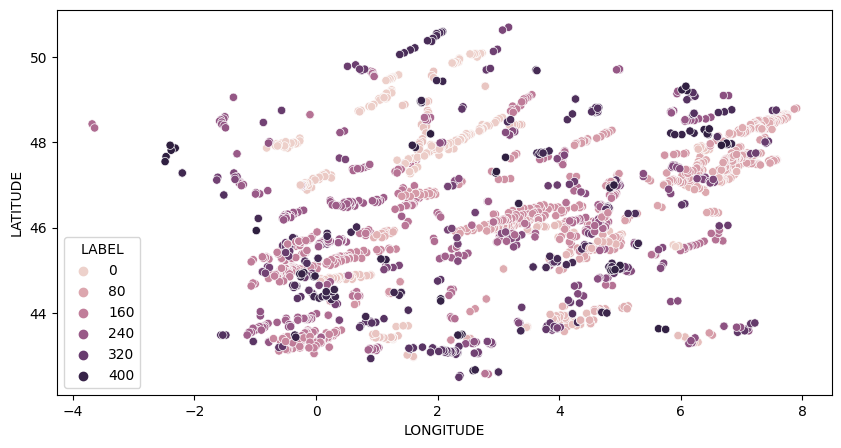

In [ ]:
# scatter plot
plt.figure(figsize=(10,5))
sns.scatterplot(data=dfreg,x='LONGITUDE',y='LATITUDE',hue='LABEL')

In [21]:
# split dataset into x,y
df_max_hail = dfreg.dropna()
y = df_max_hail.loc[:,68]
x = df_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop","MAX_HAIL_DIAMETER"]]

# train-test split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=13)

In [55]:
# define model
lg1 = LogisticRegression(random_state=13, class_weight=None)
# fit it
lg1.fit(X_train,y_train)
# test
y_pred = lg1.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
print(f'Recall score: {recall_score(y_test,y_pred)}')

Accuracy Score: 0.9544025157232704
Confusion Matrix: 
[[607   0]
 [ 29   0]]
Area Under Curve: 0.5
Recall score: 0.0


In [56]:
# define class weights
w = {0:1, 1:99}
# define model
lg2 = LogisticRegression(random_state=13, class_weight=w)
# fit it
lg2.fit(X_train,y_train)
# test
y_pred = lg2.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
print(f'Recall score: {recall_score(y_test,y_pred)}')

Accuracy Score: 0.8647798742138365
Confusion Matrix: 
[[521  86]
 [  0  29]]
Area Under Curve: 0.929159802306425
Recall score: 1.0


In [19]:
# define weight hyperparameter
w = [{0:1000,1:100},{0:1000,1:10}, {0:1000,1:1.0}, 
     {0:500,1:1.0}, {0:400,1:1.0}, {0:300,1:1.0}, {0:200,1:1.0}, 
     {0:150,1:1.0}, {0:100,1:1.0}, {0:99,1:1.0}, {0:10,1:1.0}, 
     {0:0.01,1:1.0}, {0:0.01,1:10}, {0:0.01,1:100}, 
     {0:0.001,1:1.0}, {0:0.005,1:1.0}, {0:1.0,1:1.0}, 
     {0:1.0,1:0.1}, {0:10,1:0.1}, {0:100,1:0.1}, 
     {0:10,1:0.01}, {0:1.0,1:0.01}, {0:1.0,1:0.001}, {0:1.0,1:0.005}, 
     {0:1.0,1:10}, {0:1.0,1:99}, {0:1.0,1:100}, {0:1.0,1:150}, 
     {0:1.0,1:200}, {0:1.0,1:300},{0:1.0,1:400},{0:1.0,1:500}, 
     {0:1.0,1:1000}, {0:10,1:1000},{0:100,1:1000} ]
hyperparam_grid = {"class_weight": w }

In [22]:
# define model
lg3 = LogisticRegression(random_state=13)
# define evaluation procedure
grid = GridSearchCV(lg3,hyperparam_grid,scoring="roc_auc", cv=100, n_jobs=-1, refit=True)
grid.fit(x,y)
print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

Best score: 0.8251428571428572 with param: {'class_weight': {0: 1.0, 1: 99}}


In [59]:
# define model
lg3 = LogisticRegression(random_state=13, class_weight={0: 1.0, 1: 99})
# fit it
lg3.fit(X_train,y_train)
# test
y_pred = lg3.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
print(f'Recall score: {recall_score(y_test,y_pred)}')

Accuracy Score: 0.8647798742138365
Confusion Matrix: 
[[521  86]
 [  0  29]]
Area Under Curve: 0.929159802306425
Recall score: 1.0


In [60]:
# define hyperparameters
w = [{0:1000,1:100},{0:1000,1:10}, {0:1000,1:1.0}, 
     {0:500,1:1.0}, {0:400,1:1.0}, {0:300,1:1.0}, {0:200,1:1.0}, 
     {0:150,1:1.0}, {0:100,1:1.0}, {0:99,1:1.0}, {0:10,1:1.0}, 
     {0:0.01,1:1.0}, {0:0.01,1:10}, {0:0.01,1:100}, 
     {0:0.001,1:1.0}, {0:0.005,1:1.0}, {0:1.0,1:1.0}, 
     {0:1.0,1:0.1}, {0:10,1:0.1}, {0:100,1:0.1}, 
     {0:10,1:0.01}, {0:1.0,1:0.01}, {0:1.0,1:0.001}, {0:1.0,1:0.005}, 
     {0:1.0,1:10}, {0:1.0,1:99}, {0:1.0,1:100}, {0:1.0,1:150}, 
     {0:1.0,1:200}, {0:1.0,1:300},{0:1.0,1:400},{0:1.0,1:500}, 
     {0:1.0,1:1000}, {0:10,1:1000},{0:100,1:1000} ]
crange = np.arange(0.5, 20.0, 0.5)
hyperparam_grid = {"class_weight": w
                   ,"penalty": ["l1", "l2"]
                   ,"C": crange
                   ,"fit_intercept": [True, False]  }

In [67]:
# logistic model classifier
lg4 = LogisticRegression(random_state=13)
# define evaluation procedure
grid = GridSearchCV(lg4,hyperparam_grid,scoring="roc_auc", cv=50, n_jobs=-1, refit=True)
grid.fit(x,y)
print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
136500 fits failed out of a total of 273000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
136500 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\linear_model\_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\sit

Best score: 0.8275182926829268 with param: {'C': 1.5, 'class_weight': {0: 1.0, 1: 99}, 'fit_intercept': True, 'penalty': 'l2'}


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_search.py:953: UserWarning: One or more of the test scores are non-finite: [       nan 0.66153659        nan ... 0.7567378         nan 0.7567378 ]
  warnings.warn(


In [1]:
# define model
lg4 = LogisticRegression(random_state=13,C=1.5,fit_intercept=True, penalty='l2',class_weight={0: 1.0, 1: 99})
# fit it
lg4.fit(X_train,y_train)
# test
y_pred = lg4.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}') # 0.5
print(f'Recall score: {recall_score(y_test,y_pred)}')

NameError: name 'LogisticRegression' is not defined

In [ ]:
# split dataset into x,y
df_max_hail = dfreg.dropna()
y = df_max_hail.loc[:,68]
x = df_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop","MAX_HAIL_DIAMETER"]]

# train-test split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=13)

# define model
lg3 = LogisticRegression(random_state=13, class_weight={0: 1.0, 1: 99})
# fit it
lg3.fit(X_train,y_train)
# test
y_pred = lg3.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
print(f'Recall score: {recall_score(y_test,y_pred)}')

Accuracy Score: 0.8647798742138365
Confusion Matrix: 
[[521  86]
 [  0  29]]
Area Under Curve: 0.929159802306425
Recall score: 1.0


In [21]:
def logit_pred(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, using max hail diameter but to be replaced by radar
    df_max_hail = dfreg.dropna()
    y = df_max_hail.loc[:,which_cluster]
    x = df_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop","MAX_HAIL_DIAMETER"]]
    x

    # define weight hyperparameter
    w = [{0:1000,1:100},{0:1000,1:10}, {0:1000,1:1.0}, 
        {0:500,1:1.0}, {0:400,1:1.0}, {0:300,1:1.0}, {0:200,1:1.0}, 
        {0:150,1:1.0}, {0:100,1:1.0}, {0:99,1:1.0}, {0:10,1:1.0}, 
        {0:0.01,1:1.0}, {0:0.01,1:10}, {0:0.01,1:100}, 
        {0:0.001,1:1.0}, {0:0.005,1:1.0}, {0:1.0,1:1.0}, 
        {0:1.0,1:0.1}, {0:10,1:0.1}, {0:100,1:0.1}, 
        {0:10,1:0.01}, {0:1.0,1:0.01}, {0:1.0,1:0.001}, {0:1.0,1:0.005}, 
        {0:1.0,1:10}, {0:1.0,1:99}, {0:1.0,1:100}, {0:1.0,1:150}, 
        {0:1.0,1:200}, {0:1.0,1:300},{0:1.0,1:400},{0:1.0,1:500}, 
        {0:1.0,1:1000}, {0:10,1:1000},{0:100,1:1000} ]
    hyperparam_grid = {"class_weight": w }

    # define model
    lg3 = LogisticRegression(random_state=13)
    # define evaluation procedure
    grid = GridSearchCV(lg3,hyperparam_grid,scoring="roc_auc", cv=100, n_jobs=-1, refit=True)
    grid.fit(x,y)
    print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

    # confusion matrix of train-test
    # train-test split
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=13)

    # define model
    lg3 = LogisticRegression(random_state=13, class_weight=grid.best_params_['class_weight'])
    # fit it
    lg3.fit(X_train,y_train)
    # test
    y_pred = lg3.predict(X_test)
    # performance
    print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
    print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
    print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
    print(f'Recall score: {recall_score(y_test,y_pred)}')

    # bin reports to predict if they belong to the current cluster
    dflogit = df_mainland_fr.copy()
    dflogit = dflogit.drop(columns=['COUNTRY','PLACE'])
    dflogit = dflogit[dflogit["LABEL"]==-1]
    dflogit = dflogit.dropna()
    x_test = dflogit[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop","MAX_HAIL_DIAMETER"]]

    # define model
    logit = LogisticRegression(random_state=13, class_weight= grid.best_params_['class_weight'])
    # fit it
    logit.fit(x,y)
    # test
    y_pred = logit.predict(x_test)

    # proportion of bin cluster assigned to biggest cluster
    prop_bin_to_cluster = y_pred.sum()/y_pred.shape[0]
    print("The proportion of the bin cluster assigned to cluster:",prop_bin_to_cluster)


    dflogit["y_pred"] = y_pred
    cluster = df_max_hail[df_max_hail["LABEL"]==which_cluster]
    # scatter plot
    plt.figure(figsize=(10,5))
    sns.scatterplot(data=dflogit,x='LONGITUDE',y='LATITUDE',hue='y_pred')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')

    return dflogit, cluster


Best score: 0.8251428571428572 with param: {'class_weight': {0: 1.0, 1: 99}}
Accuracy Score: 0.8647798742138365
Confusion Matrix: 
[[521  86]
 [  0  29]]
Area Under Curve: 0.929159802306425
Recall score: 1.0
The proportion of the bin cluster assigned to cluster: 0.14049586776859505


(      LATITUDE  LONGITUDE     TIME_EVENT  MAX_HAIL_DIAMETER  dens_pop  LABEL  \
 6       48.333      1.933  462926.783333                7.0    144.14     -1   
 33      49.900      2.300  398197.666667                2.0   2707.06     -1   
 39      49.502      1.586  462927.050000                3.0     18.23     -1   
 42      48.500      0.483  462926.500000                2.5     25.59     -1   
 58      48.183     -0.892  462924.166667                2.0     70.29     -1   
 ...        ...        ...            ...                ...       ...    ...   
 3221    48.133      2.750  380955.000000                5.0    138.19     -1   
 3224    46.467     -0.817  380953.000000                3.0    390.66     -1   
 3226    48.083      0.667  380953.000000                4.0     33.32     -1   
 3229    45.917     -0.800  380952.833333                3.5     33.78     -1   
 3237    47.850      3.967  379827.000000                2.0     76.85     -1   
 
       y_pred  
 6        

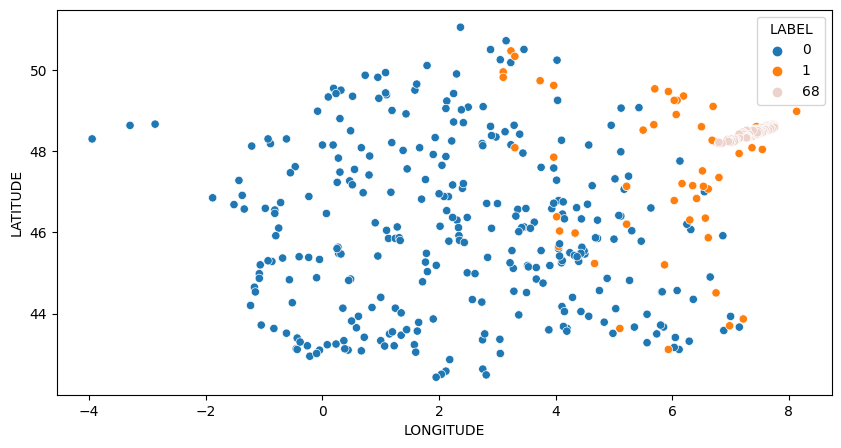

In [22]:
logit_pred(dfreg,68)

Best score: 0.9434494773519164 with param: {'class_weight': {0: 1.0, 1: 99}}
Accuracy Score: 0.026729559748427674
Confusion Matrix: 
[[  0 619]
 [  0  17]]
Area Under Curve: 0.5
Recall score: 1.0
The proportion of the bin cluster assigned to cluster: 1.0


(      LATITUDE  LONGITUDE     TIME_EVENT  MAX_HAIL_DIAMETER  dens_pop  LABEL  \
 6       48.333      1.933  462926.783333                7.0    144.14     -1   
 33      49.900      2.300  398197.666667                2.0   2707.06     -1   
 39      49.502      1.586  462927.050000                3.0     18.23     -1   
 42      48.500      0.483  462926.500000                2.5     25.59     -1   
 58      48.183     -0.892  462924.166667                2.0     70.29     -1   
 ...        ...        ...            ...                ...       ...    ...   
 3221    48.133      2.750  380955.000000                5.0    138.19     -1   
 3224    46.467     -0.817  380953.000000                3.0    390.66     -1   
 3226    48.083      0.667  380953.000000                4.0     33.32     -1   
 3229    45.917     -0.800  380952.833333                3.5     33.78     -1   
 3237    47.850      3.967  379827.000000                2.0     76.85     -1   
 
       y_pred  
 6        

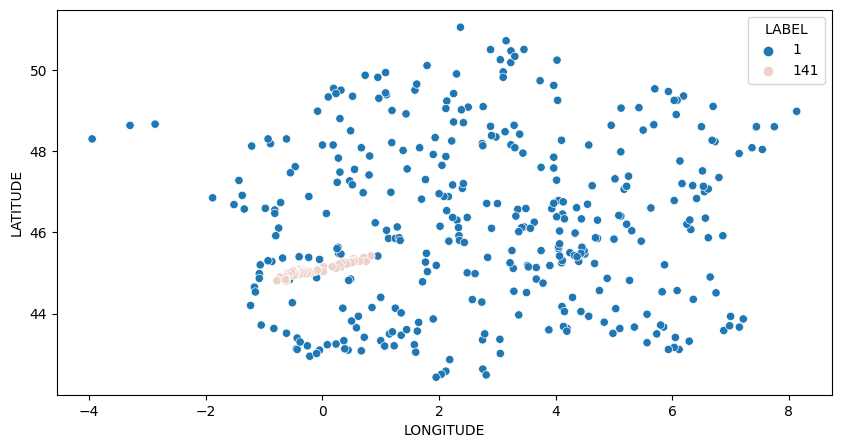

In [20]:
logit_pred(dfreg,141)

In [9]:
# now without max hail diameter

def logit_pred_noNA(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    x = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]
    x

    # define weight hyperparameter
    w = [{0:1000,1:100},{0:1000,1:10}, {0:1000,1:1.0}, 
        {0:500,1:1.0}, {0:400,1:1.0}, {0:300,1:1.0}, {0:200,1:1.0}, 
        {0:150,1:1.0}, {0:100,1:1.0}, {0:99,1:1.0}, {0:10,1:1.0}, 
        {0:0.01,1:1.0}, {0:0.01,1:10}, {0:0.01,1:100}, 
        {0:0.001,1:1.0}, {0:0.005,1:1.0}, {0:1.0,1:1.0}, 
        {0:1.0,1:0.1}, {0:10,1:0.1}, {0:100,1:0.1}, 
        {0:10,1:0.01}, {0:1.0,1:0.01}, {0:1.0,1:0.001}, {0:1.0,1:0.005}, 
        {0:1.0,1:10}, {0:1.0,1:99}, {0:1.0,1:100}, {0:1.0,1:150}, 
        {0:1.0,1:200}, {0:1.0,1:300},{0:1.0,1:400},{0:1.0,1:500}, 
        {0:1.0,1:1000}, {0:10,1:1000},{0:100,1:1000} ]
    hyperparam_grid = {"class_weight": w }

    # define model
    lg3 = LogisticRegression(random_state=13)
    # define evaluation procedure
    grid = GridSearchCV(lg3,hyperparam_grid,scoring="roc_auc", cv=100, n_jobs=-1, refit=True)
    grid.fit(x,y)
    print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

    # confusion matrix of train-test
    # train-test split
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=13)

    # define model
    lg3 = LogisticRegression(random_state=13, class_weight={0: 1.0, 1: 99})
    # fit it
    lg3.fit(X_train,y_train)
    # test
    y_pred = lg3.predict(X_test)
    # performance
    print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
    print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
    print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
    print(f'Recall score: {recall_score(y_test,y_pred)}')

    # bin reports to predict if they belong to the current cluster
    dflogit = df_mainland_fr.copy()
    dflogit = dflogit.drop(columns=['COUNTRY','PLACE'])
    dflogit = dflogit[dflogit["LABEL"]==-1]
    dflogit = dflogit.dropna()
    x_test = dflogit[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    # define model
    logit = LogisticRegression(random_state=13, class_weight= grid.best_params_['class_weight'])
    # fit it
    logit.fit(x,y)
    # test
    y_pred = logit.predict(x_test)

    # proportion of bin cluster assigned to biggest cluster
    prop_bin_to_cluster = y_pred.sum()/y_pred.shape[0]
    print("The proportion of the bin cluster assigned to cluster:",prop_bin_to_cluster)

    # stats
    predict_proba = logit.predict_proba(x_test) 
    score = logit.score(x,y)
    params = logit.get_params()
    print('The probabilites are:',predict_proba)
    print('Score =',score)
    print('Parameters=',params)

    dflogit["y_pred"] = y_pred
    dflogit["predict_proba"] = predict_proba[:,1]
    cluster = df_no_max_hail[df_no_max_hail["LABEL"]==which_cluster]
    # scatter plot
    plt.figure(figsize=(10,5))
    sns.scatterplot(data=dflogit,x='LONGITUDE',y='LATITUDE',hue='y_pred')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')

    return dflogit, cluster


Best score: 0.914676923076923 with param: {'class_weight': {0: 0.01, 1: 1.0}}
Accuracy Score: 0.9039900249376559
Confusion Matrix: 
[[689  77]
 [  0  36]]
Area Under Curve: 0.9497389033942558
Recall score: 1.0
The proportion of the bin cluster assigned to cluster: 0.16804407713498623
The probabilites are: [[9.99815002e-01 1.84997794e-04]
 [8.94676205e-01 1.05323795e-01]
 [9.99840072e-01 1.59928426e-04]
 [9.99990752e-01 9.24830511e-06]
 [9.99999580e-01 4.19720376e-07]
 [9.99996981e-01 3.01891689e-06]
 [5.03745862e-01 4.96254138e-01]
 [4.93709945e-01 5.06290055e-01]
 [9.99999922e-01 7.78113420e-08]
 [9.99956020e-01 4.39799265e-05]
 [9.99839134e-01 1.60866130e-04]
 [9.89923471e-01 1.00765287e-02]
 [9.98753510e-01 1.24648972e-03]
 [9.99996526e-01 3.47427721e-06]
 [9.99999171e-01 8.28580593e-07]
 [9.99999784e-01 2.16288070e-07]
 [9.99569905e-01 4.30094971e-04]
 [9.94217834e-01 5.78216608e-03]
 [9.99862706e-01 1.37293721e-04]
 [9.99461412e-01 5.38587792e-04]
 [9.16774228e-01 8.32257716e-02]


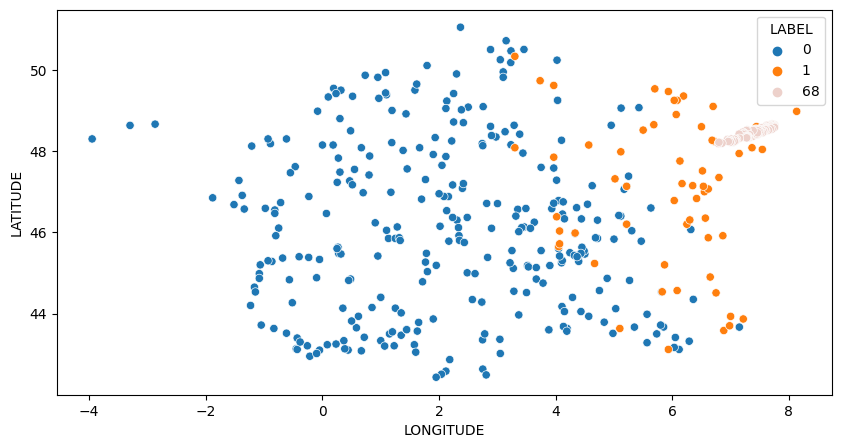

In [10]:
dflogit, cluster = logit_pred_noNA(dfreg, 68) # also plot threshold 

<AxesSubplot: xlabel='predict_proba', ylabel='Count'>

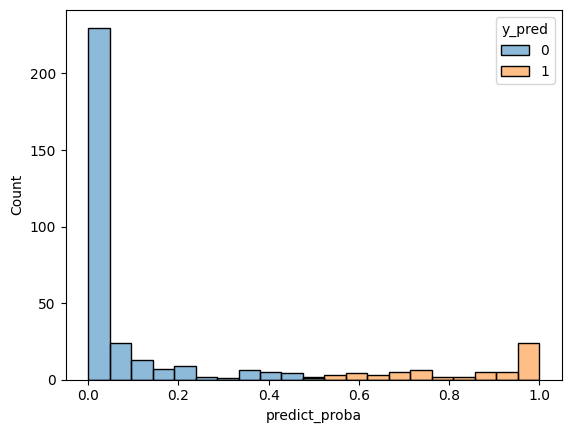

In [59]:
# threshold at 0.5
sns.histplot(data=dflogit, x="predict_proba", hue='y_pred')

In [33]:
dflogit

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,y_pred,predict_proba
6,48.333,1.933,462926.783333,7.0,144.14,-1,0,1.849978e-04
33,49.900,2.300,398197.666667,2.0,2707.06,-1,0,1.053238e-01
39,49.502,1.586,462927.050000,3.0,18.23,-1,0,1.599284e-04
42,48.500,0.483,462926.500000,2.5,25.59,-1,0,9.248305e-06
58,48.183,-0.892,462924.166667,2.0,70.29,-1,0,4.197204e-07
...,...,...,...,...,...,...,...,...
3221,48.133,2.750,380955.000000,5.0,138.19,-1,0,3.904540e-01
3224,46.467,-0.817,380953.000000,3.0,390.66,-1,0,1.361568e-04
3226,48.083,0.667,380953.000000,4.0,33.32,-1,0,7.392440e-03
3229,45.917,-0.800,380952.833333,3.5,33.78,-1,0,1.110989e-04


In [32]:
cluster

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,0,1,2,3,...,411,412,413,414,415,416,417,418,419,420
368,48.462,7.481,2022-06-26 19:47:00.000000000,3.50,440.95,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
370,48.456,7.424,2022-06-26 19:44:00.000000000,3.00,53.41,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
379,48.476,7.440,2022-06-26 19:45:00.000000000,2.50,104.40,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
383,48.367,7.383,2022-06-26 19:38:00.000000256,4.25,60.20,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
389,48.342,7.303,2022-06-26 19:25:00.000000000,5.00,640.14,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,48.220,6.993,2022-06-26 19:00:00.000000000,3.00,47.33,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
780,48.237,6.961,2022-06-26 18:58:00.000000000,2.00,142.09,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
782,48.195,6.853,2022-06-26 18:50:00.000000000,2.50,29.02,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
784,48.186,6.791,2022-06-26 18:47:00.000000000,3.00,28.13,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

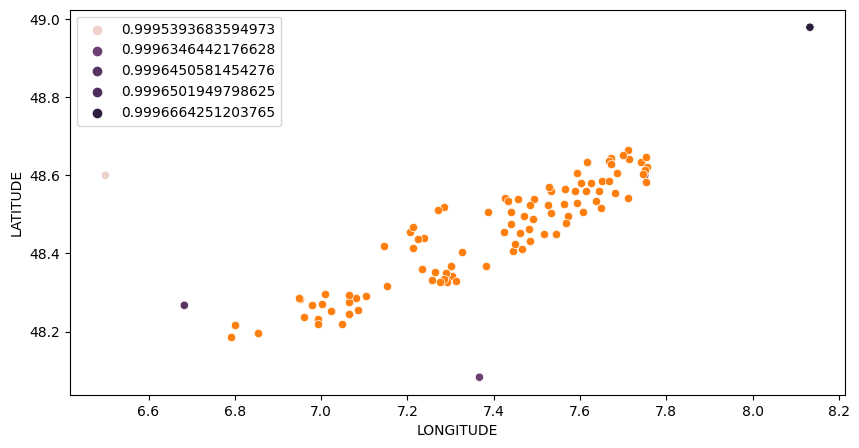

In [11]:
most_probable_bin = dflogit.sort_values('predict_proba', ascending=False).loc[:,['LATITUDE','LONGITUDE','predict_proba']].iloc[0:5,:]
# scatter plot
plt.figure(figsize=(10,5))
sns.scatterplot(data=most_probable_bin,x='LONGITUDE',y='LATITUDE',hue='predict_proba')
sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE')

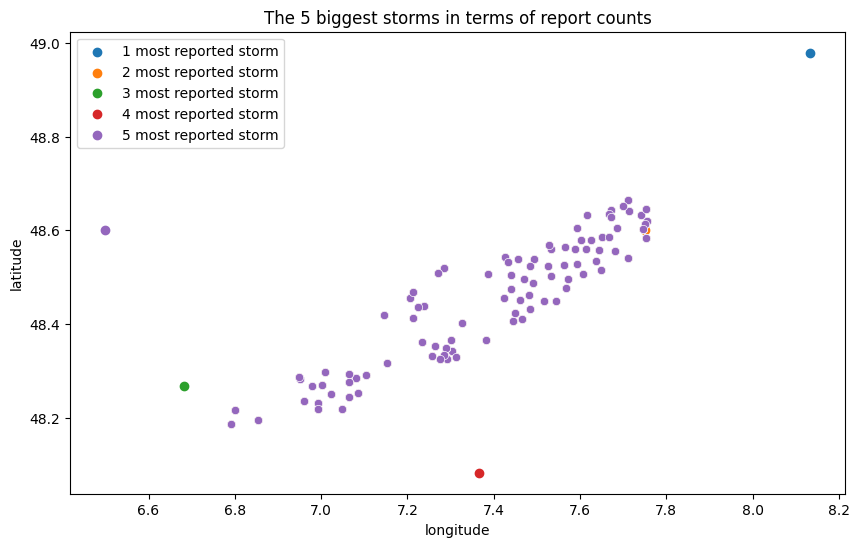

In [28]:
most_probable_bin = dflogit.sort_values('predict_proba', ascending=False).loc[:,['LATITUDE','LONGITUDE','predict_proba', 'TIME_EVENT']].iloc[0:5,:]
plt.figure(figsize=(10,6))
for i in range(most_probable_bin.shape[0]):
        a = most_probable_bin.iloc[i,1]
        b = most_probable_bin.iloc[i,0]
        #lab = df_biggest.loc[df_biggest.LABELS == labels_biggest_storms[i]]
        plt.scatter(a, b, c='C{}'.format(i), label='{} most reported storm'.format(i+1))
        sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE')

plt.ylabel('latitude')
plt.xlabel('longitude')
plt.legend()
plt.title("The {} biggest storms in terms of report counts".format(len(most_probable_bin)))
plt.show()

In [37]:
most_probable_bin = dflogit.sort_values('predict_proba', ascending=False).loc[:,['LATITUDE','LONGITUDE','predict_proba','TIME_EVENT']].iloc[:,:]

In [40]:
most_probable_bin_date = convert_timestamps_to_date(most_probable_bin)

In [46]:
most_probable_bin_date.sort_values('TIME_EVENT',ascending=False).iloc[35:60,:]

,LATITUDE,LONGITUDE,predict_proba,TIME_EVENT
363,46.567,3.350,0.001803,2022-08-04 17:58:00.000000000
364,46.400,3.317,0.001587,2022-08-04 17:26:00.000000256
365,42.583,2.117,0.000018,2022-08-04 13:45:00.000000000
366,48.041,7.544,0.967674,2022-07-20 16:30:00.000000000
471,45.285,4.395,0.009551,2022-07-03 15:18:59.999999744
505,45.467,4.500,0.012390,2022-06-30 14:15:00.000000000
514,47.350,6.800,0.820285,2022-06-30 13:51:59.999999744
524,45.250,4.100,0.005038,2022-06-30 13:31:00.000000000
548,43.167,6.033,0.091257,2022-06-28 10:35:00.000000000
675,47.513,6.517,0.732294,2022-06-26 20:12:00.000000000


In [47]:
cluster.sort_values('LATITUDE')

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,0,1,2,3,...,411,412,413,414,415,416,417,418,419,420
784,48.186,6.791,2022-06-26 18:47:00.000000000,3.00,28.13,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
782,48.195,6.853,2022-06-26 18:50:00.000000000,2.50,29.02,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
785,48.217,6.800,2022-06-26 18:47:00.000000000,3.50,45.16,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
619,48.219,7.049,2022-06-26 20:42:00.000000000,3.25,29.46,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
779,48.220,6.993,2022-06-26 19:00:00.000000000,3.00,47.33,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
665,48.641,7.714,2022-06-26 20:18:59.999999744,3.00,1165.53,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
670,48.644,7.673,2022-06-26 20:18:00.000000000,2.00,272.35,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
661,48.646,7.753,2022-06-26 20:21:59.999999744,4.50,578.98,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
667,48.651,7.699,2022-06-26 20:18:59.999999744,2.00,509.27,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


need to add explanatory variables

In [ ]:
need to t

other algorithm (svm, rf)

In [ ]:

# now without max hail diameter

def logit_pred_noNA(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    x = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]
    x

    # define weight hyperparameter
    w = [{0:1000,1:100},{0:1000,1:10}, {0:1000,1:1.0}, 
        {0:500,1:1.0}, {0:400,1:1.0}, {0:300,1:1.0}, {0:200,1:1.0}, 
        {0:150,1:1.0}, {0:100,1:1.0}, {0:99,1:1.0}, {0:10,1:1.0}, 
        {0:0.01,1:1.0}, {0:0.01,1:10}, {0:0.01,1:100}, 
        {0:0.001,1:1.0}, {0:0.005,1:1.0}, {0:1.0,1:1.0}, 
        {0:1.0,1:0.1}, {0:10,1:0.1}, {0:100,1:0.1}, 
        {0:10,1:0.01}, {0:1.0,1:0.01}, {0:1.0,1:0.001}, {0:1.0,1:0.005}, 
        {0:1.0,1:10}, {0:1.0,1:99}, {0:1.0,1:100}, {0:1.0,1:150}, 
        {0:1.0,1:200}, {0:1.0,1:300},{0:1.0,1:400},{0:1.0,1:500}, 
        {0:1.0,1:1000}, {0:10,1:1000},{0:100,1:1000} ]
    hyperparam_grid = {"class_weight": w }

    # define model
    lg3 = LogisticRegression(random_state=13)
    # define evaluation procedure
    grid = GridSearchCV(lg3,hyperparam_grid,scoring="roc_auc", cv=100, n_jobs=-1, refit=True)
    grid.fit(x,y)
    print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

    # confusion matrix of train-test
    # train-test split
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=13)

    # define model
    lg3 = LogisticRegression(random_state=13, class_weight={0: 1.0, 1: 99})
    # fit it
    lg3.fit(X_train,y_train)
    # test
    y_pred = lg3.predict(X_test)
    # performance
    print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
    print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
    print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
    print(f'Recall score: {recall_score(y_test,y_pred)}')

    # bin reports to predict if they belong to the current cluster
    dflogit = df_mainland_fr.copy()
    dflogit = dflogit.drop(columns=['COUNTRY','PLACE'])
    dflogit = dflogit[dflogit["LABEL"]==-1]
    dflogit = dflogit.dropna()
    x_test = dflogit[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    # define model
    logit = LogisticRegression(random_state=13, class_weight= grid.best_params_['class_weight'])
    # fit it
    logit.fit(x,y)
    # test
    y_pred = logit.predict(x_test)

    # proportion of bin cluster assigned to biggest cluster
    prop_bin_to_cluster = y_pred.sum()/y_pred.shape[0]
    print("The proportion of the bin cluster assigned to cluster:",prop_bin_to_cluster)

    # stats
    predict_proba = logit.predict_proba(x_test) 
    score = logit.score(x,y)
    params = logit.get_params()
    print('The probabilites are:',predict_proba)
    print('Score =',score)
    print('Parameters=',params)

    dflogit["y_pred"] = y_pred
    dflogit["predict_proba"] = predict_proba[:,1]
    cluster = df_no_max_hail[df_no_max_hail["LABEL"]==which_cluster]
    # scatter plot
    plt.figure(figsize=(10,5))
    sns.scatterplot(data=dflogit,x='LONGITUDE',y='LATITUDE',hue='y_pred')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')

    return dflogit, cluster


In [52]:
from numpy import mean
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import RandomForestClassifier

In [114]:

def rf0(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    x = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = .25, random_state = 18)

    clf = RandomForestClassifier(n_estimators = 500, max_depth = 4, max_features = 3, bootstrap = True, random_state = 18).fit(x_train, y_train)

    # Create our predictions
    prediction = clf.predict(x_test)
    # Create confusion matrix
    from sklearn.metrics import confusion_matrix, f1_score, accuracy_score
    confusion_matrix = confusion_matrix(y_test, prediction)
    # Display accuracy score
    accuracy_score = accuracy_score(y_test, prediction)
    # Display F1 score
    f1_score = f1_score(y_test,prediction)

    print(confusion_matrix,accuracy_score,f1_score)

In [115]:
rf0(dfreg,68)

[[645   0]
 [  1  22]] 0.9985029940119761 0.9777777777777777


In [126]:
dflogit = df_mainland_fr.copy()
dflogit = dflogit.drop(columns=['COUNTRY','PLACE','MAX_HAIL_DIAMETER'])
X_pred = dflogit[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]
dfbin = dflogit[dflogit["LABEL"]==-1]
X_pred


,LATITUDE,LONGITUDE,TIME_EVENT,dens_pop
0,45.567,5.933,462946.250000,2802.91
1,45.567,5.933,452126.750000,2802.91
2,45.596,5.875,462945.866667,399.73
3,49.583,1.358,462928.500000,27.09
4,49.583,1.358,462928.500000,107.41
...,...,...,...,...
3233,47.917,-3.333,380726.000000,85.04
3234,47.983,6.750,379861.250000,63.15
3235,47.933,6.667,379861.083333,77.45
3236,44.883,0.533,379827.500000,110.95


In [136]:
t = [1,2]
pd.DataFrame(t)

,0
0,1
1,2


In [172]:

def rf0_pred(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = .5, random_state = 1)

    clf = RandomForestClassifier(n_estimators = 500, max_depth = 4, max_features = 3, bootstrap = True, random_state = 18).fit(x_train, y_train)

    # Create our predictions
    prediction = clf.predict(x_test)
    # Create confusion matrix
    from sklearn.metrics import confusion_matrix, f1_score, accuracy_score
    confusion_matrix = confusion_matrix(y_test, prediction)
    # Display accuracy score
    accuracy_score = accuracy_score(y_test, prediction)
    # Display F1 score
    f1_score = f1_score(y_test,prediction)
    print(confusion_matrix,accuracy_score,f1_score)
        
    #plot
    df_test = x_test.copy()
    df_test["prediction"] = prediction
    cluster = df_no_max_hail[df_no_max_hail["LABEL"]==which_cluster]

    plt.figure(figsize=(10,5))
    sns.scatterplot(data=df_test,x='LONGITUDE',y='LATITUDE',hue='prediction')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')

    #plot
    predict_proba = clf.predict_proba(x_test) 
    df_test["predict_proba"] = predict_proba[:,1]
    most_probable_bin = df_test.sort_values('predict_proba', ascending=False).loc[:,['LATITUDE','LONGITUDE','predict_proba', 'TIME_EVENT']].iloc[0:5,:]
    
    plt.figure(figsize=(10,6))
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE')
    for i in range(most_probable_bin.shape[0]):
            a = most_probable_bin.iloc[i,1]
            b = most_probable_bin.iloc[i,0]
            #lab = df_biggest.loc[df_biggest.LABELS == labels_biggest_storms[i]]
            plt.scatter(a, b, c='C{}'.format(i), label='{} most likely report'.format(i+1))

    plt.ylabel('latitude')
    plt.xlabel('longitude')
    plt.legend()
    plt.title("The {} reports that are most likely belonging to cluster".format(len(most_probable_bin)))
    plt.show()
    
    # bin reports to predict if they belong to the current cluster
    dflogit = df_mainland_fr.copy()
    dflogit = dflogit.drop(columns=['COUNTRY','PLACE'])
    dflogit = dflogit[dflogit["LABEL"]==-1]
    dflogit = dflogit.dropna()
    X_pred = dflogit[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    # define model
    clf = RandomForestClassifier(n_estimators = 500, max_depth = 4, max_features = 3, bootstrap = True, random_state = 18).fit(X, y)
    # test
    y_pred = clf.predict(X_pred)

    # proportion of bin cluster assigned to biggest cluster
    prop_bin_to_cluster = y_pred.sum()/y_pred.shape[0]
    print("The proportion of the bin cluster assigned to cluster:",prop_bin_to_cluster)

    # stats
    predict_proba = clf.predict_proba(X_pred) 

    dflogit["y_pred"] = y_pred
    dflogit["predict_proba"] = predict_proba[:,1]
    cluster = df_no_max_hail[df_no_max_hail["LABEL"]==which_cluster]
    # scatter plot
    plt.figure(figsize=(10,5))
    sns.scatterplot(data=dflogit,x='LONGITUDE',y='LATITUDE',hue='y_pred')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')

    #plot
    
    #plot
    predict_proba = clf.predict_proba(X_pred) 
    dflogit["y_pred"] = y_pred
    dflogit["predict_proba"] = predict_proba[:,1]
    most_probable_bin = dflogit.sort_values('predict_proba', ascending=False).loc[:,['LATITUDE','LONGITUDE','predict_proba', 'TIME_EVENT']].iloc[0:5,:]
    
    plt.figure(figsize=(10,6))
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE')
    for i in range(most_probable_bin.shape[0]):
            a = most_probable_bin.iloc[i,1]
            b = most_probable_bin.iloc[i,0]
            #lab = df_biggest.loc[df_biggest.LABELS == labels_biggest_storms[i]]
            plt.scatter(a, b, c='C{}'.format(i), label='{} most likely report'.format(i+1))

    plt.ylabel('latitude')
    plt.xlabel('longitude')
    plt.legend()
    plt.title("The {} reports that are most likely belonging to cluster".format(len(most_probable_bin)))
    plt.show()


    return dflogit, cluster


[[1285    0]
 [   4   47]] 0.9970059880239521 0.9591836734693878


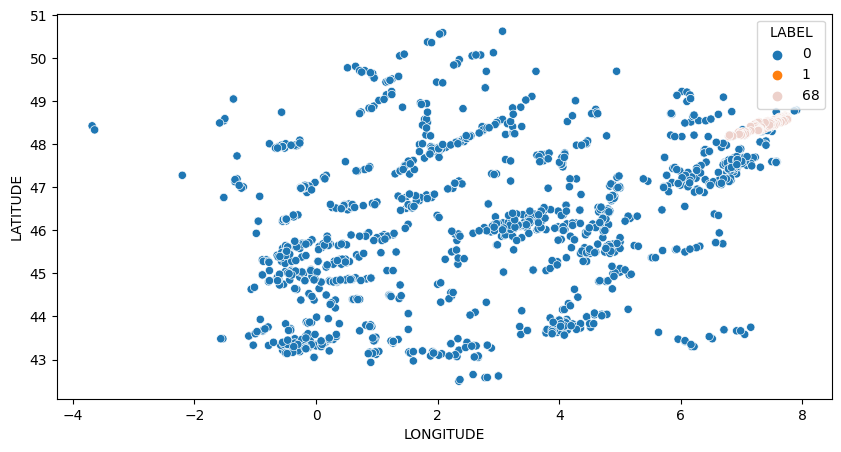

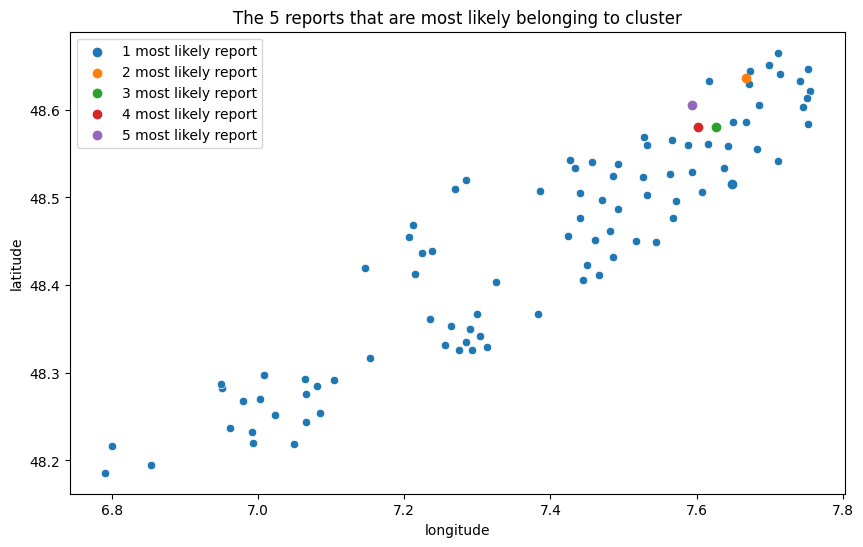

The proportion of the bin cluster assigned to cluster: 0.0027548209366391185


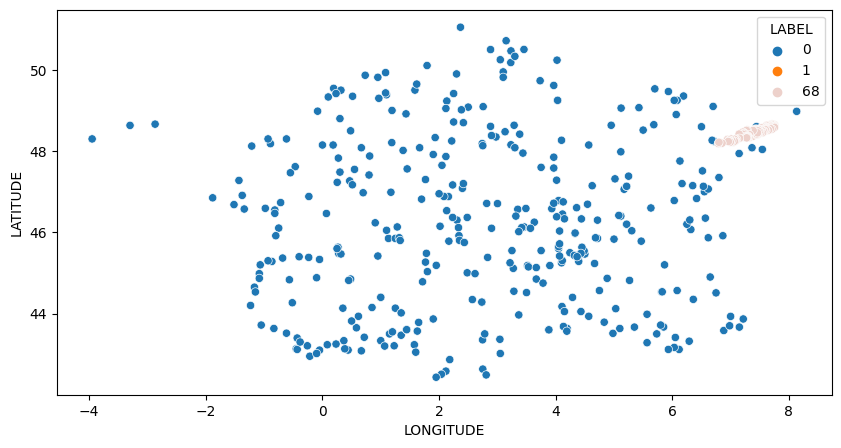

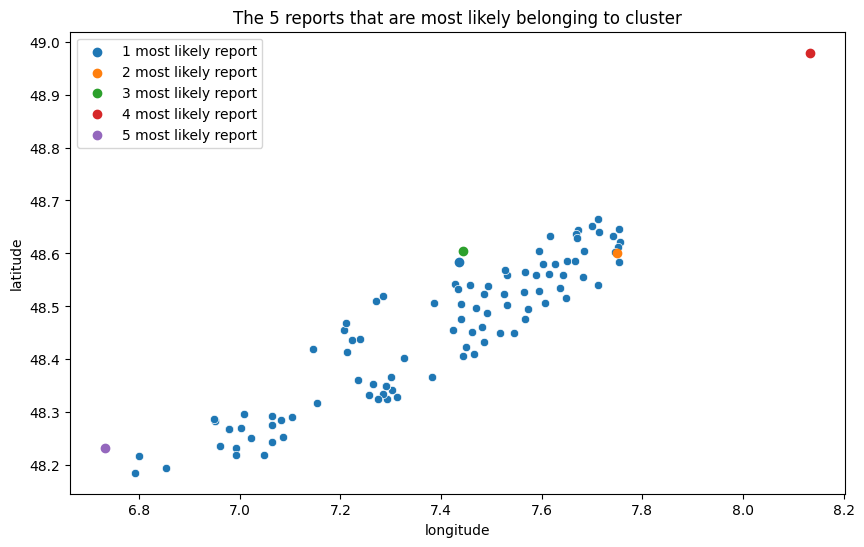

In [173]:
nb68_dflogit, nb68_cluster = rf0_pred(dfreg,68)

In [165]:
nb68_dflogit = convert_timestamps_to_date(nb68_dflogit)

In [166]:
nb68_dflogit[nb68_dflogit['y_pred']==1] # only one assigned to cluster 68 

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,y_pred,predict_proba
1509,48.584,7.436,2022-06-05 00:10:00,2.0,65.13,-1,1,0.937042


In [ ]:
nb68_cluster = convert_timestamps_to_date(nb68_cluster)

In [169]:
nb68_cluster # so not likely to belong to cluster 68 as too far in time 

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,0,1,2,3,...,411,412,413,414,415,416,417,418,419,420
368,48.462,7.481,2022-06-26 19:47:00.000000000,3.50,440.95,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
370,48.456,7.424,2022-06-26 19:44:00.000000000,3.00,53.41,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
379,48.476,7.440,2022-06-26 19:45:00.000000000,2.50,104.40,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
383,48.367,7.383,2022-06-26 19:38:00.000000256,4.25,60.20,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
389,48.342,7.303,2022-06-26 19:25:00.000000000,5.00,640.14,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,48.220,6.993,2022-06-26 19:00:00.000000000,3.00,47.33,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
780,48.237,6.961,2022-06-26 18:58:00.000000000,2.00,142.09,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
782,48.195,6.853,2022-06-26 18:50:00.000000000,2.50,29.02,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
784,48.186,6.791,2022-06-26 18:47:00.000000000,3.00,28.13,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


[[1294    0]
 [   5   37]] 0.9962574850299402 0.9367088607594937


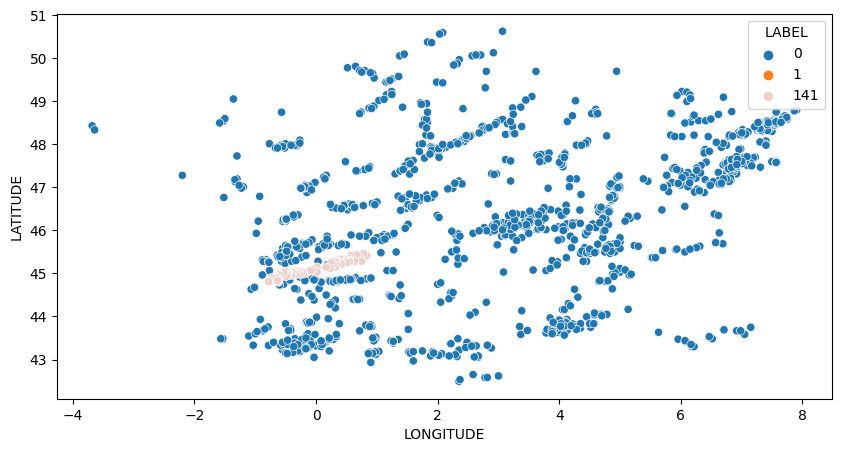

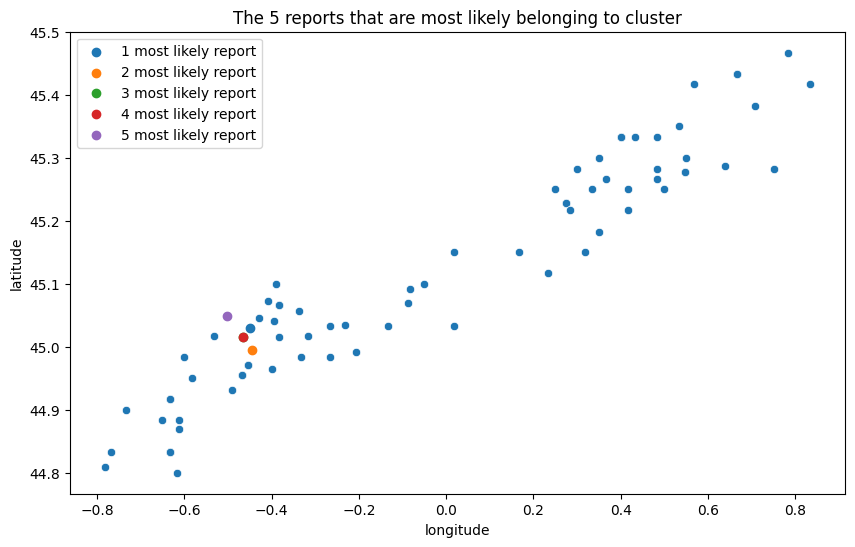

The proportion of the bin cluster assigned to cluster: 0.0027548209366391185


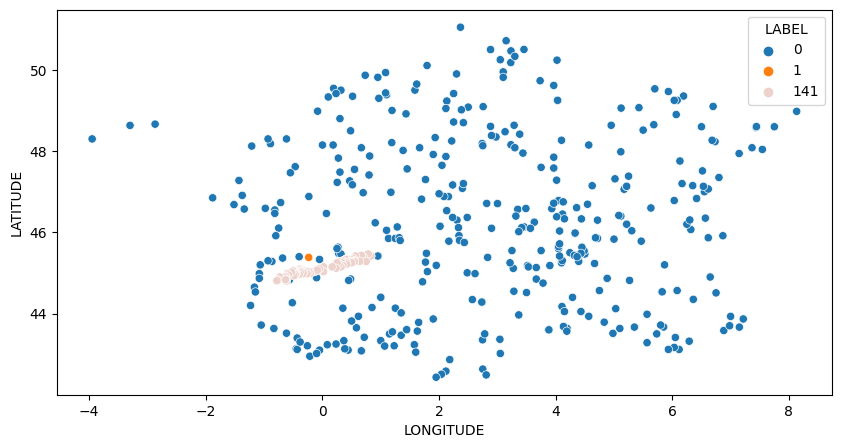

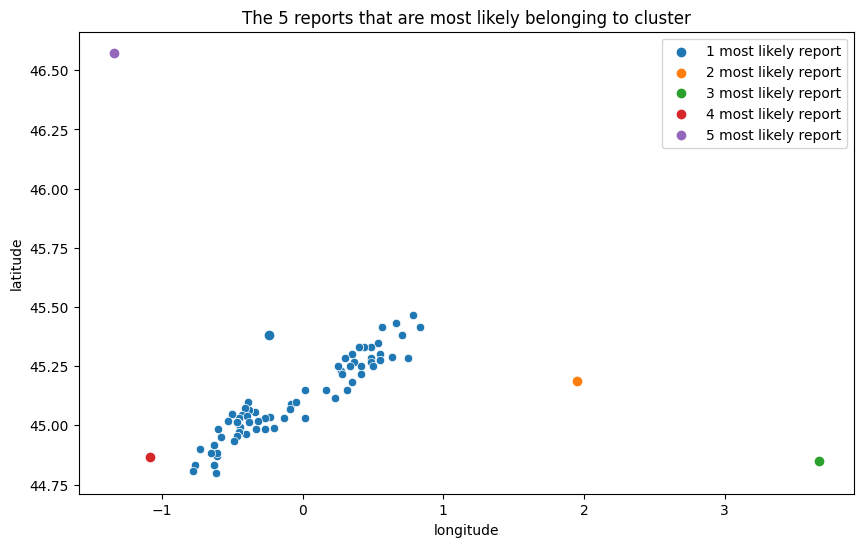

In [175]:
nb141_dflogit, nb141_cluster = rf0_pred(dfreg,141)

In [176]:
nb141_dflogit = convert_timestamps_to_date(nb141_dflogit)
nb141_dflogit[nb141_dflogit['y_pred']==1] # only one assigned to cluster 68 

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,y_pred,predict_proba
1197,45.383,-0.236,2022-06-20 19:06:59.999999744,2.0,39.65,-1,1,0.899285


In [177]:

nb141_cluster = convert_timestamps_to_date(nb68_cluster)
nb141_cluster # so not likely to belong to cluster 68 as too far in time 

,LATITUDE,LONGITUDE,TIME_EVENT,MAX_HAIL_DIAMETER,dens_pop,LABEL,0,1,2,3,...,411,412,413,414,415,416,417,418,419,420
368,48.462,7.481,2022-06-26 19:47:00.000000000,3.50,440.95,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
370,48.456,7.424,2022-06-26 19:44:00.000000000,3.00,53.41,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
379,48.476,7.440,2022-06-26 19:45:00.000000000,2.50,104.40,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
383,48.367,7.383,2022-06-26 19:38:00.000000256,4.25,60.20,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
389,48.342,7.303,2022-06-26 19:25:00.000000000,5.00,640.14,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,48.220,6.993,2022-06-26 19:00:00.000000000,3.00,47.33,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
780,48.237,6.961,2022-06-26 18:58:00.000000000,2.00,142.09,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
782,48.195,6.853,2022-06-26 18:50:00.000000000,2.50,29.02,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
784,48.186,6.791,2022-06-26 18:47:00.000000000,3.00,28.13,68,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


[[1293    0]
 [   9   34]] 0.9932634730538922 0.8831168831168831


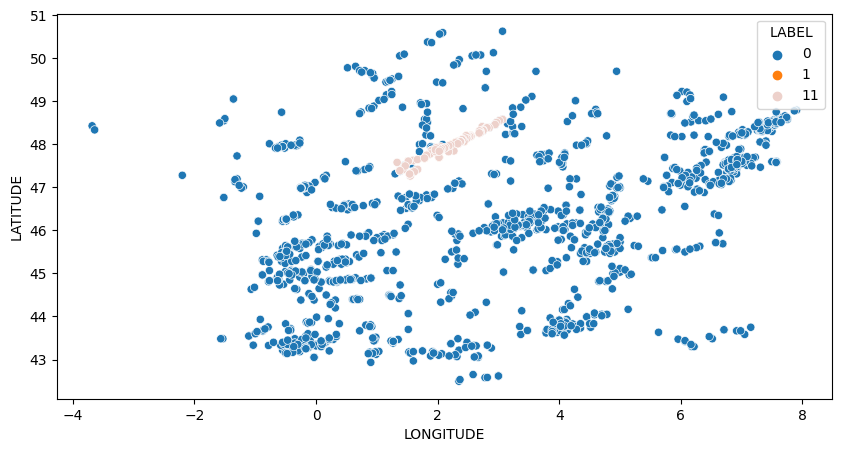

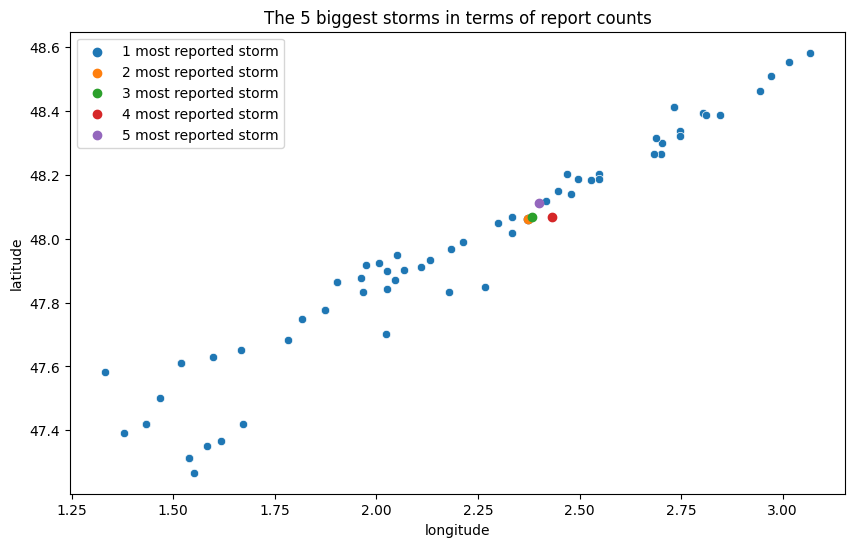

The proportion of the bin cluster assigned to cluster: 0.0


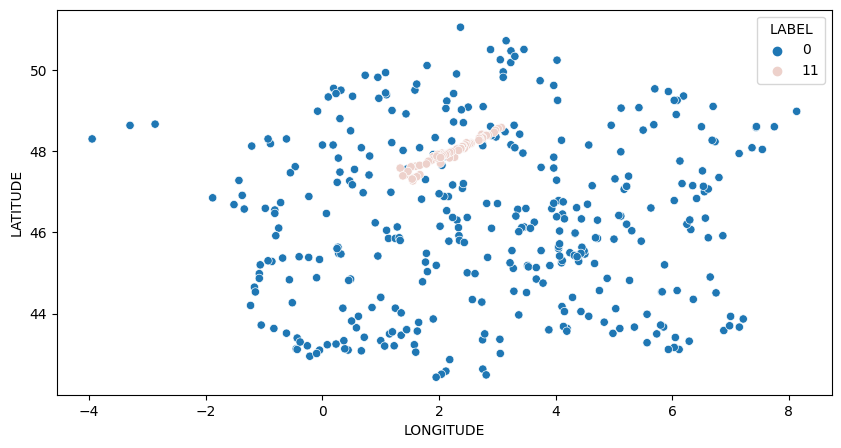

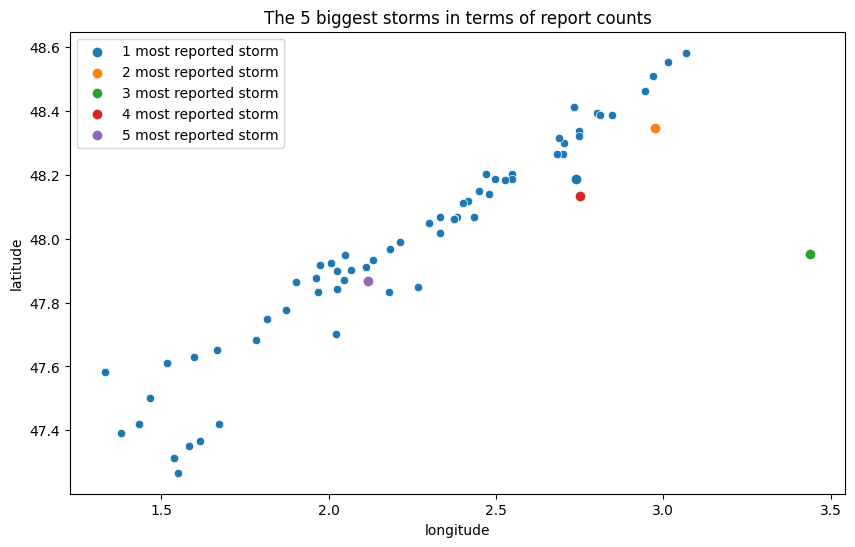

(      LATITUDE  LONGITUDE     TIME_EVENT  MAX_HAIL_DIAMETER  dens_pop  LABEL  \
 6       48.333      1.933  462926.783333                7.0    144.14     -1   
 33      49.900      2.300  398197.666667                2.0   2707.06     -1   
 39      49.502      1.586  462927.050000                3.0     18.23     -1   
 42      48.500      0.483  462926.500000                2.5     25.59     -1   
 58      48.183     -0.892  462924.166667                2.0     70.29     -1   
 ...        ...        ...            ...                ...       ...    ...   
 3221    48.133      2.750  380955.000000                5.0    138.19     -1   
 3224    46.467     -0.817  380953.000000                3.0    390.66     -1   
 3226    48.083      0.667  380953.000000                4.0     33.32     -1   
 3229    45.917     -0.800  380952.833333                3.5     33.78     -1   
 3237    47.850      3.967  379827.000000                2.0     76.85     -1   
 
       y_pred  predict_pro

In [157]:
rf0_pred(dfreg,11)

In [88]:

def rf1(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    # define model
    model = RandomForestClassifier(n_estimators=10)

    # define evaluation procedure
    cv = RepeatedStratifiedKFold(n_splits=15, n_repeats=100, random_state=1)
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
    # summarize performance
    print('Mean ROC AUC: %.3f' % mean(scores))

In [89]:
rf1(dfreg,68)

Mean ROC AUC: 0.999


In [72]:

def rf2(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = .25, random_state = 18)

    # define model
    model = RandomForestClassifier(n_estimators=10, class_weight='balanced')

    # define evaluation procedure
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
    # summarize performance
    print('Mean ROC AUC: %.3f' % mean(scores))

In [70]:
rf2(dfreg,68)

Mean ROC AUC: 0.998


In [78]:
!pip install imblearn

     -------------------------------------- 226.0/226.0 kB 3.5 MB/s eta 0:00:00



[notice] A new release of pip available: 22.3.1 -> 23.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [79]:
from imblearn.ensemble import BalancedRandomForestClassifier

In [80]:
def rf3(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = .25, random_state = 18)

    # define model
    model = BalancedRandomForestClassifier(n_estimators=10)
    # define evaluation procedure
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # evaluate model
    scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
    # summarize performance
    print('Mean ROC AUC: %.3f' % mean(scores))

In [81]:
rf3(dfreg,68)

Mean ROC AUC: 1.000


In [102]:
def rf5(dfreg,which_cluster):
    #Importing essential libraries
    import matplotlib.pyplot as plt
    from statistics import mean
    from matplotlib import pyplot
    from sklearn.model_selection import train_test_split
    from sklearn.model_selection import cross_validate
    from sklearn.model_selection import RepeatedStratifiedKFold
    from imblearn.ensemble import BalancedRandomForestClassifier


    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]


    #Build SRF model
    BRFC = BalancedRandomForestClassifier(n_estimators=150, random_state=2)
    #Create Stratified K-fold cross validation
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    scoring = ('f1', 'recall', 'precision')
    #Evaluate BRFC model
    scores = cross_validate(BRFC, X, y, scoring=scoring, cv=cv)
    #Get average evaluation metrics
    print('Mean f1: %.3f' % mean(scores['test_f1']))
    print('Mean recall: %.3f' % mean(scores['test_recall']))
    print('Mean precision: %.3f' % mean(scores['test_precision']))

    #Randomly spilt dataset to test and train set
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, stratify=y)
    #Train BRFC
    BRFC.fit(X_train, y_train)
    #BRFC prediction result
    y_pred = BRFC.predict(X_test)
    #Create confusion matrix
    confusion_mat = confusion_matrix(y_test, y_pred)
    print(confusion_mat)

In [103]:
rf5(dfreg,68)

Mean f1: 0.860
Mean recall: 1.000
Mean precision: 0.761
[[258   0]
 [  0  10]]


In [108]:
def rf6(dfreg,which_cluster):
    #Importing essential libraries
    import matplotlib.pyplot as plt
    from statistics import mean
    from matplotlib import pyplot
    from sklearn.model_selection import train_test_split
    from sklearn.model_selection import cross_validate
    from sklearn.model_selection import RepeatedStratifiedKFold
    from sklearn.ensemble import RandomForestClassifier
    from imblearn.over_sampling import SMOTE

    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    #Use SMOTE to oversample the minority class
    oversample = SMOTE()
    over_X, over_y = oversample.fit_resample(X, y)
    over_X_train, over_X_test, over_y_train, over_y_test = train_test_split(over_X, over_y, test_size=0.1, stratify=over_y)
    #Build SMOTE SRF model
    SMOTE_SRF = RandomForestClassifier(n_estimators=150, random_state=0)
    #Create Stratified K-fold cross validation
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    scoring = ('f1', 'recall', 'precision')
    #Evaluate SMOTE SRF model
    scores = cross_validate(SMOTE_SRF, over_X, over_y, scoring=scoring, cv=cv)
    #Get average evaluation metrics
    print('Mean f1: %.3f' % mean(scores['test_f1']))
    print('Mean recall: %.3f' % mean(scores['test_recall']))
    print('Mean precision: %.3f' % mean(scores['test_precision']))

    #Randomly spilt dataset to test and train set
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, stratify=y)
    #Train SMOTE SRF
    SMOTE_SRF.fit(over_X_train, over_y_train)
    #SMOTE SRF prediction result
    y_pred = SMOTE_SRF.predict(X_test)
    #Create confusion matrix
    confusion_mat = confusion_matrix(y_test, y_pred)
    print(confusion_mat)

In [113]:
rf6(dfreg,141)

Mean f1: 1.000
Mean recall: 1.000
Mean precision: 1.000
[[259   0]
 [  0   9]]


In [ ]:
def rf_test0(dfreg,which_cluster):
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    X = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    #Train SMOTE SRF
    SMOTE_SRF.fit(X, y)
    #SMOTE SRF prediction result
    y_pred = SMOTE_SRF.predict(X)
    #Create confusion matrix

    # proportion of bin cluster assigned to biggest cluster
    prop_bin_to_cluster = y_pred.sum()/y_pred.shape[0]
    print("The proportion of the bin cluster assigned to cluster:",prop_bin_to_cluster)

    # stats
    predict_proba = clf.predict_proba(x_test) 
    score = clf.score(x,y)
    params = clf.get_params()
    print('The probabilites are:',predict_proba)
    print('Score =',score)
    print('Parameters=',params)

    dflogit["y_pred"] = y_pred
    dflogit["predict_proba"] = predict_proba[:,1]
    cluster = df_max_hail[df_max_hail["LABEL"]==which_cluster]
    # scatter plot
    plt.figure(figsize=(10,5))
    sns.scatterplot(data=dflogit,x='LONGITUDE',y='LATITUDE',hue='y_pred')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')


In [19]:
# now without max hail diameter

def rf_pred_noMaxHail(dfreg, which_cluster):

    """
    Most report storms and proportion of total sample are
    68     0.031496
    141    0.026772
    11     0.023622
    90     0.022047
    144    0.017638
    """

    #data, NOT using max hail diameter but to be replaced by radar
    
    df_no_max_hail = dfreg.copy()
    y = df_no_max_hail.loc[:,which_cluster]
    x = df_no_max_hail[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = .25, random_state = 18)

    clf = RandomForestClassifier(n_estimators = 500, max_depth = 4, max_features = 3, bootstrap = True, random_state = 18).fit(x_train, y_train)

    # Create our predictions
    prediction = clf.predict(x_test)
    # Create confusion matrix
    from sklearn.metrics import confusion_matrix, f1_score, accuracy_score
    confusion_matrix(y_test, prediction)
    # Display accuracy score
    accuracy_score(y_test, prediction)
    # Display F1 score
    f1_score(y_test,prediction)


    # bin reports to predict if they belong to the current cluster
    dflogit = df_mainland_fr.copy()
    dflogit = dflogit.drop(columns=['COUNTRY','PLACE','MAX_HAIL_DIAMETER'])
    dflogit = dflogit[dflogit["LABEL"]==-1]
    dflogit = dflogit.dropna()
    x_test = dflogit[["LATITUDE","LONGITUDE","TIME_EVENT","dens_pop"]]

    # define model
    clf = RandomForestClassifier(n_estimators = 500, max_depth = 4, max_features = 3, bootstrap = True, random_state = 18).fit(x_train, y_train)
    prediction = clf.predict(x_test)
    y_pred = prediction

    # proportion of bin cluster assigned to biggest cluster
    prop_bin_to_cluster = y_pred.sum()/y_pred.shape[0]
    print("The proportion of the bin cluster assigned to cluster:",prop_bin_to_cluster)

    # stats
    predict_proba = clf.predict_proba(x_test) 
    score = clf.score(x,y)
    params = clf.get_params()
    print('The probabilites are:',predict_proba)
    print('Score =',score)
    print('Parameters=',params)

    dflogit["y_pred"] = y_pred
    dflogit["predict_proba"] = predict_proba[:,1]
    cluster = df_max_hail[df_max_hail["LABEL"]==which_cluster]
    # scatter plot
    plt.figure(figsize=(10,5))
    sns.scatterplot(data=dflogit,x='LONGITUDE',y='LATITUDE',hue='y_pred')
    sns.scatterplot(data=cluster,x='LONGITUDE',y='LATITUDE',hue='LABEL')

    return dflogit, cluster

In [20]:
svm_pred_noNA(dfreg, 68)

Best score: 0.8844 with param: {'class_weight': {0: 1.0, 1: 10}}
Accuracy Score: 0.9551122194513716
Confusion Matrix: 
[[766   0]
 [ 36   0]]
Area Under Curve: 0.5
Recall score: 0.0


InvalidIndexError: (slice(None, None, None), 'LONGITUDE')

Multi-class classification with -1 cluster

PLOTTING

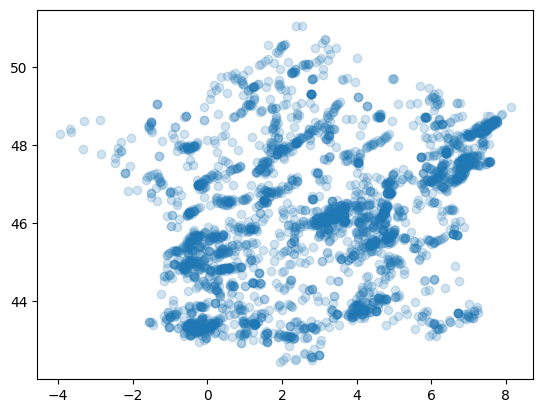

In [119]:
# plotting reports to guess size of grid
plt.scatter(df_mainland_fr.LONGITUDE, df_mainland_fr.LATITUDE, alpha=0.2)
plt.show()
# go with squares of 0.5 degrees-sides 

In [30]:
# extending end lon and end lat
latgrid = np.arange(42.433,51.5,0.5)
longrid = np.arange(-3.95,8.6,0.5)
grid_size = latgrid.shape[0]*longrid.shape[0]
print(grid_size)
print(latgrid.shape[0], longrid.shape[0])

494
19 26


In [31]:
lat_for_grid = df_mainland_fr.loc[:,'LATITUDE']
lon_for_grid = df_mainland_fr.loc[:,'LONGITUDE']
lat_for_grid = pd.qcut(lat_for_grid, 19, labels=np.arange(1,20))
lon_for_grid = pd.qcut(lon_for_grid, 26, labels=np.arange(1,27))
lat_for_grid

0        8
1        8
2        8
3       19
4       19
        ..
3233    16
3234    16
3235    16
3236     6
3237    16
Name: LATITUDE, Length: 3238, dtype: category
Categories (19, int64): [1 < 2 < 3 < 4 ... 16 < 17 < 18 < 19]

In [32]:
df_mainland_fr['LAT_CAT'] = lat_for_grid
df_mainland_fr['LON_CAT'] = lon_for_grid
df_mainland_fr

,LATITUDE,LONGITUDE,TIME_EVENT,COUNTRY,YEAR,MONTH,HOUR,PLACE,dens_pop,LAT_CAT,LON_CAT
0,45.567,5.933,462946.250000,FR,2022,10,10,Chambéry,2802.91,8,22
1,45.567,5.933,452126.750000,FR,2021,7,14,Chambéry,2802.91,8,22
2,45.596,5.875,462945.866667,FR,2022,10,9,La Motte-Servolex,399.73,8,22
3,49.583,1.358,462928.500000,FR,2022,10,16,Buchy,27.09,19,9
4,49.583,1.358,462928.500000,FR,2022,10,16,Buchy,107.41,19,9
...,...,...,...,...,...,...,...,...,...,...,...
3233,47.917,-3.333,380726.000000,FR,2013,6,14,Plouay,85.04,16,1
3234,47.983,6.750,379861.250000,FR,2013,5,13,Basse-sur-le-Rupt,63.15,16,24
3235,47.933,6.667,379861.083333,FR,2013,5,13,Rupt-sur-Moselle,77.45,16,24
3236,44.883,0.533,379827.500000,FR,2013,5,3,Lembras,110.95,6,7


In [30]:
df_mainland_fr.to_csv("C:/Users/t480/statappradar/df_mainland_fr.csv")

In [ ]:
# regression options
# y = number of reports in each box
# nb of reports in lat_cat
# report is in cat_lat 0,1
# report is in box 1, box 2, 
# nb reports in each city : first reg y = number in chambery, 

# obj
# predict for communes where we do not have reports the expected number of reports  

In [ ]:
!pip install statsmodels

     ---------------------------------------- 9.1/9.1 MB 2.7 MB/s eta 0:00:00
     -------------------------------------- 233.8/233.8 kB 4.8 MB/s eta 0:00:00


In [34]:
import statsmodels.api as sm

In [36]:
df_regression = pd.read_csv("C:/Users/t480/statappradar/df_cluster.csv")
df_regression

,Unnamed: 0.1,Unnamed: 0,LATITUDE,LONGITUDE,TIME_EVENT,COUNTRY,YEAR,MONTH,HOUR,PLACE,dens_pop,LAT_CAT,LON_CAT,LABEL
0,0,0,45.567,5.933,462946.250000,FR,2022,10,10,Chambéry,2802.91,8,22,0
1,1,1,45.567,5.933,452126.750000,FR,2021,7,14,Chambéry,2802.91,8,22,1
2,2,2,45.596,5.875,462945.866667,FR,2022,10,9,La Motte-Servolex,399.73,8,22,0
3,3,3,49.583,1.358,462928.500000,FR,2022,10,16,Buchy,27.09,19,9,2
4,4,4,49.583,1.358,462928.500000,FR,2022,10,16,Buchy,107.41,19,9,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3233,3233,3233,47.917,-3.333,380726.000000,FR,2013,6,14,Plouay,85.04,16,1,-1
3234,3234,3234,47.983,6.750,379861.250000,FR,2013,5,13,Basse-sur-le-Rupt,63.15,16,24,420
3235,3235,3235,47.933,6.667,379861.083333,FR,2013,5,13,Rupt-sur-Moselle,77.45,16,24,420
3236,3236,3236,44.883,0.533,379827.500000,FR,2013,5,3,Lembras,110.95,6,7,227


In [ ]:
df_regression = df_regression.drop(columns=['Unnamed: 0.1','Unnamed: 0'])
zeros = np.zeros(df_regression.shape[0])
df_regression[df_regression['LABEL']==68]

In [38]:
pd.get_dummies(df_regression['LABEL'])

,-1,0,1,2,3,4,5,6,7,8,...,411,412,413,414,415,416,417,418,419,420
0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3233,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3234,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3235,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3236,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# on ajoute une colonne pour la constante
x_stat = sm.add_constant(x)
# on ajuste le modèle
model = sm.Logit(y, x_stat)
result = model.fit()

PLOTTING GRID

In [ ]:
np.arange(42.433,55.3,0.5)

(26,)

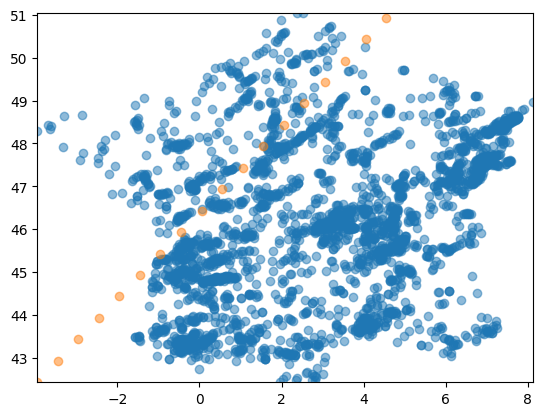

In [ ]:
plt.scatter(df_mainland_fr.LONGITUDE, df_mainland_fr.LATITUDE, alpha=0.5)
plt.xlim(df_mainland_fr.LONGITUDE.min(), df_mainland_fr.LONGITUDE.max())
plt.ylim(df_mainland_fr.LATITUDE.min(), df_mainland_fr.LATITUDE.max())
ax.set_yticks([0.2, 0.6, 0.8], minor=False)
ax.set_yticks([0.3, 0.55, 0.7], minor=True)
plt.show()

In [ ]:
np.random.random((10, 10)).shape

(10, 10)

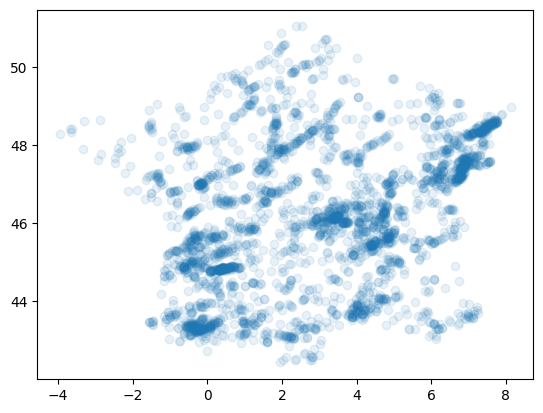

In [ ]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.scatter(df_mainland_fr.LONGITUDE, df_mainland_fr.LATITUDE, alpha=0.1)
plt.show()


def distance(cl1, cl2)
return distance 
puis distance(cl et point)
utiliser densite, si au dela threshold alors sur pas la meme
definir cluster dire si oui ou non dans le meme cluster.
donnee radar aussi 

ensuite mais apres kernel density 


KERNEL DENSITY

In [17]:
def make_data(N, f=0.3, rseed=1):
    rand = np.random.RandomState(rseed)
    x = rand.randn(N)
    x[int(f * N):] += 5
    return x

x = make_data(20)
x_d = np.linspace(-4, 8, 1000)

(-0.02, 0.22)

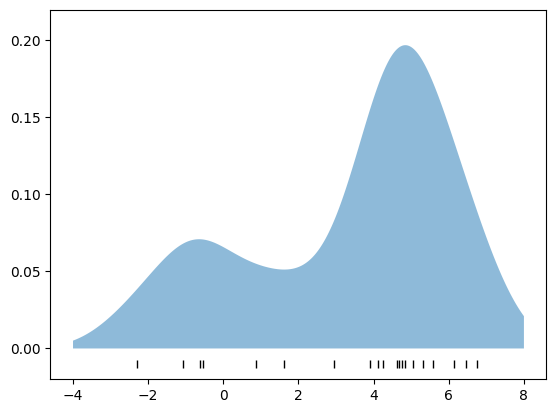

In [18]:
from sklearn.neighbors import KernelDensity

# instantiate and fit the KDE model
kde = KernelDensity(bandwidth=1.0, kernel='gaussian')
kde.fit(x[:, None])

# score_samples returns the log of the probability density
logprob = kde.score_samples(x_d[:, None])

plt.fill_between(x_d, np.exp(logprob), alpha=0.5)
plt.plot(x, np.full_like(x, -0.01), '|k', markeredgewidth=1)
plt.ylim(-0.02, 0.22)

In [1]:
!pip install -U scikit-learn

     ---------------------------------------- 8.2/8.2 MB 6.6 MB/s eta 0:00:00
     ---------------------------------------- 14.8/14.8 MB 6.7 MB/s eta 0:00:00
     ---------------------------------------- 42.2/42.2 MB 6.9 MB/s eta 0:00:00
  Using cached joblib-1.2.0-py3-none-any.whl (297 kB)
  Using cached threadpoolctl-3.1.0-py3-none-any.whl (14 kB)



[notice] A new release of pip available: 22.3 -> 23.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [34]:
import sklearn
from sklearn.model_selection import LeaveOneOut
from sklearn.model_selection import GridSearchCV
from scipy.stats import norm
from sklearn.neighbors import KernelDensity

In [35]:
dffull = df1
dfnobin = df1[df1.LABELS > -1]
dfbin = df1[df1.LABELS == -1]
labelbiggest = df1['LABELS'].value_counts().sort_values(ascending=False).iloc[1:11].index
df10biggest = df1.loc[df1.LABELS.isin(labelbiggest)]
labelsmallest = df1['LABELS'].value_counts().sort_values(ascending=True).iloc[0:110].index
dfsmallest = df1.loc[df1.LABELS.isin(labelsmallest)]


C:\Users\t480\AppData\Local\Temp\ipykernel_21108\1777444512.py:4: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x_latdf[:,np.newaxis]


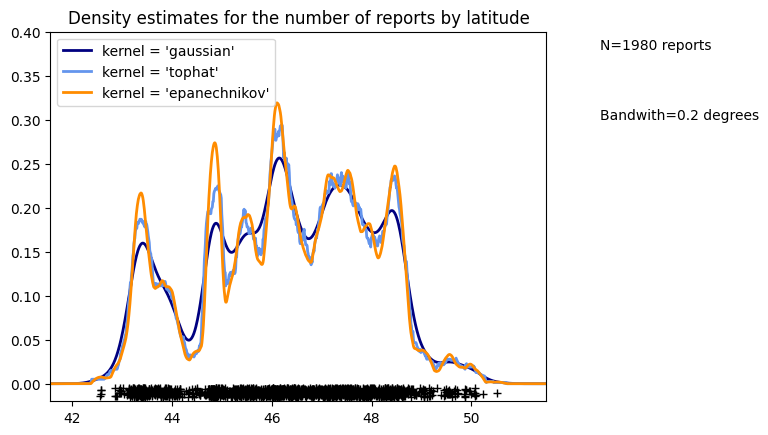

In [13]:
# KDE Latitude

x_latdf = df1.iloc[:,1]
x = x_latdf[:,np.newaxis]
h = 0.2 #0.76

X = x
X_plot = np.linspace(41.567000, 51.503000, 1000)[:, np.newaxis]

fig, ax = plt.subplots()
colors = ["navy", "cornflowerblue", "darkorange"]
kernels = ["gaussian", "tophat", "epanechnikov"]
lw = 2

for color, kernel in zip(colors, kernels):
    kde = KernelDensity(kernel=kernel, bandwidth=h).fit(X)
    log_dens = kde.score_samples(X_plot)
    ax.plot(
        X_plot[:, 0],
        np.exp(log_dens),
        color=color,
        lw=lw,
        linestyle="-",
        label="kernel = '{0}'".format(kernel),
    )

ax.text(52.567000, 0.38, "N={0} reports".format(x_latdf.count()))
ax.text(52.567000, 0.30, "Bandwith={0} degrees".format(h))

ax.set_title("Density estimates for the number of reports by latitude")

ax.legend(loc="upper left")
ax.plot(X[:, 0], -0.005 - 0.01 * np.random.random(X.shape[0]), "+k")

ax.set_xlim(41.567000, 51.503000)
ax.set_ylim(-0.02, 0.4)
plt.show()



C:\Users\t480\AppData\Local\Temp\ipykernel_21108\486726919.py:4: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x_londf[:,np.newaxis]


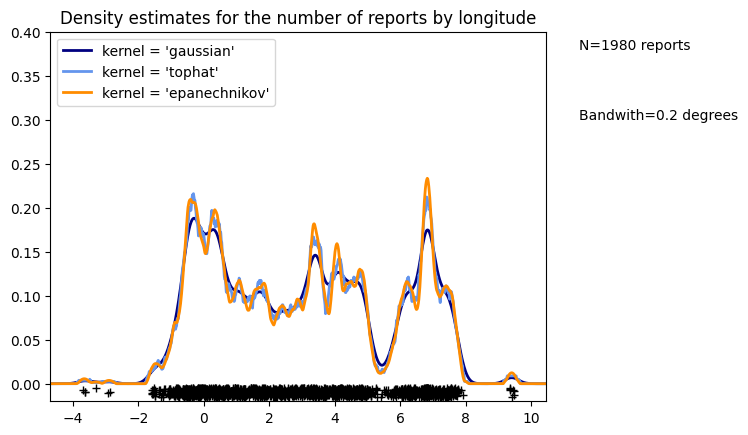

In [14]:
# KDE longitude

x_londf = df1.iloc[:,2]
x = x_londf[:,np.newaxis]
h = 0.2

X = x
X_plot = np.linspace(x.min()-1, x.max()+1, 1000)[:, np.newaxis]

fig, ax = plt.subplots()
colors = ["navy", "cornflowerblue", "darkorange"]
kernels = ["gaussian", "tophat", "epanechnikov"]
lw = 2

for color, kernel in zip(colors, kernels):
    kde = KernelDensity(kernel=kernel, bandwidth=h).fit(X)
    log_dens = kde.score_samples(X_plot)
    ax.plot(
        X_plot[:, 0],
        np.exp(log_dens),
        color=color,
        lw=lw,
        linestyle="-",
        label="kernel = '{0}'".format(kernel),
    )

ax.text(x.max()+2, 0.38, "N={0} reports".format(x_londf.count()))
ax.text(x.max()+2, 0.30, "Bandwith={0} degrees".format(h))

ax.set_title("Density estimates for the number of reports by longitude")

ax.legend(loc="upper left")
ax.plot(X[:, 0], -0.005 - 0.01 * np.random.random(X.shape[0]), "+k")

ax.set_xlim(x.min()-1, x.max()+1)
ax.set_ylim(-0.02, 0.4)
plt.show()


In [45]:
#fitting kernel 10 biggest 

for i in ['gaussian', 'epanechnikov', 'cosine', 'tophat']:
    params = {"bandwidth": np.logspace(-2, 1, 100)}
    grid = GridSearchCV(KernelDensity(kernel=i), params)
    grid.fit(df10biggest)

    print("best bandwidth for",i,"kernel :{0}".format(grid.best_estimator_.bandwidth))


best bandwidth for gaussian kernel:10.0


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_search.py:953: UserWarning: One or more of the test scores are non-finite: [-inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf]
  warnings.warn(
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_search.py:962: RuntimeWarning: invalid value encountered in subtract
  (array - array_means[:, np.newaxis]) ** 2, axis=1, weights=weights


best bandwidth for epanechnikov kernel:0.01


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_search.py:953: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(


best bandwidth for cosine kernel:0.01
best bandwidth for tophat kernel:0.01


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_search.py:953: UserWarning: One or more of the test scores are non-finite: [-inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf -inf
 -inf -inf]
  warnings.warn(
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\model_selection\_search.py:962: RuntimeWarning: invalid value encountered in subtract
  (array - array_means[:, np.newaxis]) ** 2, axis=1, weights=weights


In [36]:
biggest_storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[0],]
biggest_storm = biggest_storm.drop(columns=['LABELS'])

kde = KernelDensity(kernel='tophat', bandwidth=0.01).fit(biggest_storm)
log_dens = kde.score_samples(biggest_storm)
density = np.exp(log_dens)
df_kernel = biggest_storm
df_kernel['DENSITY'] = density 
# plot timing of storms in latlon

In [37]:
df_kernel = df_kernel.drop(columns = ['TIME_EVENT'])
df_kernel

,LATITUDE,LONGITUDE,DENSITY
1628,44.894,0.903,2040.447988
1629,44.883,0.887,2040.447988
1630,44.863,0.853,4080.895977
1631,44.856,0.848,4080.895977
1632,44.867,0.783,2040.447988
...,...,...,...
1741,44.774,0.078,2040.447988
1742,44.767,0.086,2040.447988
1743,44.762,0.071,2040.447988
1744,44.750,0.080,4080.895977


## KDE with Kalepy

In [17]:
import sklearn
from sklearn.neighbors import KernelDensity

import kalepy as kale
import matplotlib.pyplot as plt
from kalepy.plot import nbshow

dffull = df1
dfnobin = df1[df1.LABELS > -1]
dfbin = df1[df1.LABELS == -1]
labelbiggest = df1['LABELS'].value_counts().sort_values(ascending=False).iloc[1:11].index
df10biggest = df1.loc[df1.LABELS.isin(labelbiggest)]
labelsmallest = df1['LABELS'].value_counts().sort_values(ascending=True).iloc[0:110].index
dfsmallest = df1.loc[df1.LABELS.isin(labelsmallest)]


biggest_storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[0],]
biggest_storm = biggest_storm.drop(columns=['LABELS'])
secondbig = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[1],]
secondbig = secondbig.drop(columns=['LABELS'])
thirdbig = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[2],]
thirdbig = thirdbig.drop(columns=['LABELS'])

kde = KernelDensity(bandwidth="silverman",kernel='epanechnikov').fit(biggest_storm)
log_dens = kde.score_samples(biggest_storm)
density = np.exp(log_dens)
df_kernel = biggest_storm
df_kernel['DENSITY'] = density 
# plot timing of storms in latlon

df_kernel = df_kernel.drop(columns = ['TIME_EVENT'])
df_kernel

TypeError: The DType <class 'numpy.dtype[datetime64]'> could not be promoted by <class 'numpy.dtype[float64]'>. This means that no common DType exists for the given inputs. For example they cannot be stored in a single array unless the dtype is `object`. The full list of DTypes is: (<class 'numpy.dtype[datetime64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[float64]'>)

In [16]:
data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)

kern = 'epanechnikov'
bw = 0.4
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)

NameError: name 'df_kernel' is not defined

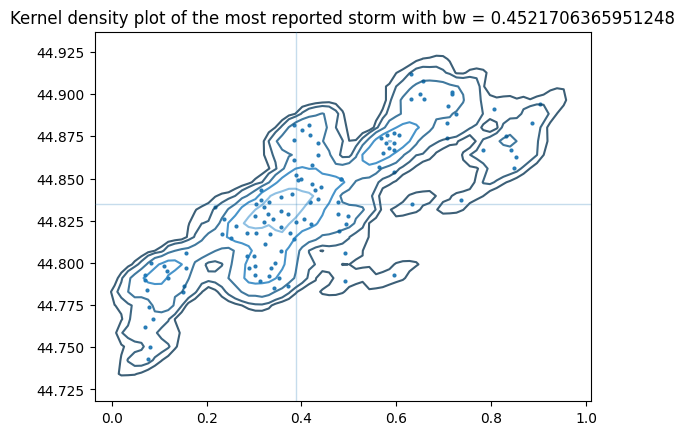

In [194]:
# scott optimal bandwith 
data = df_kernel[['LONGITUDE', 'LATITUDE']]
x = data.LONGITUDE
y = data.LATITUDE
data = np.transpose(data)
kern = 'epanechnikov'
bw = 'scott'
sigmas = np.arange(0, 3, 0.5) # array_like of positive scalar values denoting contour levels

kde = kale.KDE(data, kernel=kern, bandwidth=bw) 

fig, ax = plt.subplots()
ax.set_title("Kernel density plot of the most reported storm with bw = {}".format(kde.bandwidth[0, 0]))
kale.dist2d(kde, ax=ax, hist=False, sigmas=sigmas, outline= False, quantiles=None, scatter=True, median= True, mask_dense=False, mask_below = True)

# sigmas does not care about the values provided but the number of values (and maybe the gap between them)

ValueError: Contour levels must be increasing

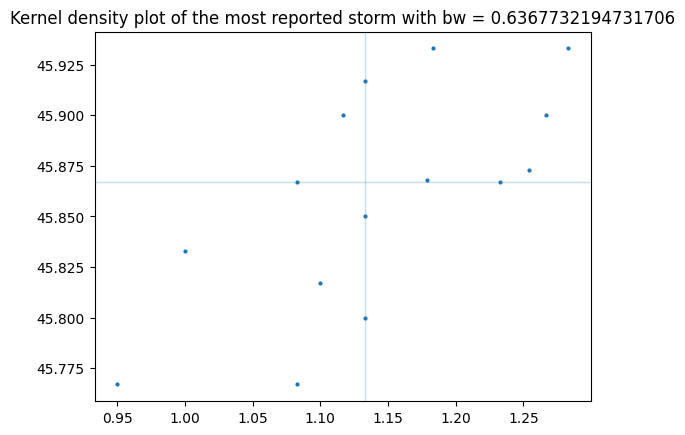

In [442]:
# scott optimal bandwith 
data = df_kernel[['LONGITUDE', 'LATITUDE']]
x = data.LONGITUDE
y = data.LATITUDE
data = np.transpose(data)
kern = 'epanechnikov'
bw = 'scott'
sigmas = np.arange(0, 3, 0.1) # array_like of positive scalar values denoting contour levels

kde = kale.KDE(data, kernel=kern, bandwidth=bw) 
fig, ax = plt.subplots()
ax.set_title("Kernel density plot of the most reported storm with bw = {}".format(kde.bandwidth[0, 0]))
kale.dist2d(kde, ax=ax, hist=False, sigmas=sigmas, smooth=True, outline= False, scatter=True, median= True, mask_dense=False, mask_below = True)


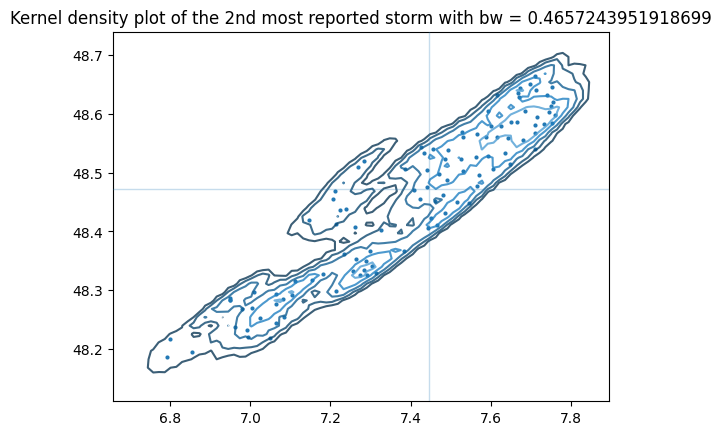

In [180]:

data1 = secondbig[['LONGITUDE', 'LATITUDE']]
x = data1.LONGITUDE
y = data1.LATITUDE
data1 = np.transpose(data1)
kern = 'epanechnikov'
bw = 'scott'
sigmas = np.arange(0, 3, 0.5) # array_like of positive scalar values denoting contour levels

kde1 = kale.KDE(data1, kernel=kern, bandwidth=bw)  


fig, ax = plt.subplots()
ax.set_title("Kernel density plot of the 2nd most reported storm with bw = {}".format(kde2.bandwidth[0, 0]))
kale.dist2d(kde1, ax=ax, hist=False, sigmas=sigmas, outline= False, quantiles=None, scatter=True, median= True, mask_dense=False, mask_below = True)


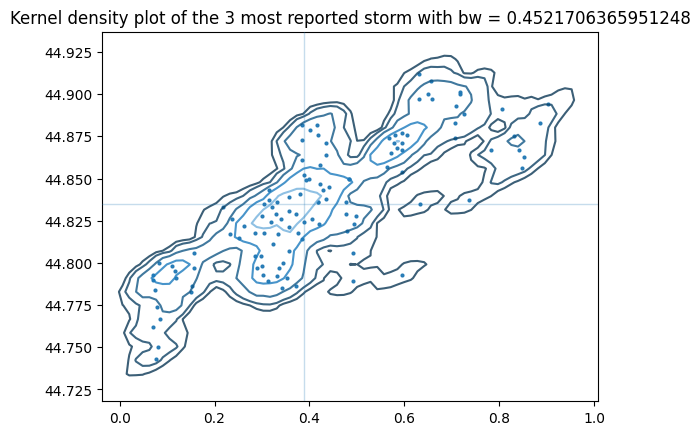

In [173]:
# plotting 10 biggest


# scott optimal bandwith 
data = df_kernel[['LONGITUDE', 'LATITUDE']]
x = data.LONGITUDE
y = data.LATITUDE
data = np.transpose(data)
kern = 'epanechnikov'
bw = 'scott'
sigmas = np.arange(0, 3, 0.5) # array_like of positive scalar values denoting contour levels

for i in np.arange(0,df10biggest.length()):

    kde = kale.KDE(data, kernel=kern, bandwidth=bw)  

fig, ax = plt.subplots()
ax.set_title("Kernel density plot of the 3 most reported storm with bw = {}".format(kde.bandwidth[0, 0]))
kale.dist2d(kde, ax=ax, hist=False, sigmas=sigmas, outline= False, scatter=True, median= True, mask_dense=False, mask_below = True)
#ax.clabel(handle, inline=True, fontsize=10)

In [28]:
import random
random.seed(11)

df = df_fix_maxhail.copy()
country = 'FR'
year_since = 2022
#df = getting_ready(df, country, year_since)
df = convert_time_to_timestamps(df)
df = df[df['COUNTRY'] == country]
df = df[df['YEAR'] >= year_since]
df = df[['TIME_EVENT', 'LATITUDE', 'LONGITUDE', 'MAX_HAIL_DIAMETER']]
df = df.reset_index(drop=True)
df_dbscan = df[['TIME_EVENT', 'LATITUDE', 'LONGITUDE']]
df_dbscan = run_dbscan_retrieve_classes(df_dbscan, 0.16, 1, 2)
df['LABELS'] = df_dbscan['LABELS']
dfnobin = df[df.LABELS > -1] # the total number of clusters of 181
dfnobin_nona = dfnobin.dropna() # is here reduced to 171 beacause there are clusters that are only comprised of reports where max hail diameter is not provided
biggest_storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[0],]
biggest_storm = biggest_storm.drop(columns=['LABELS'])


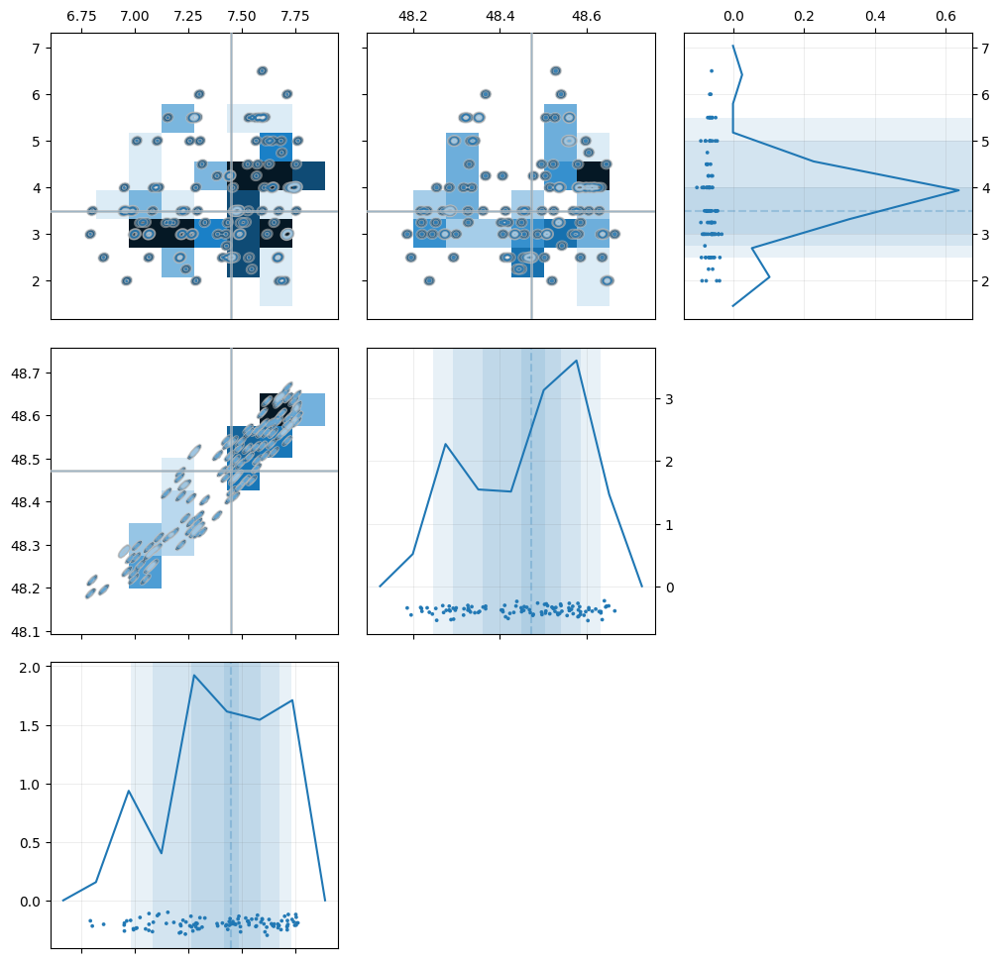

In [21]:
storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[0],]
storm = storm.drop(columns=['LABELS'])
data = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]
data = np.transpose(data)


kern = 'epanechnikov'
bw = 0.1
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)

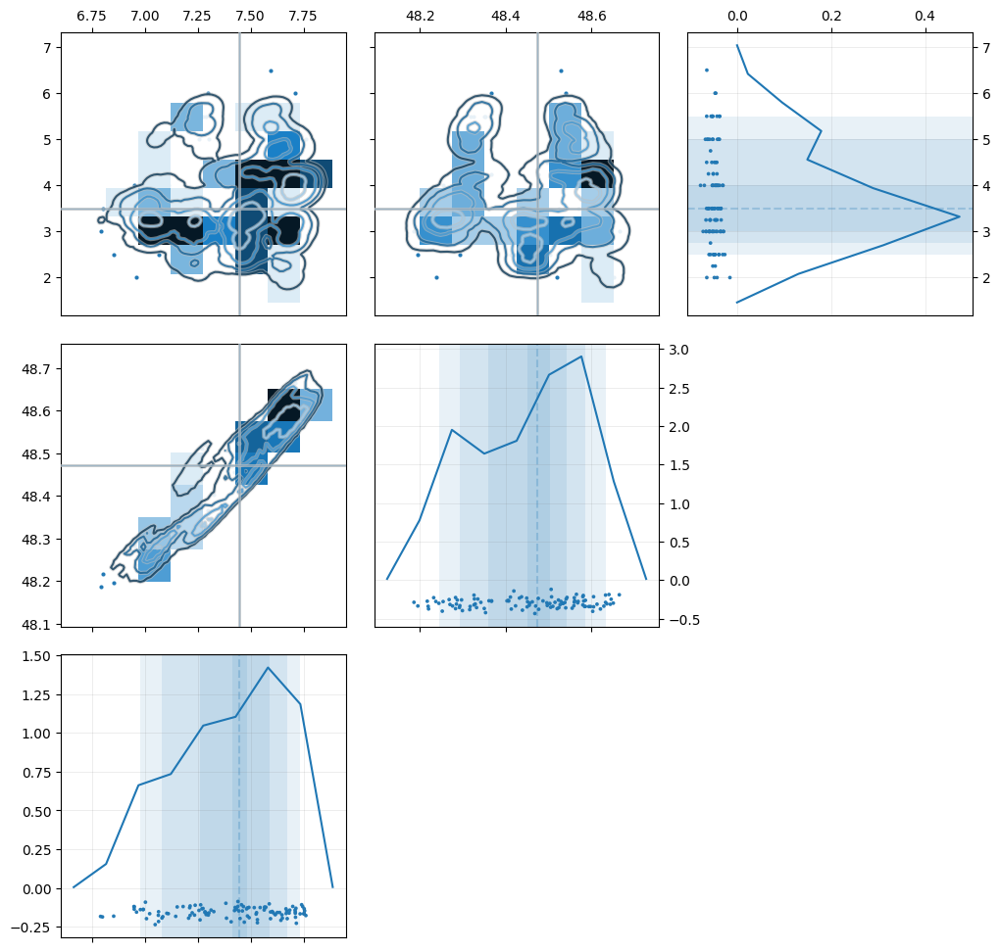

In [69]:
bw = 0.513
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)

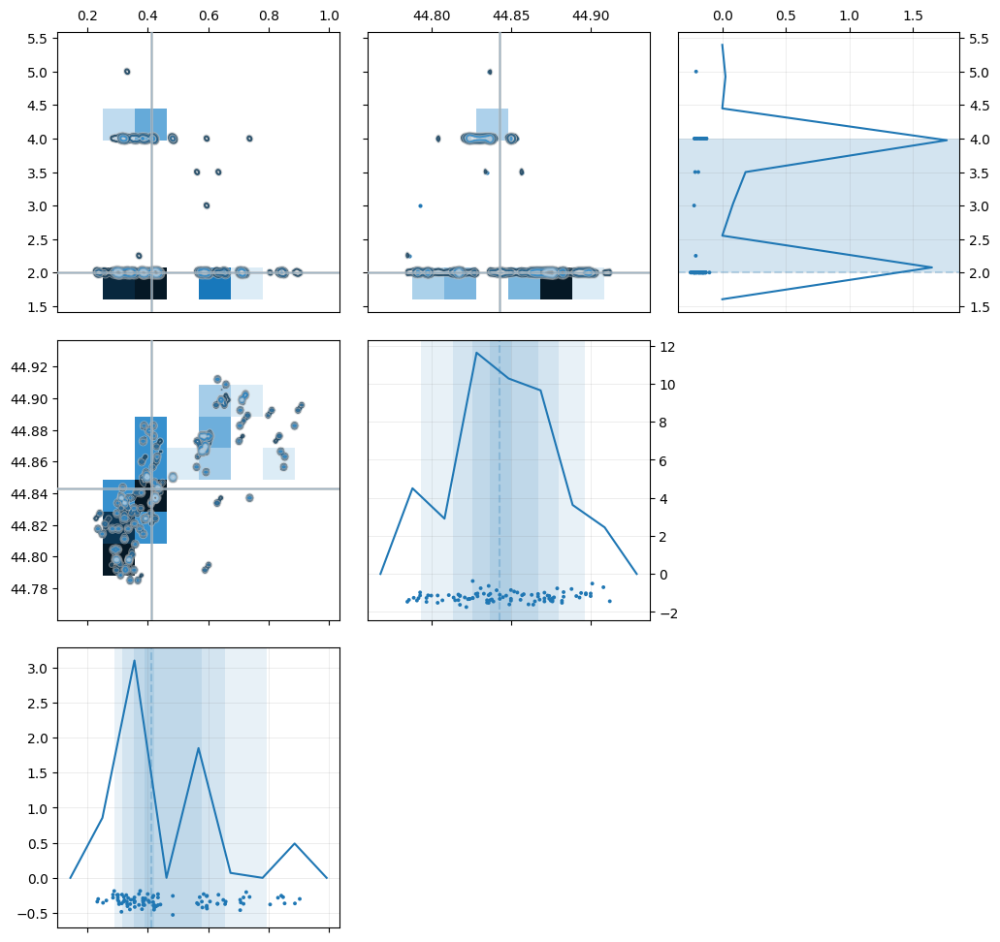

In [114]:
storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[1],]
storm = storm.drop(columns=['LABELS'])
data = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]
data = np.transpose(data)


kern = 'epanechnikov'
bw = 0.1
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)

In [131]:
import KDEpy
from KDEpy import bw_selection as bw_sel
from scipy.stats import norm

0.10882830406752934

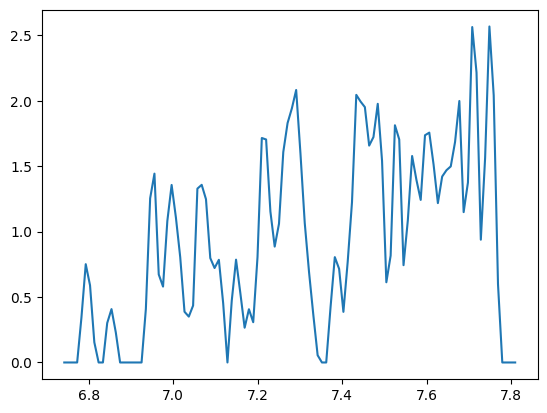

In [133]:
storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[0],]
storm = storm.drop(columns=['LABELS'])
data = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]

ardata=data.to_numpy()

# longitude since ISJ does not support dimension of the data >1
x, y = KDEpy.NaiveKDE(kernel='epa', bw='ISJ').fit(ardata[:,0]).evaluate(ardata[:,0].shape)
plt.plot(x, y)

arlon = storm[['LONGITUDE']].to_numpy()
bw_sel.improved_sheather_jones(arlon)
bw_sel.silvermans_rule(arlon)

In [136]:
import openturns as ot
import openturns.viewer as viewer
from matplotlib import pylab as plt

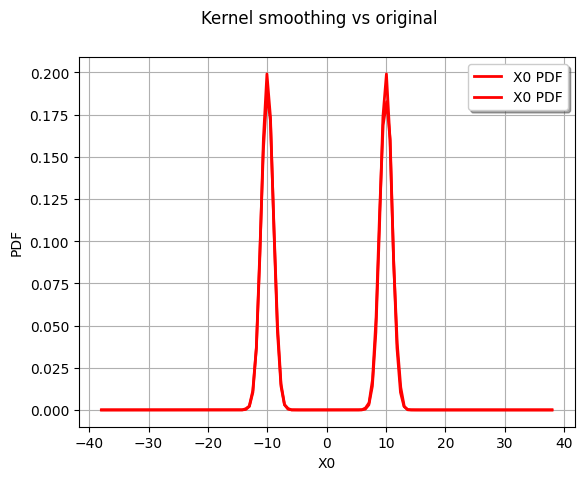

In [142]:
X1 = ot.Normal(10.0, 1.0)
X2 = ot.Normal(-10.0, 1.0)
myDist = ot.Mixture([X1, X2])
sample = myDist.getSample(2000)
graph = myDist.drawPDF()
graph.setTitle("Kernel smoothing vs original")
kernelPB = ot.KernelSmoothing()
bandwidthPB = kernelPB.computePluginBandwidth(sample)
estimatedPB = kernelPB.build(sample, bandwidthPB)
kernelPB_plot = estimatedPB.drawPDF().getDrawable(0)
graph.add(kernelPB_plot)
view = viewer.View(graph)


In [165]:
import statsmodels.api as sm
dens_u = sm.nonparametric.KDEMultivariate(data=ardata, var_type='ccc', bw='cv_ml')
dens_u.bw


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\statsmodels\nonparametric\kernel_density.py:158: RuntimeWarning: invalid value encountered in log
  L += func(f_i)


array([0.04092437, 0.02215276, 0.59627497])

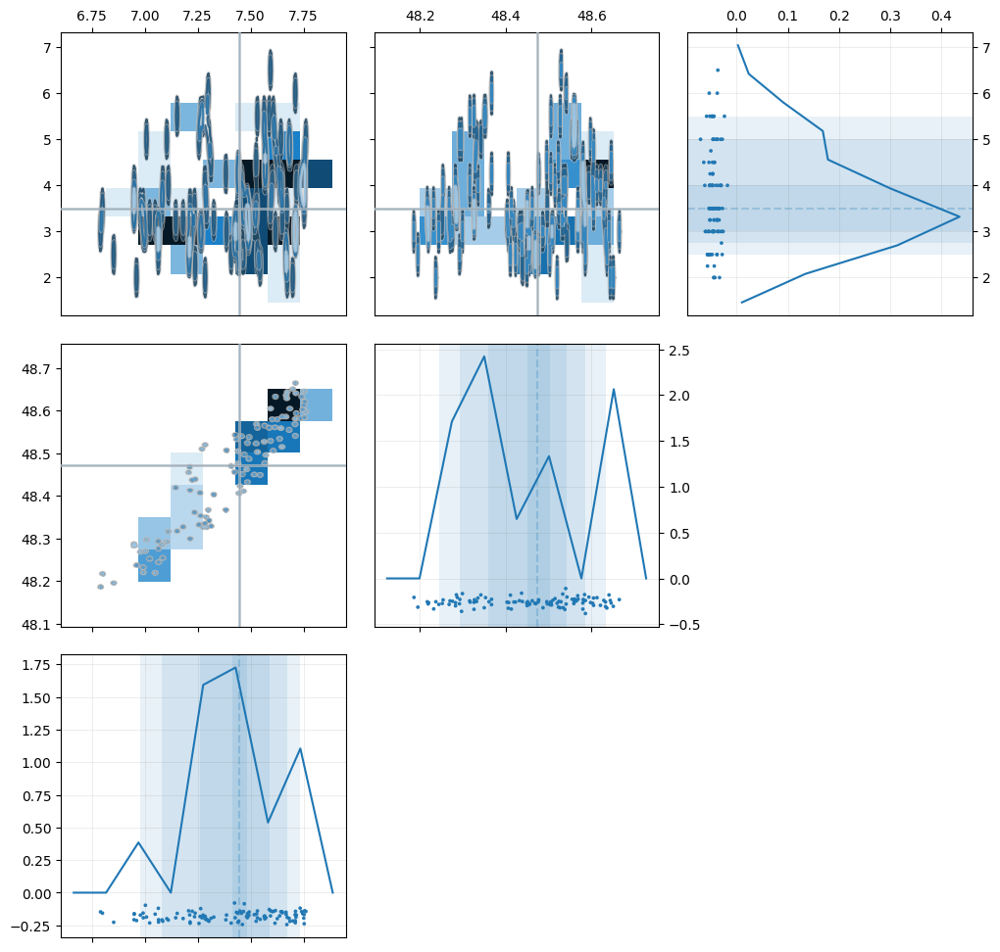

In [166]:
storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[0],]
storm = storm.drop(columns=['LABELS'])
data = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]
data = np.transpose(data)


kern = 'epanechnikov'
bw = dens_u.bw

kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)


array([0.04676329, 0.02223694, 0.74565041])

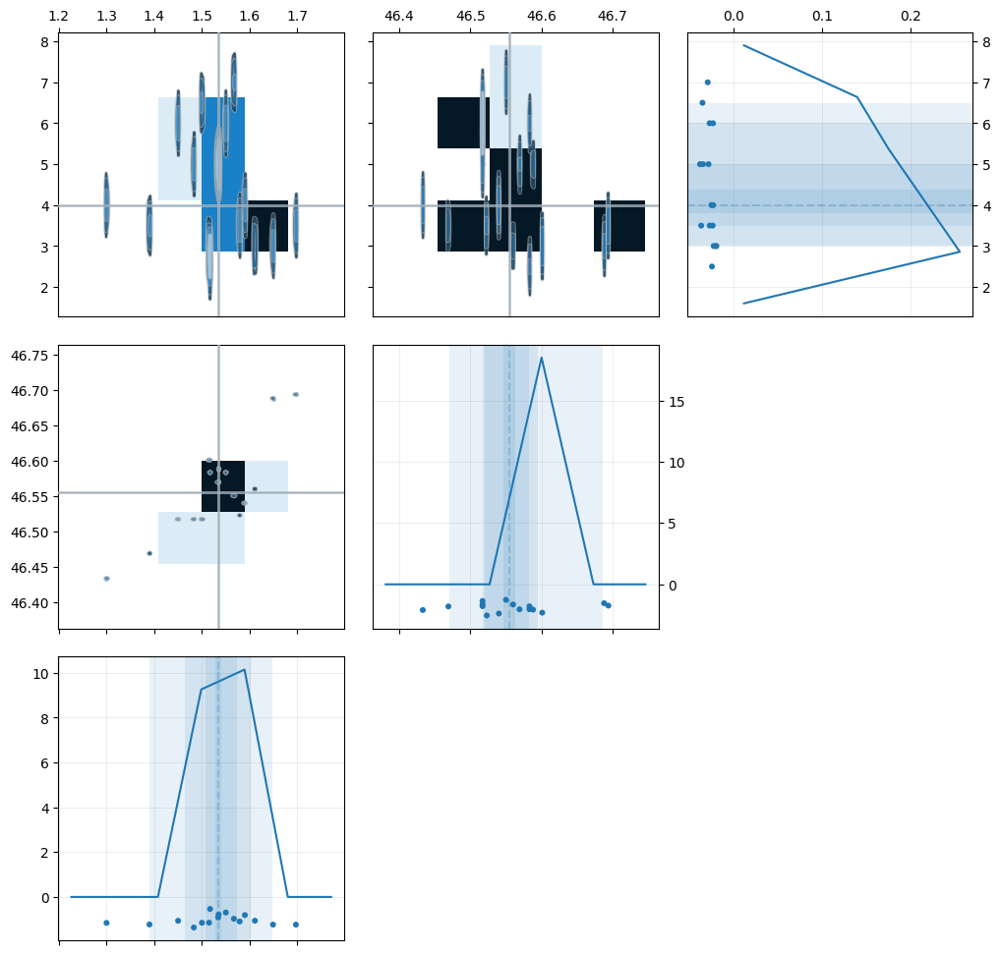

In [176]:
#20th biggest CV

storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[20],]
storm = storm.drop(columns=['LABELS'])
data = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]
ardata=data.to_numpy()

data = np.transpose(data)

dens_u = sm.nonparametric.KDEMultivariate(data=ardata, var_type='ccc', bw='cv_ml')
dens_u.bw

kern = 'epanechnikov'
bw = dens_u.bw

kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)
bw

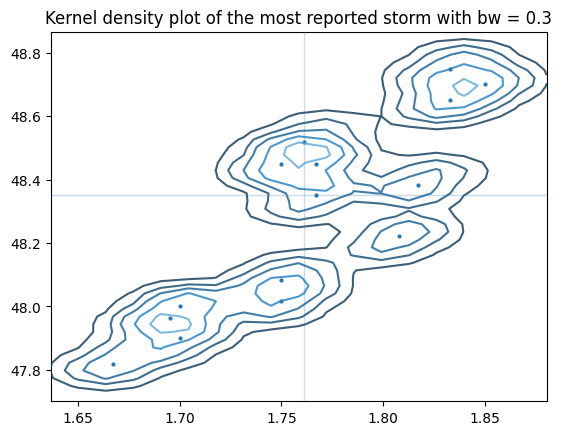

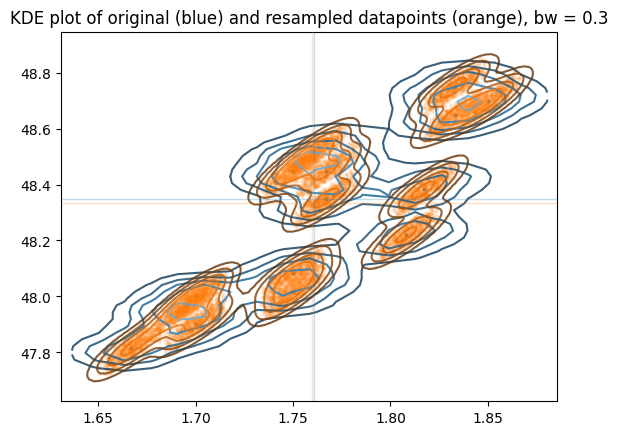

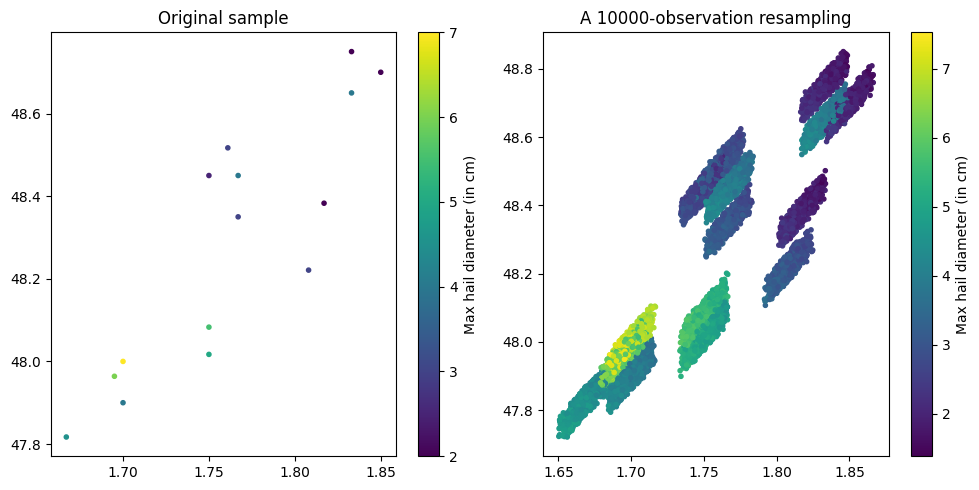

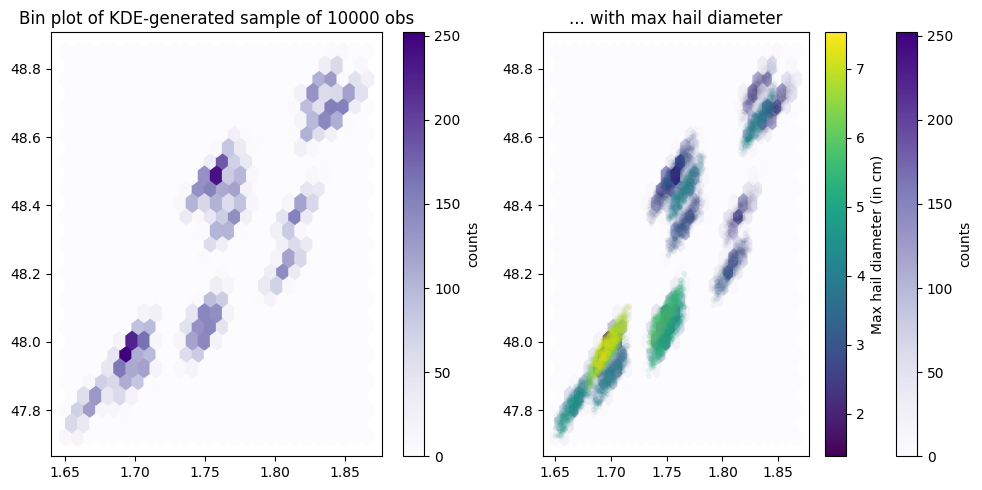

In [22]:
storm = dfnobin.loc[dfnobin['LABELS']==dfnobin['LABELS'].value_counts().sort_values(ascending=False).index[25],]
storm = storm.drop(columns=['LABELS'])

# running kde on original sample with scott optimal bandwith 
data = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]
data = np.transpose(data)
kern = 'epanechnikov'
bw = 0.3
sigmas = np.arange(0, 3, 0.5) # array_like of positive scalar values denoting contour levels
kde = kale.KDE(data, kernel=kern, bandwidth=bw) 

# resampling n obs
resamp_stnd = kde.resample(size=10000)
resamp_kde = kale.KDE(resamp_stnd, kernel=kern, bandwidth=bw)
sample = storm[['LONGITUDE', 'LATITUDE','MAX_HAIL_DIAMETER']]

# 
sample_nohail = storm[['LONGITUDE', 'LATITUDE']]
sample_nohail = np.transpose(sample_nohail)
kern = 'epanechnikov'
bw = 0.7
sigmas = np.arange(0, 3, 0.5) # array_like of positive scalar values denoting contour levels
kde_nohail = kale.KDE(data, kernel=kern, bandwidth=bw)
sample_nohail = np.transpose(sample_nohail)

kde_scipy = KernelDensity(kernel='epanechnikov', bandwidth=kde_nohail.bandwidth[0, 0]).fit(sample_nohail)
log_dens = kde_scipy.score_samples(sample_nohail)
density = np.exp(log_dens)
df_kernel = sample_nohail
df_kernel['DENSITY'] = density 
df_kernel = df_kernel.dropna()


# plotting


# kde plot original sample
fig0, ax0 = plt.subplots()
ax0.set_title("Kernel density plot of the most reported storm with bw = {}".format(kde.bandwidth[0, 0]))
kde1 = kale.dist2d(kde, ax=ax0, hist=False, sigmas=sigmas, outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)

# original and resampling
fig1, ax1 = plt.subplots()
ax1.set_title("KDE plot of original (blue) and resampled datapoints (orange), bw = {}".format(kde.bandwidth[0, 0]))
kde1 = kale.dist2d(kde, ax=ax1, hist=False, sigmas=sigmas, outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)
kde2 = kale.dist2d(resamp_kde, ax=ax1, hist=False, sigmas=sigmas, outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)

# max hail diameter and kde density
fig2, ax2 = plt.subplots(1, 2)

sc1 = ax2[0].scatter(sample.iloc[:,0], sample.iloc[:,1], c=sample.iloc[:,2], marker=".")
fig2.colorbar(sc1, ax=ax2[0], label="Max hail diameter (in cm)")
ax2[0].set_title('Original sample')

sc2 = ax2[1].scatter(resamp_stnd[0], resamp_stnd[1], c=resamp_stnd[2], marker=".")
fig2.colorbar(sc2, ax=ax2[1], label="Max hail diameter (in cm)")
ax2[1].set_title('A 10000-observation resampling')

fig2.set_figheight(5)
fig2.set_figwidth(10)
plt.tight_layout()


resamp = np.transpose(resamp_stnd)
resamp = pd.DataFrame(resamp, columns = ['LONGITUDE','LATITUDE','MAX_HAIL_DIAMETER'])
resamp = resamp.sort_values('MAX_HAIL_DIAMETER', )
salpha = np.linspace(0, 0.07, len(resamp['MAX_HAIL_DIAMETER']))


fig2, ax2 = plt.subplots(1,2)
hb = ax2[0].hexbin(resamp['LONGITUDE'], resamp['LATITUDE'], gridsize=25, cmap='Purples')
fig2.colorbar(hb, ax=ax2[0], label='counts')
ax2[0].set_title('Bin plot of KDE-generated sample of 10000 obs')

hb = ax2[1].hexbin(resamp['LONGITUDE'], resamp['LATITUDE'], gridsize=25, cmap='Purples')
fig2.colorbar(hb, ax=ax2[1], label='counts')
sc2 = ax2[1].scatter(resamp['LONGITUDE'], resamp['LATITUDE'], c=resamp['MAX_HAIL_DIAMETER'], alpha=salpha, marker=".")
fig2.colorbar(sc2, ax=ax2[1], label="Max hail diameter (in cm)")
ax2[1].set_title('... with max hail diameter')

fig2.set_figheight(5)
fig2.set_figwidth(10)
plt.tight_layout()

     nb_of_reports_that_clusters_have
0.0                               2.0
1.0                               2.0
     nb_of_reports_that_clusters_have
0.0                              15.0
1.0                              36.0
     nb_of_reports_that_clusters_have
0.0                              98.0
1.0                             117.0
     nb_of_reports_that_clusters_have
0.0                              47.0
1.0                              73.0
     nb_of_reports_that_clusters_have
0.0                               3.0
1.0                              14.0


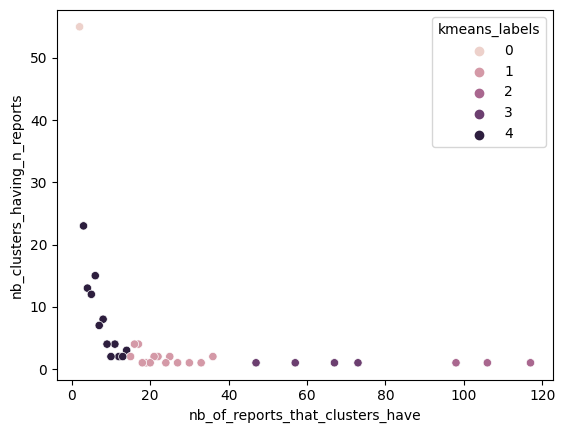

In [121]:
nb_of_reports_that_clusters_have = dfnobin['LABELS'].value_counts().value_counts().index
dfclustering_nb_cluster_on_nb_reports = pd.DataFrame({"nb_clusters_having_n_reports" : nb_clusters_having_n_reports,"nb_of_reports_that_clusters_have" : nb_of_reports_that_clusters_have})

from sklearn.cluster import KMeans
nb_clusters = 5
kmeans = KMeans(n_clusters=nb_clusters, random_state=0, n_init="auto").fit(dfclustering_nb_cluster_on_nb_reports)
dfclustering_nb_cluster_on_nb_reports['kmeans_labels'] = kmeans.labels_

sns.scatterplot(data=dfclustering_nb_cluster_on_nb_reports, x="nb_of_reports_that_clusters_have", y="nb_clusters_having_n_reports", hue="kmeans_labels")

for i in range(0,nb_clusters):
    x = dfclustering_nb_cluster_on_nb_reports.loc[dfclustering_nb_cluster_on_nb_reports.kmeans_labels==i,['nb_of_reports_that_clusters_have']]
    print(x.quantile([0,1]))




In [129]:
stdbscan_labels = dfnobin['LABELS'].value_counts().index
nb_reports_of_each_storms = dfnobin['LABELS'].value_counts()
dfstorms_kmeans_labels = pd.DataFrame({"stdbscan_labels" : stdbscan_labels,"nb_reports_of_each_storms" : nb_reports_of_each_storms})
dfstorms_kmeans_labels['kmeans_labels'] = nb_reports_of_each_storms

dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels == 2, 'kmeans_labels'] = 0
dfstorms_kmeans_labels.loc[(dfstorms_kmeans_labels.kmeans_labels >= 3) & (dfstorms_kmeans_labels.kmeans_labels < 15), 'kmeans_labels'] = 1
dfstorms_kmeans_labels.loc[(dfstorms_kmeans_labels.kmeans_labels >= 15) & (dfstorms_kmeans_labels.kmeans_labels < 47), 'kmeans_labels'] = 2
dfstorms_kmeans_labels.loc[(dfstorms_kmeans_labels.kmeans_labels >= 47) & (dfstorms_kmeans_labels.kmeans_labels < 98), 'kmeans_labels'] = 3
dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels >= 98, 'kmeans_labels'] = 4


,stdbscan_labels,nb_reports_of_each_storms,kmeans_labels
154,154,117,4
59,59,106,4
122,122,98,4
96,96,73,3
103,103,67,3
...,...,...,...
84,84,2,0
81,81,2,0
80,80,2,0
78,78,2,0


In [144]:
dfnobin.loc[dfnobin['LABELS']==1,"LABELS"]

2    1
3    1
4    1
5    1
6    1
7    1
8    1
Name: LABELS, dtype: int64

C:\Users\t480\AppData\Local\Temp\ipykernel_20060\2451819837.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig0, ax0 = plt.subplots()
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\kalepy\kernels.py:131: RuntimeWarning: divide by zero encountered in divide
  result = result / norm
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\kalepy\kernels.py:131: RuntimeWarning: invalid value encountered in divide
  result = result / norm
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\matplotlib\contour.py:1480: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\matplotlib\cont

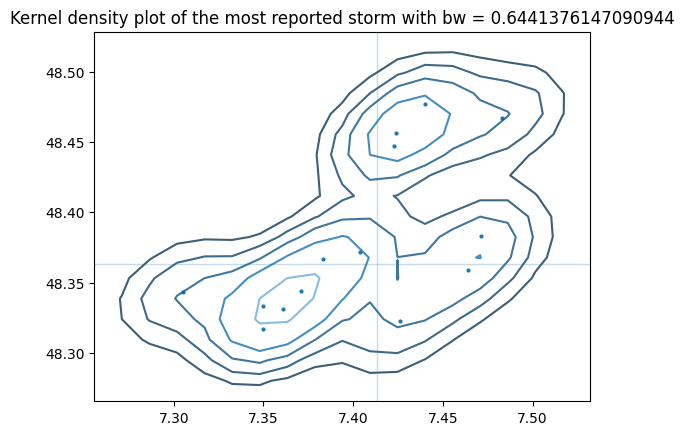

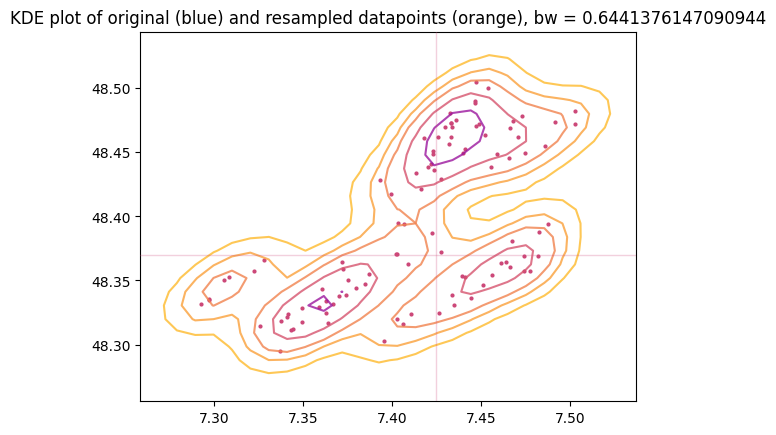

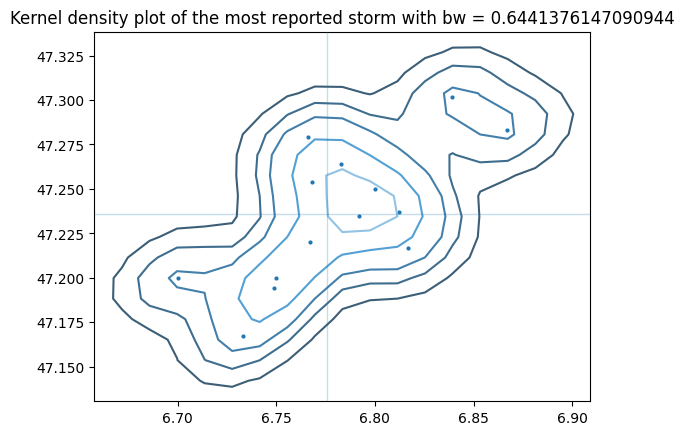

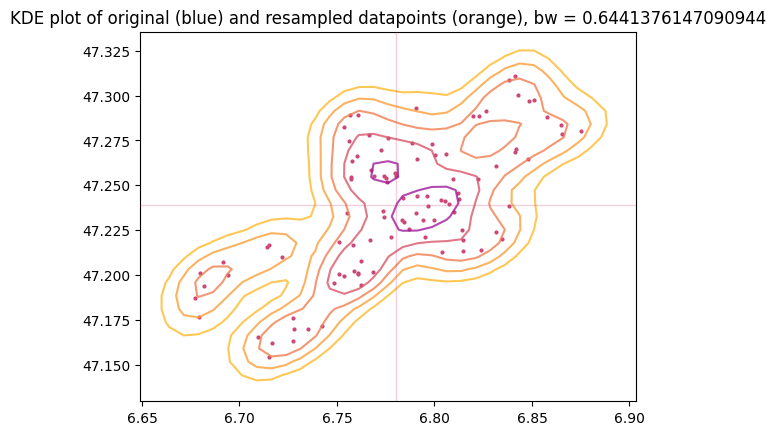

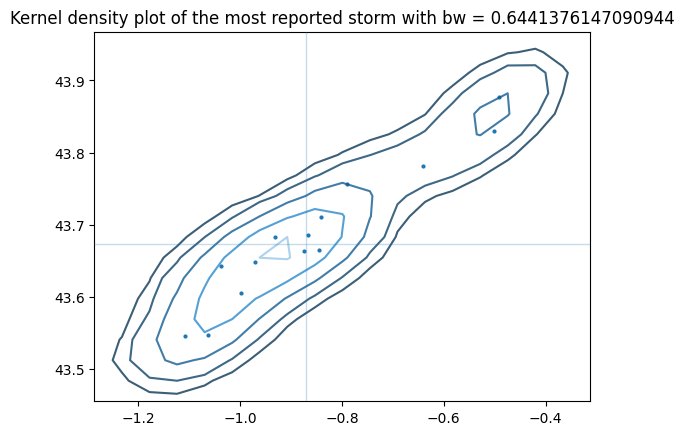

...

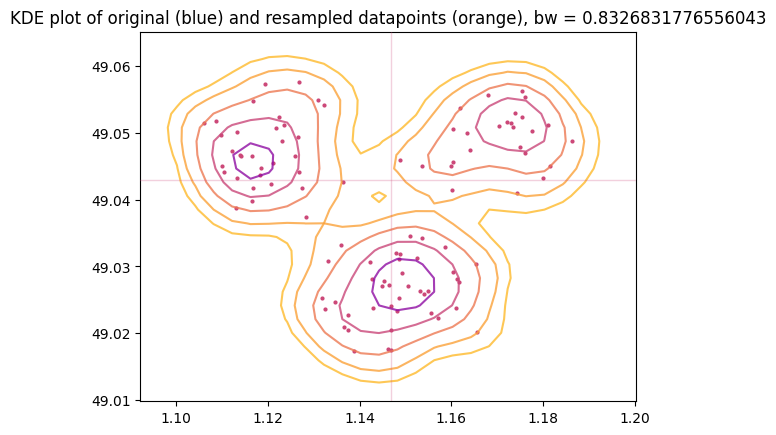

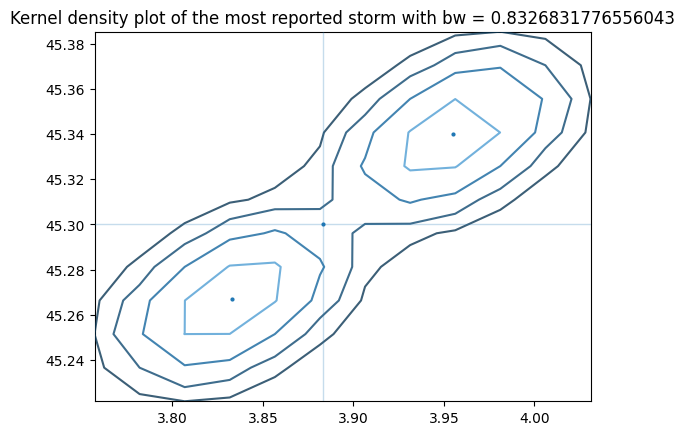

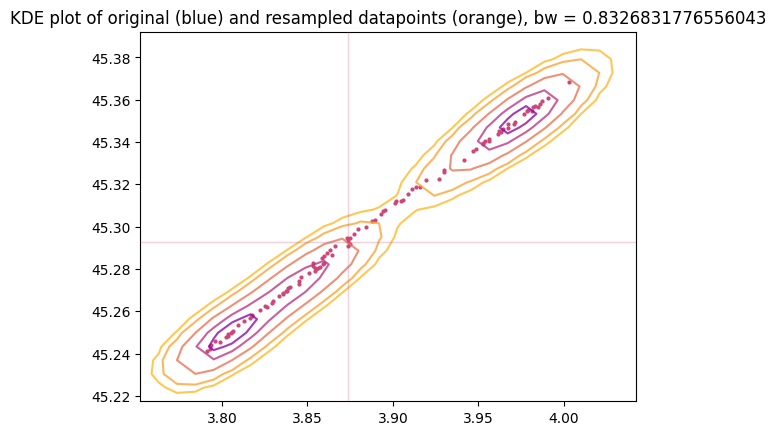

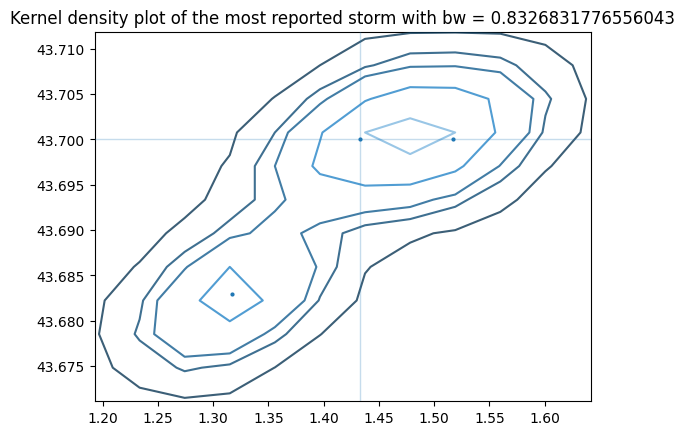

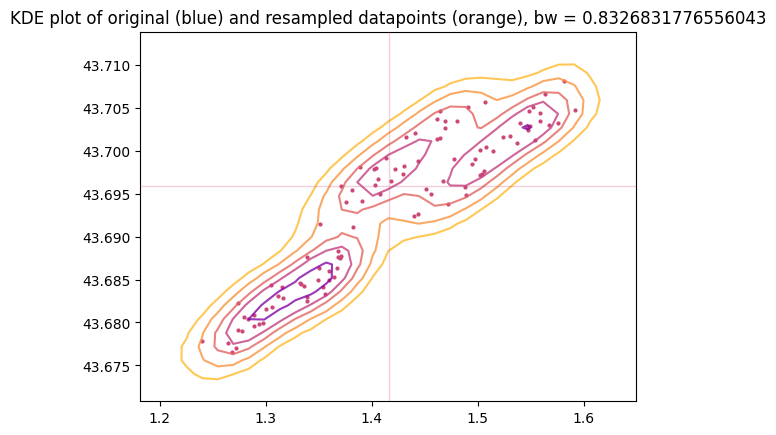

In [159]:
storms_kmean_cluster0 = dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels == 0, 'stdbscan_labels']
storms_kmean_cluster1 = dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels == 1, 'stdbscan_labels']
storms_kmean_cluster2 = dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels == 2, 'stdbscan_labels']
storms_kmean_cluster3 = dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels == 3, 'stdbscan_labels']
storms_kmean_cluster4 = dfstorms_kmeans_labels.loc[dfstorms_kmeans_labels.kmeans_labels == 4, 'stdbscan_labels']

for i in storms_kmean_cluster1:
    storm = dfnobin.loc[dfnobin['LABELS']==i]
    storm = storm.drop(columns=['LABELS'])

    # running kde on original sample with scott optimal bandwith 
    data = storm[['LONGITUDE', 'LATITUDE']]
    data = np.transpose(data)
    kern = 'epanechnikov'
    bw = 'scott'
    sigmas = np.arange(0, 3, 0.5) # array_like of positive scalar values denoting contour levels
    kde = kale.KDE(data, kernel=kern, bandwidth=bw) 

    if i in storms_kmean_cluster0:
        # plotting
        # kde plot original sample
        fig0, ax0 = plt.subplots()
        ax0.set_title("Kernel density plot of the most reported storm with bw = {}".format(kde.bandwidth[0, 0]))
        kde1 = kale.dist2d(kde, ax=ax0, hist=False, sigmas=sigmas, outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)
    else:
        # resampling n obs
        resamp_stnd = kde.resample(size=100)
        resamp_kde = kale.KDE(resamp_stnd, kernel=kern, bandwidth=bw)
        sample = storm[['LONGITUDE', 'LATITUDE']]

        # plotting
        # kde plot original sample
        fig0, ax0 = plt.subplots()
        ax0.set_title("Kernel density plot of the most reported storm with bw = {}".format(kde.bandwidth[0, 0]))
        kde1 = kale.dist2d(kde, ax=ax0, hist=False, sigmas=sigmas, outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)

        # original and resampling
        fig1, ax1 = plt.subplots()
        ax1.set_title("KDE plot of original (blue) and resampled datapoints (orange), bw = {}".format(kde.bandwidth[0, 0]))
        #kde1 = kale.dist2d(kde, ax=ax1, hist=False, sigmas=sigmas, outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)
        kde2 = kale.dist2d(resamp_kde, ax=ax1, hist=False, sigmas=sigmas, cmap='plasma', outline= False, quantiles=None, smooth=True, scatter=True, median= True, mask_dense=False, mask_below = True)

## rest kde

Text(0.5, 1.0, 'Kernel density plot of the most reported storm with bw = 0.45')

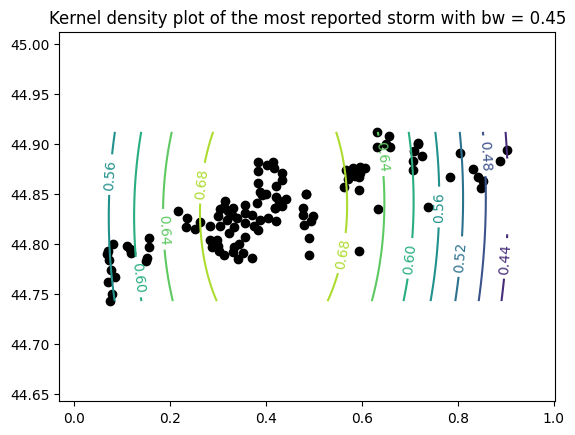

In [83]:
from sklearn.neighbors import KernelDensity

data = df_kernel[['LATITUDE', 'LONGITUDE']]
x = data.LONGITUDE
y = data.LATITUDE
bandwidth = 0.45

def kde2D(x, y, bandwidth, xbins=100j, ybins=100j, **kwargs): 
    """Build 2D kernel density estimate (KDE)."""

    # create grid of sample locations (default: 100x100)
    xx, yy = np.mgrid[x.min():x.max():xbins, 
                      y.min():y.max():ybins]

    xy_sample = np.vstack([yy.ravel(), xx.ravel()]).T
    xy_train  = np.vstack([y, x]).T

    kde_skl = KernelDensity(bandwidth=bandwidth, **kwargs)
    kde_skl.fit(xy_train)

    # score_samples() returns the log-likelihood of the samples
    z = np.exp(kde_skl.score_samples(xy_sample))
    return xx, yy, np.reshape(z, xx.shape)


xx, yy, zz = kde2D(x, y, bandwidth)

fig, ax = plt.subplots()
#levels = np.linspace(np.min(zz), np.max(zz), 7)
CS = ax.contour(xx, yy, zz)
SC = ax.scatter(x, y, facecolor='black')
ax.set(xlim=(x.min()-0.1, x.max()+0.1), ylim=(y.min()-0.1, y.max()+0.1))
ax.clabel(CS, inline=True, fontsize=10)
ax.set_title("Kernel density plot of the most reported storm with bw = {}".format(bandwidth))


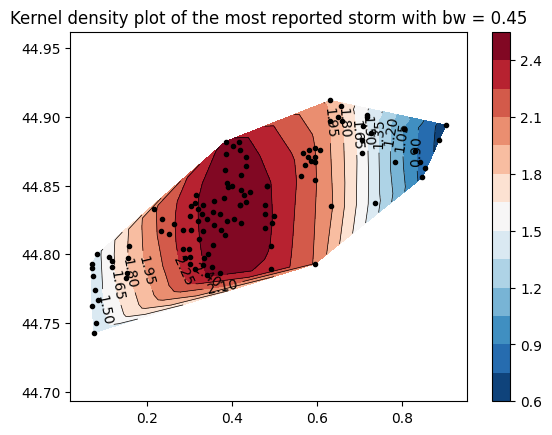

In [89]:

data = df_kernel[['LATITUDE', 'LONGITUDE']]
x = data.LONGITUDE
y = data.LATITUDE
bandwidth = 0.45

kde_skl = KernelDensity(kernel='epanechnikov', bandwidth=bandwidth)
kde_skl.fit(data)
z = np.exp(kde_skl.score_samples(data))

fig, ax2 = plt.subplots()
tri = ax2.tricontour(x, y, z, levels=14, linewidths=0.5, colors='k')
cntr2 = ax2.tricontourf(x, y, z, levels=14, cmap="RdBu_r")

fig.colorbar(cntr2, ax=ax2)
ax2.plot(x, y, 'ko', ms=3)
ax2.set(xlim=(x.min()-0.05, x.max()+0.05), ylim=(y.min()-0.05, y.max()+0.05))
ax.clabel(tri, inline=True, fontsize=10)
ax2.set_title("Kernel density plot of the most reported storm with bw = {}".format(bandwidth))

plt.subplots_adjust(hspace=0.5)
plt.show()

In [ ]:
# contour line values
# map of 5 biggest storms
# fit on smaller storms


## rest

c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\kalepy\plot.py:2126: RuntimeWarning: divide by zero encountered in log
  sigmas = np.sqrt(-2.0 * np.log(1.0 - quantiles))
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\kalepy\plot.py:2126: RuntimeWarning: divide by zero encountered in log
  sigmas = np.sqrt(-2.0 * np.log(1.0 - quantiles))


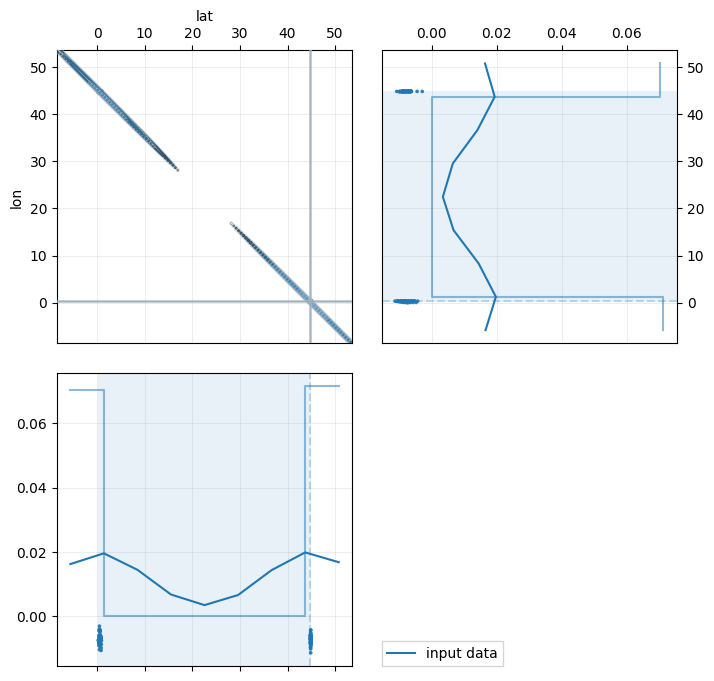

Text(0.5, 1.0, 'gaussian (bw=0.452)')

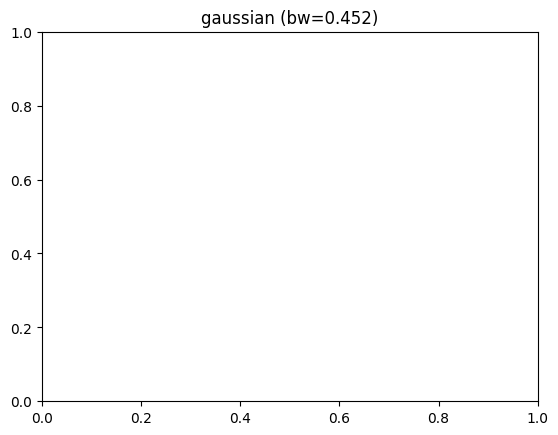

In [20]:


# Load some random-ish three-dimensional data
#np.random.seed(9485)
#data = kale.utils._random_data_3d_02(num=1e2)
data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = data.to_numpy().reshape((2,117))

kern = 'gaussian'
bw = 0.2


# Construct a KDE
# kde = kale.KDE(data)
kde = kale.KDE(data, kernel=kern, bandwidth=None)                          #

# Construct new data by resampling from the KDE
# resamp = kde.resample(size=1e3)

# 1D plot settings: turn on histograms, and modify the confidence-interval quantiles
dist1d = dict(hist=True, quantiles=[0.0, 1.0])
# 2D plot settings: turn off the histograms, and turn on scatter
dist2d = dict(hist=False, scatter=True)

# Plot the data and distributions using the builtin `kalepy.corner` plot
corner, h1 = kale.corner(kde_data = kde, labels = ['lat', 'lon', 'density'], dist1d=dist1d, dist2d=dist2d)
#h2 = corner.clean(resamp, quantiles=[0.5, 0.9], dist2d=dict(median=False), ls='--')

#corner.legend([h1, h2], ['input data', 'new samples'])
corner.legend([h1], ['input data'])

nbshow()

fig, ax = plt.subplots()
#ax.set_title('{} (bw={:.3f})'.format(kern,bw))
ax.set_title('{} (bw={:.3f})'.format(kern,kde.bandwidth[0, 0]))



In [21]:
data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)
data

,1628,1629,1630,1631,1632,1633,1634,1635,1636,1637,...,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745
LATITUDE,44.894,44.883,44.863,44.856,44.867,44.875,44.867,44.891,44.837,44.850,...,44.798,44.800,44.793,44.79,44.784,44.774,44.767,44.762,44.75,44.743
LONGITUDE,0.903,0.887,0.853,0.848,0.783,0.831,0.842,0.805,0.737,0.483,...,0.111,0.083,0.071,0.07,0.074,0.078,0.086,0.071,0.08,0.076


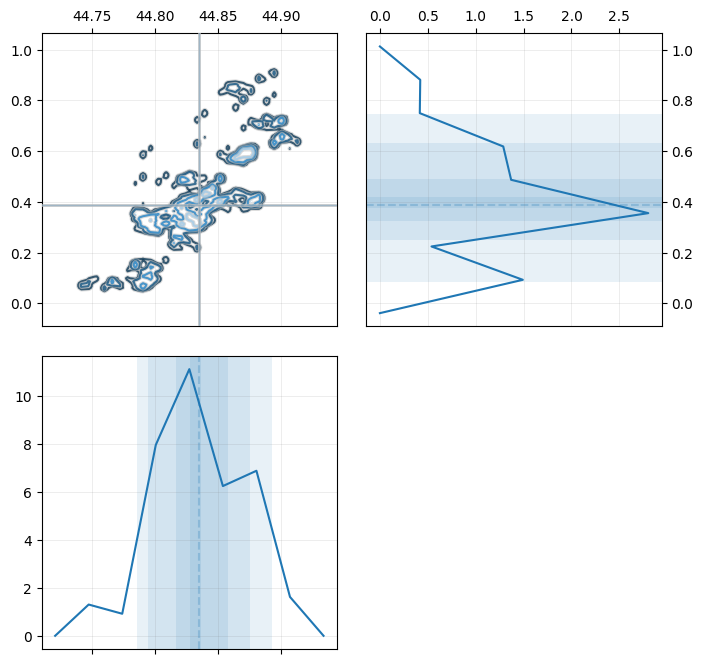

In [22]:
data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)

kern = 'epanechnikov'
bw = 0.2

kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    

corner.plot_kde(kde = kde)                   

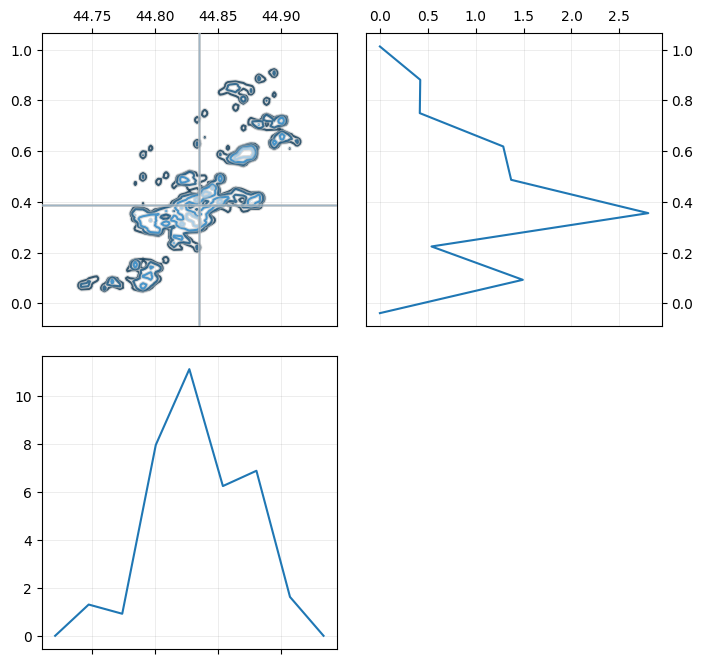

In [23]:
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.clean(kde_data = kde)

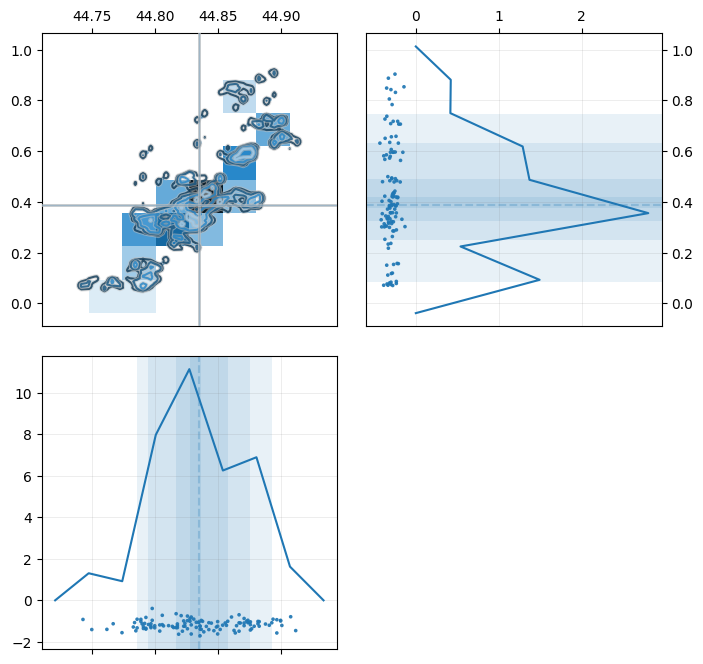

In [24]:
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot(kde_data = kde)

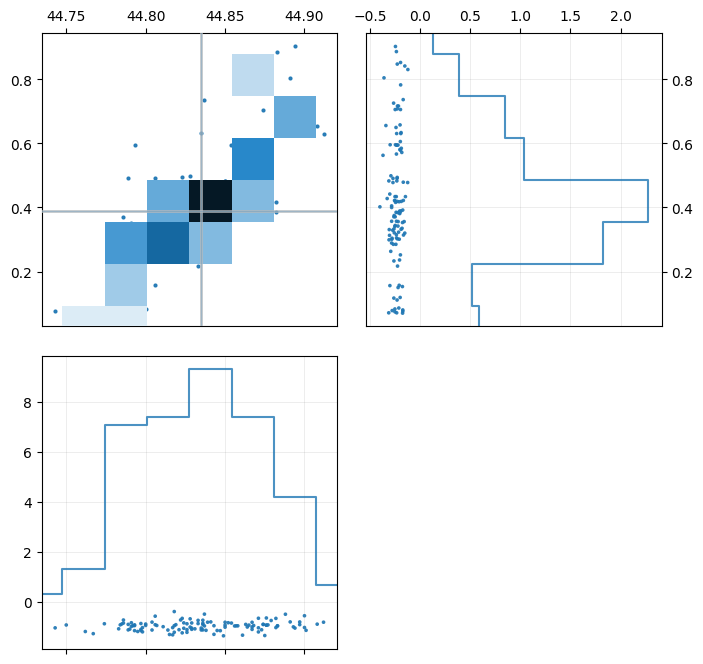

In [25]:
kde = kale.KDE(data, kernel=kern, bandwidth=bw)  
corner = kale.Corner(data)    
corner.plot_data(data = kde)

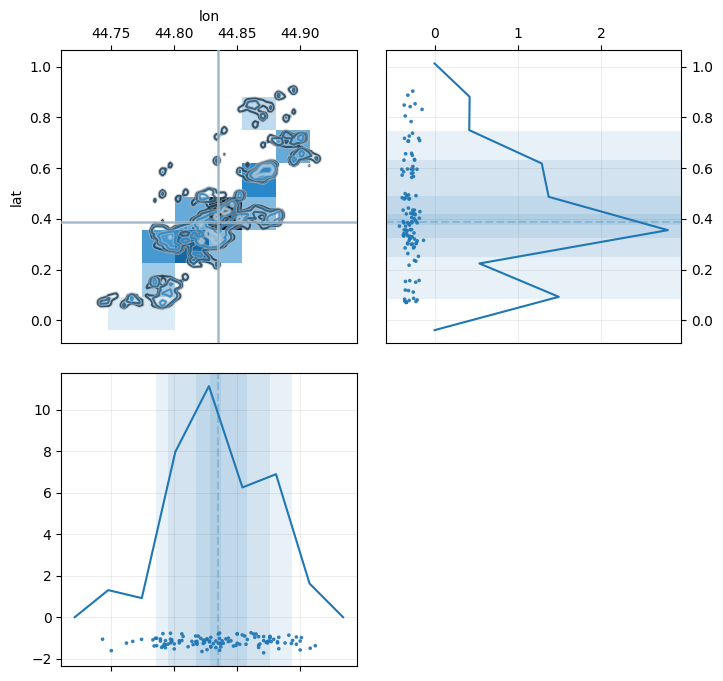

In [26]:
corner = kale.Corner(kde_data = kde, labels=['lon','lat','density'])
handle = corner.plot(kde)
corner

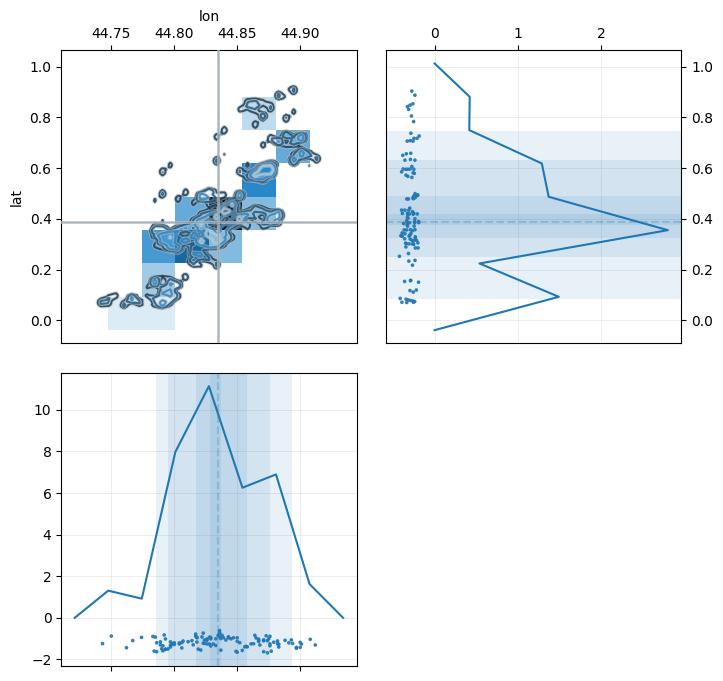

In [27]:
corner = kale.Corner(kde_data = kde, labels=['lon','lat','density'])
handle = corner.plot(kde)
handle

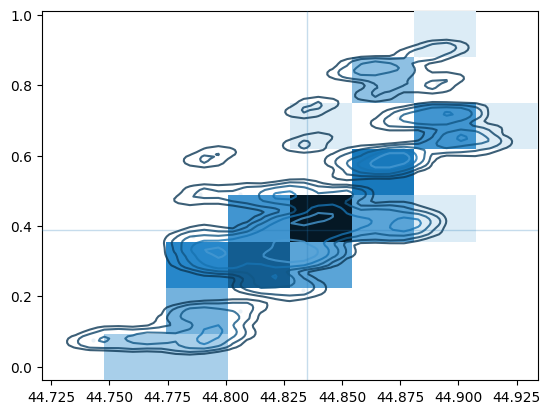

In [28]:
kale.dist2d(kde, hist=True, sigmas=np.arange(0, 3, 0.5), smooth = 1, outline= False, median= True, mask_below = True);

Text(0.5, 1.0, 'bw = 0.4521706365951248')

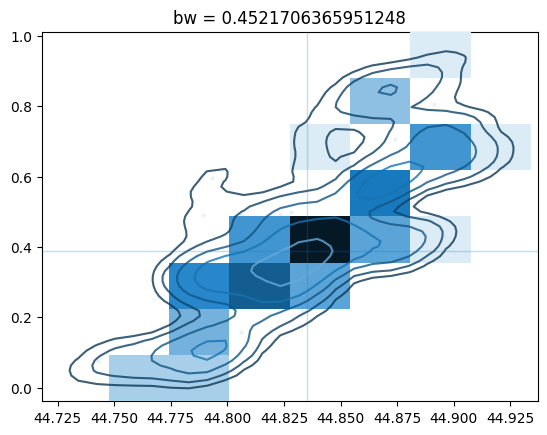

In [29]:
# scott optimal bandwith 

data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)

kern = 'epanechnikov'
bw = 'scott'

kde = kale.KDE(data, kernel=kern, bandwidth=bw)    
handle = kale.dist2d(kde, hist=True, sigmas=np.arange(0, 3, 0.5), smooth = 1, outline= False, median= True, mask_below = True)
plt.title("bw = {}".format(kde.bandwidth[0, 0]))
#ax.clabel(handle, inline=True, fontsize=10)

In [224]:
a = np.array(data) 
lat_list = [a[0,:]]
lon_list = [a[1,:]]
#array_density = np.array([data.iloc[0,:]])
#array_density.shape

In [228]:
a = np.array(data) 
lat_list = [a[0,:]]
lon_list = [a[1,:]]
array_density = np.array([lat_list, lon_list])
#density(points=data, reflect=None, params=None, grid=False, probability=True)
array_density.shape

(2, 1, 117)

In [203]:
density(points=data, reflect=None, params=None, grid=False, probability=True)

TypeError: 'numpy.ndarray' object is not callable

Text(0.5, 1.0, 'bw = 0.2')

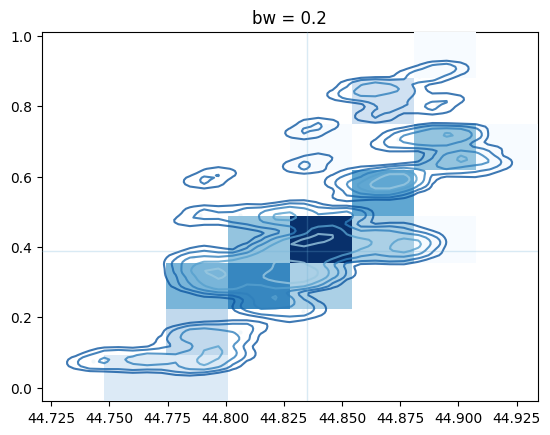

In [30]:
# scott optimal bandwith 

data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)

kern = 'epanechnikov'
bw = 0.2

kde = kale.KDE(data, kernel=kern, bandwidth=bw)    
kale.dist2d(kde, hist=True, sigmas=np.arange(0, 3, 0.5), smooth = 1, outline= False, median= True, mask_below = True, cmap='Blues')
plt.title("bw = {}".format(kde.bandwidth[0, 0]))

            

Text(0.5, 1.0, 'bw = silverman')

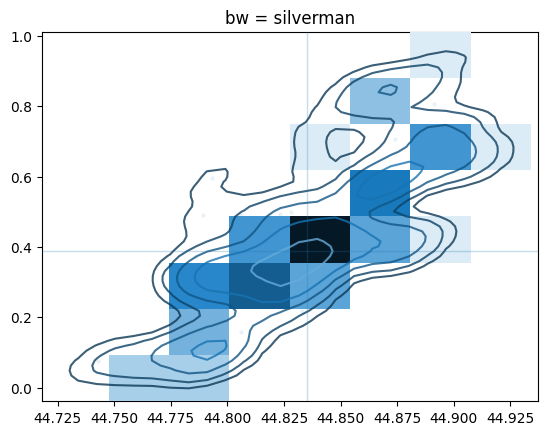

In [187]:
# scott optimal bandwith 

data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)

kern = 'epanechnikov'
bw = 'silverman'

kde = kale.KDE(data, kernel=kern, bandwidth=bw)    
kale.dist2d(kde, hist=True, sigmas=np.arange(0, 3, 0.5), smooth = 1, outline= False, median= True, mask_below = True) 
plt.title("bw = {}".format(bw))
            

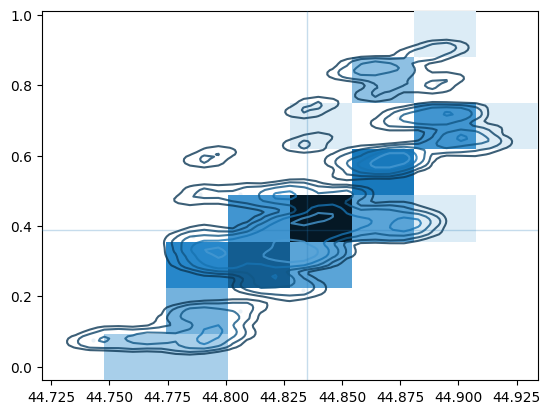

In [180]:
data = df_kernel[['LATITUDE', 'LONGITUDE']]
data = np.transpose(data)

kern = 'epanechnikov'
bw = 0.2

kde = kale.KDE(data, kernel=kern, bandwidth=bw)    
kale.dist2d(kde, hist=True, sigmas=np.arange(0, 3, 0.5), smooth = 1, outline= False, median= True, mask_below = True) 
            

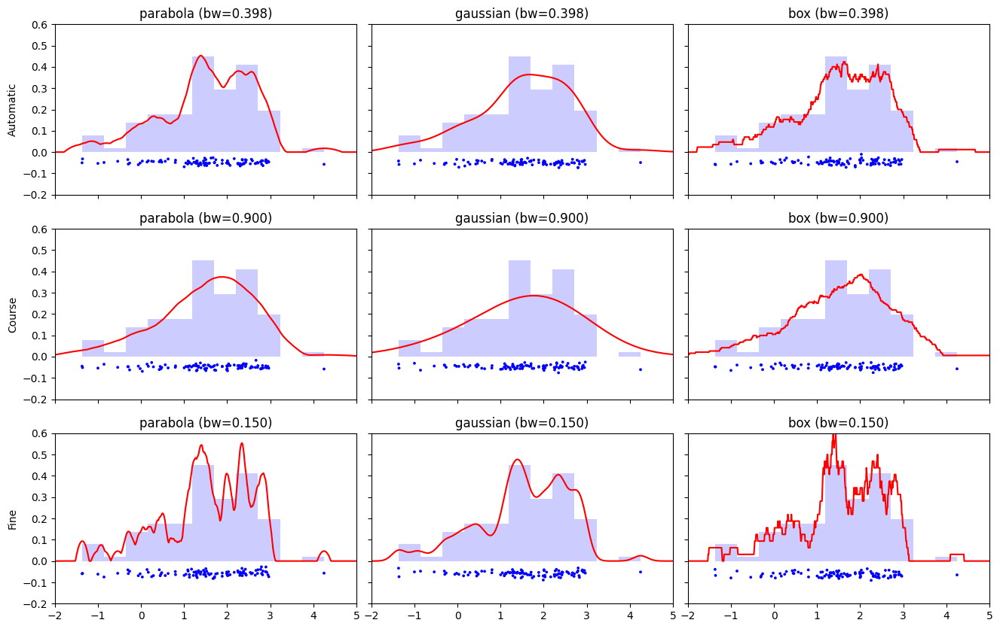

In [76]:
# Load predefined 'random' data
data = kale.utils._random_data_1d_02(num=100)
# Choose a uniform x-spacing for drawing PDFs
xx = np.linspace(-2, 8, 1000)

# ------ Choose the kernel-functions and bandwidths to test -------  #
kernels = ['parabola', 'gaussian', 'box']                            #
bandwidths = [None, 0.9, 0.15]     # `None` means let kalepy choose  #
# -----------------------------------------------------------------  #

ylabels = ['Automatic', 'Course', 'Fine']
fig, axes = plt.subplots(figsize=[16, 10], ncols=len(kernels), nrows=len(bandwidths), sharex=True, sharey=True)
plt.subplots_adjust(hspace=0.2, wspace=0.05)
for (ii, jj), ax in np.ndenumerate(axes):
    
    # ---- Construct KDE using particular kernel-function and bandwidth ---- #
    kern = kernels[jj]                                                       # 
    bw = bandwidths[ii]                                                      #
    kde = kale.KDE(data, kernel=kern, bandwidth=bw)                          #
    # ---------------------------------------------------------------------- #
    
    # If bandwidth was set to `None`, then the KDE will choose the 'optimal' value
    if bw is None:
        bw = kde.bandwidth[0, 0]
        
    ax.set_title('{} (bw={:.3f})'.format(kern, bw))
    if jj == 0:
        ax.set_ylabel(ylabels[ii])

    # plot the KDE
    ax.plot(*kde.pdf(points=xx), color='r')
    # plot histogram of the data (same for all panels)
    ax.hist(data, bins='auto', color='b', alpha=0.2, density=True)
    # plot  carpet   of the data (same for all panels)
    kale.carpet(data, ax=ax, color='b')
    
ax.set(xlim=[-2, 5], ylim=[-0.2, 0.6])
nbshow()

In [17]:
K_sample = kde.sample(10000)
x1 = kde.score_samples(K_sample)
x1 = np.exp(x1)


c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but KernelDensity was fitted with feature names
  warnings.warn(


In [56]:
K_sample = pd.DataFrame(K_sample, columns = ['TIME_EVENT','LATITUDE','LONGITUDE',"LABELS"])

In [60]:
K_sample.LABELS.sort_values()

4270    153.990148
2667    153.990198
1208    153.990235
2870    153.990322
4106    153.990446
           ...    
8380    154.009569
9269    154.009633
521     154.009645
6496    154.009816
1275    154.009816
Name: LABELS, Length: 10000, dtype: float64

In [ ]:

x = df_kernel.LONGITUDE
y = df_kernel.LATITUDE
z = df_kernel.DENSITY
z = z - z.iloc[-1]
x = x.array
y = y.array
z = z.array
axis = plt.subplot(111, title="Storm with {} reports".format(len(x)))
sc = axis.scatter(x, y, c=z, marker=".")
plt.colorbar(sc, label="probability density")
plt.show()

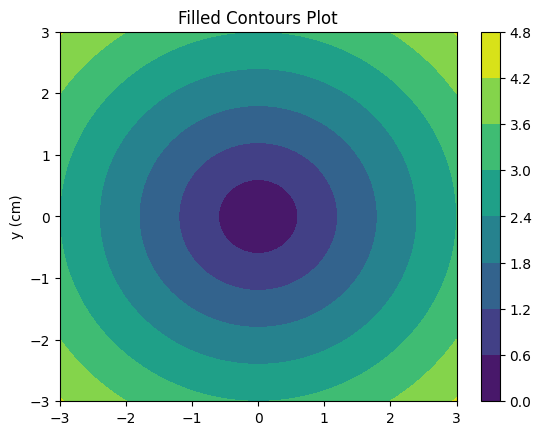

In [68]:
import numpy as np
import matplotlib.pyplot as plt
xlist = np.linspace(-3.0, 3.0, 100)
ylist = np.linspace(-3.0, 3.0, 100)
X, Y = np.meshgrid(xlist, ylist)
Z = np.sqrt(X**2 + Y**2)
fig,ax=plt.subplots(1,1)
cp = ax.contourf(X, Y, Z)
fig.colorbar(cp) # Add a colorbar to a plot
ax.set_title('Filled Contours Plot')
#ax.set_xlabel('x (cm)')
ax.set_ylabel('y (cm)')
plt.show()

In [153]:
points = df_kernel[['LONGITUDE','LATITUDE']]
points.shape

(117, 2)

Text(0.5, 1.0, 'Cubic')

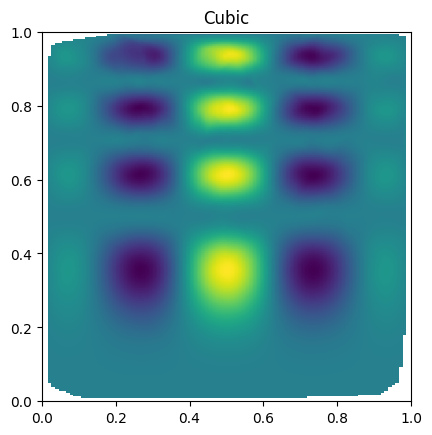

In [136]:
# interpolation review

def func(x, y):
    return x*(1-x)*np.cos(4*np.pi*x) * np.sin(4*np.pi*y**2)**2
grid_x, grid_y = np.mgrid[0:1:100j, 0:1:200j]
rng = np.random.default_rng()
points = rng.random((1000, 2))
values = func(points[:,0], points[:,1])
from scipy.interpolate import griddata
grid_z2 = griddata(points, values, (grid_x, grid_y), method='cubic')
plt.imshow(grid_z2.T, extent=(0,1,0,1), origin='lower')
plt.title('Cubic')

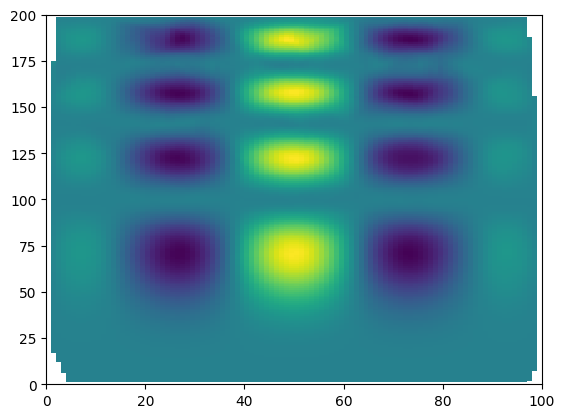

In [109]:
plt.pcolormesh(grid_z2.T)


4271.5134699932805

Text(0.5, 1.0, 'Cubic')

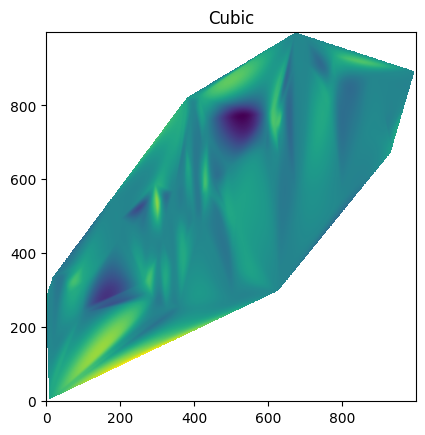

In [26]:
x = df_kernel.LONGITUDE
y = df_kernel.LATITUDE
z = df_kernel.DENSITY
grid_x, grid_y = np.mgrid[x.min():x.max():1000j, y.min():y.max():1000j]
points = df_kernel[['LONGITUDE','LATITUDE']]
values = z
from scipy.interpolate import griddata
grid_z2 = griddata(points, values, (grid_x, grid_y), method='cubic')
plt.imshow(grid_z2.T, origin='lower')
plt.title('Cubic')

In [218]:
from scipy.interpolate import interp2d
x = df_kernel.LONGITUDE
y = df_kernel.LATITUDE
z = df_kernel.DENSITY
xx, yy = np.meshgrid(x,y)
z_f = interp2d(x,y,z,'cubic')
zz = z_f(xx, yy)

C:\Users\t480\AppData\Local\Temp\ipykernel_5488\1850643945.py:6: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new code, for regular grids use `RegularGridInterpolator` instead.
For scattered data, prefer `LinearNDInterpolator` or
`CloughTocher2DInterpolator`.

For more details see
`https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  z_f = interp2d(x,y,z,'cubic')
c:\Users\t480\.pyenv\pyenv-win\versions\3.10.0\lib\site-packages\scipy\interpolate\_fitpack_impl.py:975: RuntimeWarning: No more knots can be added because the number of B-spline
coefficients already exceeds the number of data points m.
Probable causes: either s or m too small. (fp>s)
	kx,ky=3,3 nx,ny=16,14 m=117 fp=19879700.543536 s=0.000000
  warnings.warn(RuntimeWarning(_iermess2[

ValueError: x and y should both be 1-D arrays

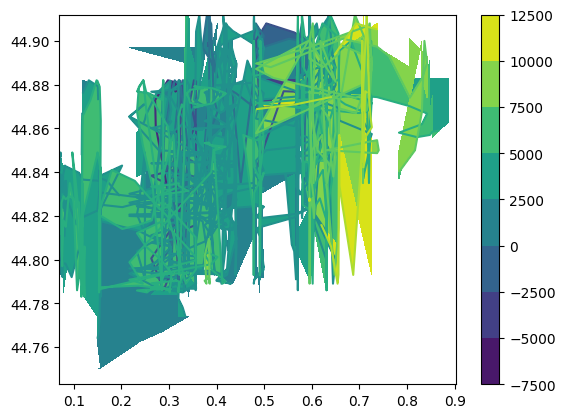

In [33]:
from scipy.interpolate import interp2d
x = df_kernel.LONGITUDE
y = df_kernel.LATITUDE
z = df_kernel.DENSITY
xx, yy = np.meshgrid(x,y)
#z_f = interp2d(x,y,z,'cubic')
# zz = z_f (Xi, yy)
grid_x, grid_y = np.mgrid[x.min():x.max():117j, y.min():y.max():117j]
points = df_kernel[['LONGITUDE','LATITUDE']]
grid_z2 = griddata(points, values, (grid_x, grid_y), method='cubic')

fig, ax1= plt.subplots()
ax1.contour(x, y, grid_z2)
cntr1 = ax1.contourf(x, y, grid_z2)
fig.colorbar(cntr1, ax=ax1)

In [120]:
z_f(x,y)

C:\Users\t480\AppData\Local\Temp\ipykernel_5144\471175506.py:1: DeprecationWarning:         `interp2d` is deprecated!
        `interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

        For legacy code, nearly bug-for-bug compatible replacements are
        `RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
        scattered 2D data.

        In new code, for regular grids use `RegularGridInterpolator` instead.
        For scattered data, prefer `LinearNDInterpolator` or
        `CloughTocher2DInterpolator`.

        For more details see
        `https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  z_f(x,y)


array([[ 5.17819249e+03,  4.65447280e+03,  4.65447280e+03, ...,
         7.97525503e+08,  2.78945751e+07,  0.00000000e+00],
       [ 3.63016384e+03,  3.29706912e+03,  3.29706912e+03, ...,
         5.12197045e+08,  1.77080600e+07, -1.52595518e+03],
       [ 2.05046828e+03,  1.95509452e+03,  1.95509452e+03, ...,
         1.93313350e+08,  6.10367505e+06, -3.05146547e+04],
       ...,
       [ 0.00000000e+00, -2.15956284e+02, -2.15956284e+02, ...,
        -7.99296345e+04, -1.41806793e+05, -1.78943502e+05],
       [ 0.00000000e+00, -6.26203241e+00, -6.26203241e+00, ...,
        -2.45243541e+05, -4.69486662e+05, -6.07034232e+05],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
        -3.91123724e+05, -7.65543655e+05, -9.96309750e+05]])

Text(0.5, 1.0, 'grid and contour (200 points, 40000 grid points)')

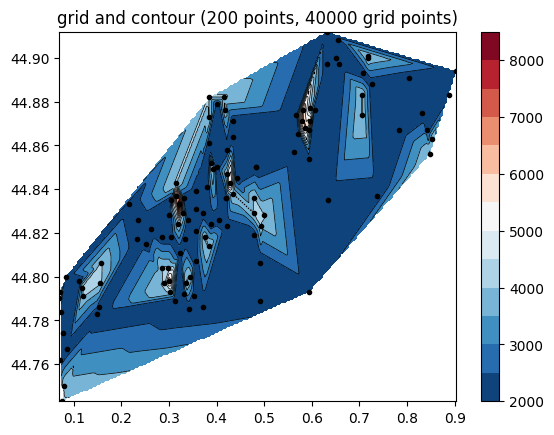

In [115]:
import matplotlib.tri as tri

fig, ax1= plt.subplots()

npts = 200
x = df_kernel.LONGITUDE
y = df_kernel.LATITUDE
z = df_kernel.DENSITY
ngridx = 200
ngridy = 200
xi = np.linspace(x.min(), x.max(), ngridx)
yi = np.linspace(y.min(), y.max(), ngridy)

# Linearly interpolate the data (x, y) on a grid defined by (xi, yi).
triang = tri.Triangulation(x, y)
interpolator = tri.LinearTriInterpolator(triang, z)
Xi, Yi = np.meshgrid(xi, yi)
zi = interpolator(Xi, Yi)

ax1.contour(xi, yi, zi, levels=14, linewidths=0.5, colors='k')
cntr1 = ax1.contourf(xi, yi, zi, levels=14, cmap="RdBu_r")

fig.colorbar(cntr1, ax=ax1)
ax1.plot(x, y, 'ko', ms=3)
ax1.set(xlim=(x.min(), x.max()), ylim=(y.min(), y.max()))
ax1.set_title('grid and contour (%d points, %d grid points)' %
              (npts, ngridx * ngridy))



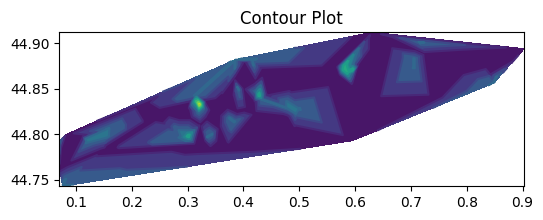

In [79]:
fig, ax = plt.subplots(figsize=(6,2)) #x ranges between 3 to 57, y -1 to -10
ax.tricontour(df_kernel.LONGITUDE, df_kernel.LATITUDE, df_kernel.DENSITY) 
ax.tricontourf(df_kernel.LONGITUDE, df_kernel.LATITUDE, df_kernel.DENSITY) 
ax.set_title('Contour Plot')
ax.color_v
plt.show()

In [39]:
Z= np.meshgrid(df_kernel.DENSITY)
Z

[array([ 519595.81355045,  519595.81355045,  654690.72507372,
         654690.72507372,  519595.81355045,  519595.81355045,
         519595.81355045,  519595.81355045,  519595.81355045,
         519595.81355045, 1033995.66896535,  618319.018125  ,
         618319.018125  ,  519595.81355045, 1033995.66896535,
         519595.81355045,  519595.81355045,  519595.81355045,
         950860.33879712, 1283401.6594694 ,  519595.81355045,
         852137.13422273,  519595.81355045,  519595.81355045,
         909292.67371365, 1174286.53862425,  992428.00388197,
         519595.81355045,  519595.81355045,  519595.81355045,
         519595.81355045,  519595.81355045,  519595.81355045,
         519595.81355045,  519595.81355045,  519595.81355045,
         519595.81355045,  779393.72032554,  779393.72032554,
         519595.81355045,  784589.67846133,  784589.67846133,
         519595.81355045,  519595.81355045,  769001.80405476,
         971644.1713393 ,  519595.81355045,  722238.18083499,
        

TypeError: Input z must be 2D, not 3D

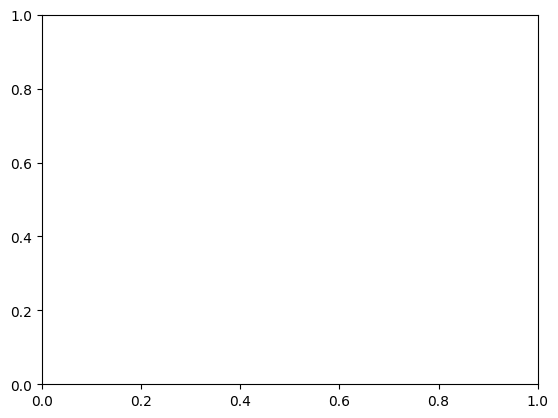

In [37]:

#xlist = np.linspace(df_density.LONGITUDE.min(), df_density.LONGITUDE.max(), 1000)
#ylist = np.linspace(df_density.LATITUDE.min(), df_density.LATITUDE.max(), 1000)
X, Y, Z= np.meshgrid(df_kernel.LONGITUDE, df_kernel.LATITUDE, df_kernel.DENSITY)
Z = df_kernel.DENSITY
fig,ax=plt.subplots(1,1)
cp = ax.contourf(df_kernel.LONGITUDE, df_kernel.LATITUDE, Z)
fig.colorbar(cp) # Add a colorbar to a plot
ax.set_title('Filled Contours Plot')
#ax.set_xlabel('x (cm)')
ax.set_ylabel('y (cm)')
plt.show()

x = df_kernel.LONGITUDE
y = df_kernel.LATITUDE
z = df_kernel.DENSITY
z = z - z.iloc[-1]
x = x.array
y = y.array
z = z.array
axis = plt.subplot(111, title="Storm with {} reports".format(len(x)))
sc = axis.scatter(x, y, c=z, marker=".")
plt.colorbar(sc, label="probability density")
plt.show()

In [ ]:
# plotting KDE of full sample


# plotting KDE of clustered datapoints

# plotting KDE of unclassified datapoints

In [102]:

labelsmallest = df1['LABELS'].value_counts().sort_values(ascending=True).iloc[0:110].index
dfsmallest = df1.loc[df1.LABELS.isin(labelsmallest)]
dfsmallest

,TIME_EVENT,LATITUDE,LONGITUDE,LABELS
0,462946.250000,45.567,5.933,0
1,462945.866667,45.596,5.875,0
40,462925.833333,48.753,0.739,5
41,462925.783333,48.735,0.694,5
42,462925.783333,48.717,0.717,5
...,...,...,...,...
1971,458532.000000,43.281,2.585,181
1972,458531.916667,43.311,2.561,181
1973,458531.916667,43.291,2.565,181
1974,458531.666667,43.270,2.436,181


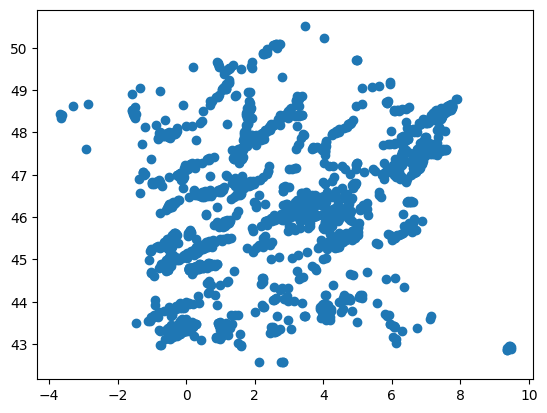

In [19]:
plt.scatter(df1.LONGITUDE, df1.LATITUDE)
plt.show()

<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

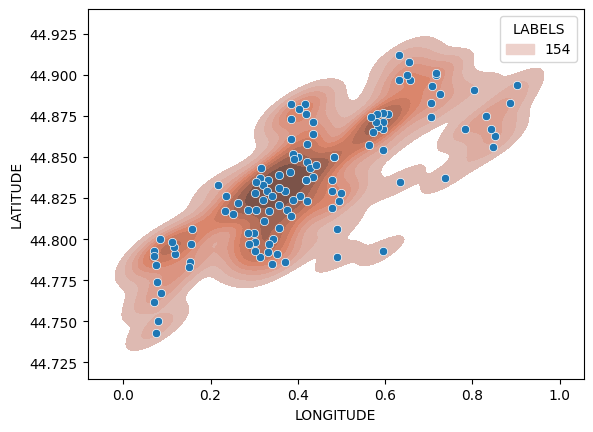

In [15]:
sns.kdeplot(data=df10biggest.loc[df10biggest.LABELS == labelbiggest[0]], x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55)
sns.scatterplot(data=df10biggest.loc[df10biggest.LABELS == labelbiggest[0]], x="LONGITUDE", y="LATITUDE")

<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

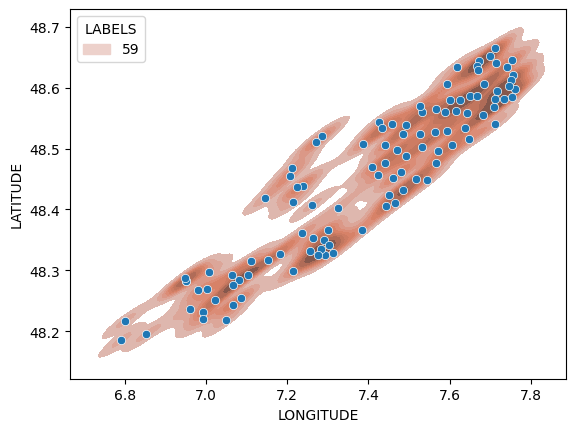

In [19]:
sns.kdeplot(data=df10biggest.loc[df10biggest.LABELS == labelbiggest[1]], x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.35)
sns.scatterplot(data=df10biggest.loc[df10biggest.LABELS == labelbiggest[1]], x="LONGITUDE", y="LATITUDE")

<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

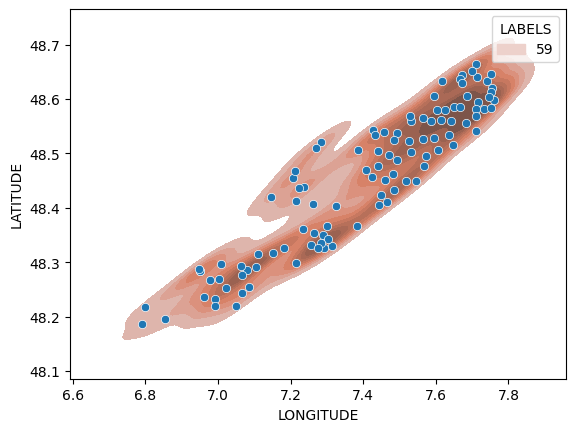

In [83]:
sns.kdeplot(data=df10biggest.loc[df10biggest.LABELS == labelbiggest[1]], x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55)
sns.scatterplot(data=df10biggest.loc[df10biggest.LABELS == labelbiggest[1]], x="LONGITUDE", y="LATITUDE")

<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

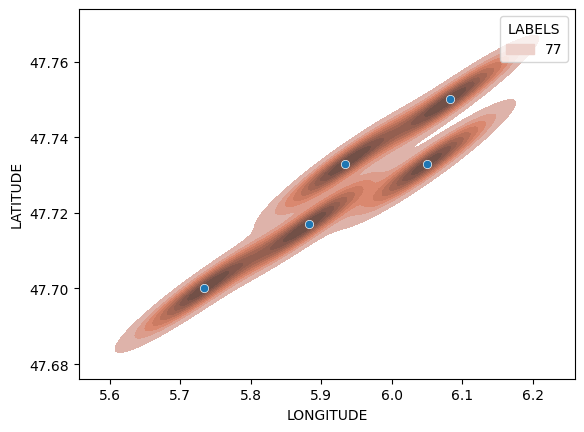

In [104]:
sns.kdeplot(data=dfsmallest.loc[dfsmallest.LABELS == labelsmallest[100]], x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55)
sns.scatterplot(data=dfsmallest.loc[dfsmallest.LABELS == labelsmallest[100]], x="LONGITUDE", y="LATITUDE")

C:\Users\t480\AppData\Local\Temp\ipykernel_21108\3652550476.py:2: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=dfsmallest, x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55, legend=False)
C:\Users\t480\AppData\Local\Temp\ipykernel_21108\3652550476.py:2: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=dfsmallest, x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55, legend=False)
C:\Users\t480\AppData\Local\Temp\ipykernel_21108\3652550476.py:2: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=dfsmallest, x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55, legend=False)
C:\Users\t480\AppData\Local\Temp\ipykernel_21108\3652550476.py:2: UserWarning: KDE

<AxesSubplot: xlabel='LONGITUDE', ylabel='LATITUDE'>

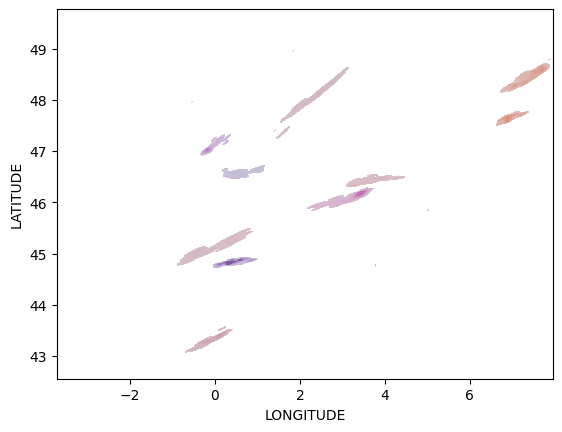

In [105]:
sns.kdeplot(data=df10biggest, x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55, legend=False)
sns.kdeplot(data=dfsmallest, x="LONGITUDE", y="LATITUDE", hue='LABELS', fill=True, bw_adjust=0.55, legend=False)
#sns.scatterplot(data=dffull, x="LONGITUDE", y="LATITUDE")